Bilayer unit domain. Sigma optimisation

In [196]:
# Importing libraries
import matplotlib.pyplot as plt
from matplotlib import ticker
import numpy as np
from mpi4py import MPI
from ufl import (
    inner,
    grad,
    conj,
    TrialFunction,
    TestFunction,
    as_matrix,
    as_vector,
    dot,
    Or,
    Measure,
    conditional,
    SpatialCoordinate,
    dx,
)
from dolfinx.mesh import locate_entities_boundary, create_interval, locate_entities, meshtags
from dolfinx.fem import FunctionSpace, Function, functionspace, Function, dirichletbc, locate_dofs_topological, petsc, form, assemble_matrix, assemble_scalar
import basix
from petsc4py.PETSc import ScalarType
from slepc4py.SLEPc import EPS  

Domain, PML, refinement and physical configurations

In [ ]:
# Define element size for the mesh refinement
h_i = [0.125/4,   # N=2
       0.125/8,   # N=3
       0.125/16,] # N=4

# Domain configuration
Lx = 1. # fluid domain length (without PML)
l_inner=Lx/2

# Physical configuration
rho_media_1 = 1. # kg/m^3 
vel_media_1 = 2.   # m/s
rho_media_2 = 1. # kg/m^3 
vel_media_2 = 1.   # m/s


# Define the density and velocity functions  
def rho_function(x):    
    return np.where(x[0] > l_inner, rho_media_2,rho_media_1)

def vel_function(x):    
    return np.where(x[0] > l_inner, vel_media_2,vel_media_1)

# PML configuration
pml_thickness = Lx/4

# Solver configuration
requested_eigenvalues_number = 90 # Number of eigenvalues to compute


degree=[2,1]  # Polynomial degree for pressure and velocity
sigma_sweep_quadratic=np.linspace(0.5, 10., 40)
target=-12.5j


Solver configuration and computing

In [ ]:
def get_configured_problem(mesh, degrees, sigma_x):
    # Initialize dictionaries
    dof = {}
    solver_dict={}
    V_dict={}
    Q_dict={}

    # Define finite element spaces
    p_fe_type = basix.ufl.element(family="Lagrange", cell=mesh.basix_cell(), degree=degrees[0])
    v_fe_type = basix.ufl.element(family="DG", cell=mesh.basix_cell(), degree=degrees[1], shape=(mesh.geometry.dim,))
    FE = {"p": p_fe_type, "v": v_fe_type}

    # Create a submesh of PML associated cells
    tdim = mesh.topology.dim

    # Identify the fluid cells
    # fluid_cells = locate_entities(mesh, tdim, lambda x: x[0] <= Lx)

    # Create function spaces for mesh and submesh
    Q = functionspace(mesh,FE["p"])
    V = functionspace(mesh, FE["v"])

    # Dictionaries to store the number of dofs
    dof["p"] = Q.dofmap.index_map.size_global
    dof["v"] = V.dofmap.index_map.size_global

    # Boundary conditions application (for pressure)
    bc = []
    facets = locate_entities_boundary(mesh, 0, lambda x: np.isclose(x[0], 0.0))
    o_boundary_dofs = locate_dofs_topological(Q, 0, facets)  # the dimension is related to mesh entity where dofs are located

    # Setting to zero located dofs related to boundaries
    u_d = Function(Q)
    u_d.x.array[:] = 0.0  # Asign Dirichlet condition value
    bc.append(dirichletbc(u_d, o_boundary_dofs)) 
    
    facets = locate_entities_boundary(mesh, 0, lambda x: np.isclose(x[0], Lx+pml_thickness))
    o_boundary_dofs = locate_dofs_topological(Q, 0, facets)  # the dimension is related to mesh entity where dofs are located

    # Setting to zero located dofs related to boundaries
    u_d = Function(Q)
    u_d.x.array[:] = 0.0  # Asign Dirichlet condition value
    bc.append(dirichletbc(u_d, o_boundary_dofs)) 

    # Define differential operators
    dx = Measure("dx", domain=mesh)

    # Interpolates the density and velocity functions
    W = functionspace(mesh, ("DG", 2))
    rho = Function(W)
    rho.interpolate(rho_function)
    c = Function(W)
    c.interpolate(vel_function)

    # Spatial Coordinate is updated for the actual mesh
    x = SpatialCoordinate(mesh)

    # Variation formulation definition
    p = TrialFunction(Q) 
    v = TrialFunction(V)
    q = TestFunction(Q)
    w = TestFunction(V)

    # Define the variational forms
    a = form(
        [
            [sigma_x(x) / (rho * c**2) * p * conj(q) * dx, -1 * inner(v, grad(q)) * dx],
            [inner(grad(p), w) * dx, sigma_x(x) * rho * inner(v, w) * dx],
        ]
    )
    b = form(
        [
            [1.0 / (rho * c**2) * p * conj(q) * dx, None],
            [None, rho * inner(v, w) * dx],
        ]  
    )
    # Assemble matrices
    A = petsc.assemble_matrix_block(a, bcs=bc)
    A.assemble()
    B = petsc.assemble_matrix_block(b, bcs=bc)
    B.assemble()

    # SLEPc solver configuration for linear eigenvalue problem (A x =\lambda x B)
    solver = EPS().create()
    solver.setOperators(-A, B)
    solver.setType("arnoldi")
    solver.setWhichEigenpairs(9)  # TARGET_IMAGINARY = 9, TARGET_MAGNITUDE = 7, TARGET_REAL = 8
    solver.setDimensions(
        requested_eigenvalues_number,
        4 * requested_eigenvalues_number,
        4 * requested_eigenvalues_number,
    )
    solver.setTolerances(1e-16, 100)
    st = solver.getST()
    st.setType("sinvert")  # Applying spectral transformation "shift and invert" 
    solver.setTarget(target)  
    solver.solve()
    n_eigs_converged_quadratic = solver.getConverged()

    return solver, mesh, Q, V, dof

In [199]:
def assign_eigenvector_to_functions(vrA, p_h, v_h, dof, normalize_at):
    """
    Reparte o vector eigenvector 'vrA' entre p_h e v_h
    e normaliza no punto 'normalize_at'.
    """

    # --- separar as partes do autovector ---
    p_vals = vrA[:dof["p"]]
    v_vals = vrA[dof["p"]:]

    # asignar
    p_h.x.array[:] = p_vals
    v_h.x.array[:] = v_vals

    # --- normalización opcional ---
    if normalize_at is not None:
        p_norm = p_h.eval(normalize_at, 1)
        v_norm = v_h.eval(normalize_at, 1)
        if abs(p_norm) == 0:
            raise RuntimeError("Non se pode normalizar: valor 0 no punto dado de p.")
        if abs(v_norm) == 0:
            raise RuntimeError("Non se pode normalizar: valor 0 no punto dado de v.")

        p_h.x.array[:] /= p_norm
        v_h.x.array[:] /= v_norm
    return p_h, v_h

In [200]:
def get_exact_eigenpair(solver, selected_index, Q, V, x_hat, sigma_x, gamma_x, normalize_at):
    exact_physical_eigs_function= lambda n: vel_media_1 / l_inner * np.arctan(-1j * (vel_media_2 * rho_media_2) / (vel_media_1 * rho_media_1))+ n * np.pi * vel_media_1 / l_inner
    w=exact_physical_eigs_function(selected_index)

    p_1 = lambda x: np.sin(w * x[0] / vel_media_1)
    p_2 = lambda x: -np.sin(-w * l_inner / vel_media_1) * np.exp(1j * w / vel_media_2 * (x_hat(x,w) - l_inner))
    p = lambda x: np.where(x[0] > l_inner, p_2(x), p_1(x))

    sigma_x_function_cond= lambda x: np.where(x[0]<Lx, x[0]*0., sigma_x(x))

    v_1=lambda x: 1/(-1j*w)*(w / vel_media_1) * np.cos(w * x[0] / vel_media_1)
    v_2 = (lambda x: 1/(-1j*w+sigma_x_function_cond(x)*rho_media_1)* -np.sin(-w * l_inner / vel_media_1) *(1j * w / vel_media_2)
        * np.exp(1j * w / vel_media_2 * (x_hat(x,w) - l_inner))* gamma_x(x, w)[0])
    v = lambda x: np.where(x[0] > l_inner, v_2(x), v_1(x))

    p_ex = Function(Q, name="p_ex")
    p_ex.interpolate(p)

    v_ex = Function(V, name="v_ex")
    v_ex.interpolate(v)

    # --- normalización opcional ---
    if normalize_at is not None:
        p_norm = p_ex.eval(normalize_at, 1)
        v_norm = v_ex.eval(normalize_at, 1)
        if abs(p_norm) == 0:
            raise RuntimeError("Non se pode normalizar: valor 0 no punto dado de p.")
        if abs(v_norm) == 0:
            raise RuntimeError("Non se pode normalizar: valor 0 no punto dado de v.")
        p_ex.x.petsc_vec.array[:] /= p_norm
        v_ex.x.petsc_vec.array[:] /= v_norm

    return [w, p_ex, v_ex]

In [201]:
def get_function_plot_data(u):
    """
    Devolve (x_sorted, values_sorted) listos para plt.plot.

    Funciona en mallas 1D en dolfinx 0.9.
    Usa coordenadas dos DOFs do espazo de u.
    """

    V = u.function_space
    mesh = V.mesh

    # Coordenadas dos DOFs
    X = V.tabulate_dof_coordinates().copy()

    # COLAPSAR dimensións sobrantes: quedamos coa coordenada x
    if X.shape[1] > 1:
        X = X[:, 0]

    # Obter valores da función
    try:
        vals = u.x.array.copy()
    except AttributeError:
        vals = u.vector.getArray().copy()

    # Ordenar por coordenada x
    idx = np.argsort(X)
    return X[idx], vals[idx]


In [202]:
def project_exact_to_mesh(u_exact, Vh):
    """
    Proxecta/interpola unha expresión exacta (UFL) ou un Function
    doutra malla ao espazo funcional Vh (malla actual).

    Funciona en dolfinx 0.9 e evita todos os problemas de dimensión
    e de Expression nos MixedElements.
    """

    # Se u_exact xa é un Function no mesmo espazo, devolver directamente
    if isinstance(u_exact, Function) and u_exact.function_space == Vh:
        return u_exact

    # Crear Function sobre Vh
    u_proj = Function(Vh)

    # Caso 1: exacta é Function doutra malla -> interpolar
    if isinstance(u_exact, Function):
        u_proj.interpolate(u_exact)
        return u_proj

    # Caso 2: exacta é UFL Expression -> interpolar mediante Expression
    # Obter puntos de interpolación (DOF coordinates)
    X = Vh.tabulate_dof_coordinates()

    # Se é 1D pero X ven con máis dimensións, quedar coa primeira columna
    if X.ndim == 2 and X.shape[1] > 1:
        X = X[:, :1]

    expr = Expression(u_exact, X, dtype=u_proj.x.array.dtype)
    u_proj.interpolate(expr)

    return u_proj


In [203]:
def eigenvector_L2_error_physical(u_num, u_exact, Lx, mesh):
    """
    Erro relativo L2 só no dominio físico [0, Lx] en DOLFINx 0.9.
    Alinea fase/signo antes de medir o erro.
    """

    import numpy as np
    import ufl
    from ufl import inner
    from dolfinx.mesh import locate_entities, meshtags
    from dolfinx.fem import form, assemble_scalar

    tdim = mesh.topology.dim

    # --- 1) Localizar celas físicas ---
    cells_phys = locate_entities(
        mesh, tdim,
        lambda x: np.logical_and(x[0] >= 0, x[0] < Lx)
    )

    if len(cells_phys) == 0:
        raise RuntimeError("Non se detectaron celas na rexión física [0, Lx].")

    # Asignar etiqueta 1
    values = np.full(len(cells_phys), 1, dtype=np.int32)
    mt = meshtags(mesh, tdim, cells_phys, values)

    # Medida restrinxida
    dx_phys = ufl.Measure("dx", domain=mesh, subdomain_data=mt)

    # --- 2) Alinear fase só na zona física ---
    inner_num_exact = assemble_scalar(form(inner(u_num, u_exact) * dx_phys(1)))
    inner_exact_exact = assemble_scalar(form(inner(u_exact, u_exact) * dx_phys(1)))

    c = inner_num_exact / inner_exact_exact

    u_aligned = u_num.copy()
    u_aligned.x.array[:] = u_num.x.array[:] / c

    # --- 3) Norma L2 do erro no dominio físico ---
    diff = u_aligned - u_exact

    num = np.sqrt(assemble_scalar(form(inner(diff, diff) * dx_phys(1))))
    den = np.sqrt(assemble_scalar(form(inner(u_exact, u_exact) * dx_phys(1))))

    return num / den


In [ ]:
def get_closest_approx_eigenpair(solver, Q, V, dof, sigma_i, mesh, verbose=False, plot=False):
    """
    Devuelve el autovalor y autovector más cercano a omega_target
    usando distancia compleja |λ - λ_target|, sin usar get_approx_eigenpair.

    Returns
    -------
    lambda_best : complex
    x_best : PETSc.Vec (copia del autovector)
    idx_best : int (índice raw en solver)
    p_h:    Function
    v_h: Function
    """
    exact_eigenvalues = [None] * 5 # Almacena los autovalores exactos
    p_exact = [None] * 5  # Almacena los autovectores exactos de presión
    v_exact = [None] * 5  # Almacena los autovectores exactos de velocidad
    p_approx = [None] * 5  # Almacena los autovectores exactos de presión
    v_approx = [None] * 5  # Almacena los autovectores exactos de velocidad
    best_0 = None
    best_3 = None

    # Vector temporal para extraer Eigenpairs
    p_h = Function(Q, name="p_h")
    v_h = Function(V, name="v_h")

    # Número de modos convergidos
    nconv = solver.getConverged()
    if nconv == 0:
        raise RuntimeError("No hay autovalores convergidos")

    # Vector temporal para extraer Eigenpairs
    vrA, vi = solver.getOperators()[0].getVecs()

    x_hat_quadratic=lambda x, w: (x[0]+ (np.abs(x[0]) >= Lx)* np.sign(x[0])* 1j/ w* sigma_i* (np.abs(x[0]) - Lx) ** 3/ (3 * pml_thickness**2))
    sigma_quadratic_py=lambda x: (np.abs(x[0]) >= Lx) * sigma_i * (np.abs(x[0]) - Lx) ** 2 / (pml_thickness ** 2)
    gamma_x_quadratic = lambda x, w: 1.0 + (np.abs(x[0]) >= Lx) * 1j / w * sigma_i * (np.abs(x[0]) - Lx) ** 2 / (pml_thickness ** 2)

    [exact_eigenvalues[0], p_exact[0], v_exact[0]] =   get_exact_eigenpair(solver, 1, Q, V, x_hat_quadratic, sigma_quadratic_py, gamma_x_quadratic, [Lx, 0, 0])
    [exact_eigenvalues[3], p_exact[3], v_exact[3]] =   get_exact_eigenpair(solver, 4, Q, V, x_hat_quadratic, sigma_quadratic_py, gamma_x_quadratic, [Lx, 0, 0])

    for k in range(nconv):
        approx_eigenvalue = solver.getEigenvalue(k) * 1j 
        solver.getEigenpair(k, vrA)  
        # Vector temporal para extraer Eigenpairs
        p_h = Function(Q, name="p_h")
        v_h = Function(V, name="v_h")
        [p_h, v_h]=assign_eigenvector_to_functions(vrA = vrA, p_h = p_h, v_h = v_h, dof = dof, normalize_at = [Lx, 0, 0])

        # --- autovalores ---
        err_eig_0 = abs(approx_eigenvalue - exact_eigenvalues[0]) / abs(exact_eigenvalues[0])
        err_eig_3 = abs(approx_eigenvalue - exact_eigenvalues[3]) / abs(exact_eigenvalues[3])

        # --- autovectores ---
        err_p_0 = eigenvector_L2_error_physical(p_h, p_exact[0], Lx, mesh)
        err_v_0 = eigenvector_L2_error_physical(v_h, v_exact[0], Lx, mesh)

        err_p_3 = eigenvector_L2_error_physical(p_h, p_exact[3], Lx, mesh)
        err_v_3 = eigenvector_L2_error_physical(v_h, v_exact[3], Lx, mesh)

        # Total
        err_0 = err_eig_0 + err_p_0 + err_v_0
        err_3 = err_eig_3 + err_p_3 + err_v_3

        if best_0 is None or err_0 < best_0[2]:
            best_0 = (approx_eigenvalue, k, err_0)

        if best_3 is None or err_3 < best_3[2]:
            best_3 = (approx_eigenvalue, k, err_3)

    closest_eig_0, idx_best_0, rel_err_best_0 = best_0
    closest_eig_3, idx_best_3, rel_err_best_3 = best_3

    # Vector temporal para extraer Eigenpairs
    p_h = Function(Q, name="p_h")
    v_h = Function(V, name="v_h")
    vrA_0, vi_0 = solver.getOperators()[0].getVecs()
    solver.getEigenpair(idx_best_0, vrA_0)
    [p_approx[0], v_approx[0]]=assign_eigenvector_to_functions(vrA = vrA_0, p_h = p_h, v_h = v_h, dof = dof, normalize_at = [Lx, 0, 0])
    p_h = Function(Q, name="p_h")
    v_h = Function(V, name="v_h")
    vrA_3, vi_3 = solver.getOperators()[0].getVecs()
    solver.getEigenpair(idx_best_3, vrA_3)
    [p_approx[3], v_approx[3]]=assign_eigenvector_to_functions(vrA = vrA_3, p_h = p_h, v_h = v_h, dof = dof, normalize_at = [Lx, 0, 0])


    if verbose:
        print(f"$[Closest] idx={idx_best_0}  \omega={closest_eig_0}  \epsilon_r={rel_err_best_0}$")
        print(f"$[Closest] idx={idx_best_3}  \omega={closest_eig_3}  \epsilon_r={rel_err_best_3}$")


    if plot:
        
        fig, axes = plt.subplots(2, 2, figsize=(12,8))

        # ============================================================
        #  FILA 1 — AUTOVECTORES p
        # ============================================================

        # --- p, modo 0 ---
        ax = axes[0, 0]

        u_ex_proj_0 = project_exact_to_mesh(p_exact[0], p_approx[0].function_space)
        x_num_0, y_num_0 = get_function_plot_data(p_approx[0])
        x_ex_0,  y_ex_0  = get_function_plot_data(u_ex_proj_0)

        mask_0 = x_ex_0 <= 1

        ax.plot(x_ex_0[mask_0], np.real(y_ex_0[mask_0]), label="exact", linestyle="solid")
        ax.plot(x_num_0[mask_0], np.real(y_num_0[mask_0]), label="quadratic", linestyle="-.")
        ax.set_xlabel("x")
        ax.set_ylabel("$p(x)$")
        ax.set_title("Eigenvector p — mode 0")
        ax.grid(True)
        ax.legend()

        # --- p, modo 3 ---
        ax = axes[0, 1]

        u_ex_proj_3 = project_exact_to_mesh(p_exact[3], p_approx[3].function_space)
        x_num_3, y_num_3 = get_function_plot_data(p_approx[3])
        x_ex_3,  y_ex_3  = get_function_plot_data(u_ex_proj_3)

        mask_3 = x_ex_3 <= 1

        ax.plot(x_ex_3[mask_3], np.real(y_ex_3[mask_3]), label="exact", linestyle="solid")
        ax.plot(x_num_3[mask_3], np.real(y_num_3[mask_3]), label="quadratic", linestyle="-.")
        ax.set_xlabel("x")
        ax.set_ylabel("$p(x)$")
        ax.set_title("Eigenvector p — mode 3")
        ax.grid(True)
        ax.legend()

        # ============================================================
        #  FILA 2 — AUTOVECTORES v
        # ============================================================

        # --- v, modo 0 ---
        ax = axes[1, 0]

        v_ex_proj_0 = project_exact_to_mesh(v_exact[0], v_approx[0].function_space)
        x_num_v0, y_num_v0 = get_function_plot_data(v_approx[0])
        x_ex_v0,  y_ex_v0  = get_function_plot_data(v_ex_proj_0)

        mask_v0 = x_ex_v0 <= 1

        ax.plot(x_ex_v0[mask_v0], np.real(y_ex_v0[mask_v0]), label="exact", linestyle="solid")
        ax.plot(x_num_v0[mask_v0], np.real(y_num_v0[mask_v0]), label="quadratic", linestyle="-.")
        ax.set_xlabel("x")
        ax.set_ylabel("$v(x)$")
        ax.set_title("Eigenvector v — mode 0")
        ax.grid(True)
        ax.legend()

        # --- v, modo 3 ---
        ax = axes[1, 1]

        v_ex_proj_3 = project_exact_to_mesh(v_exact[3], v_approx[3].function_space)
        x_num_v3, y_num_v3 = get_function_plot_data(v_approx[3])
        x_ex_v3,  y_ex_v3  = get_function_plot_data(v_ex_proj_3)

        mask_v3 = x_ex_v3 <= 1

        ax.plot(x_ex_v3[mask_v3], np.real(y_ex_v3[mask_v3]), label="exact", linestyle="solid")
        ax.plot(x_num_v3[mask_v3], np.real(y_num_v3[mask_v3]), label="quadratic", linestyle="-.")
        ax.set_xlabel("x")
        ax.set_ylabel("$v(x)$")
        ax.set_title("Eigenvector v — mode 3")
        ax.grid(True)
        ax.legend()

        plt.tight_layout()
        plt.show()


    return closest_eig_0, p_approx[0], v_approx[0], rel_err_best_0, closest_eig_3, p_approx[3], v_approx[3], rel_err_best_3



=== Executando para N = 2, h = 0.03125 ===
$[Closest] idx=0  \omega=(12.515846662608215-1.9894781320644856j)  \epsilon_r=(0.13606936686729681+0j)$
$[Closest] idx=25  \omega=(49.33948619085711-1.9125004742117502j)  \epsilon_r=(0.6936991414744422+0j)$


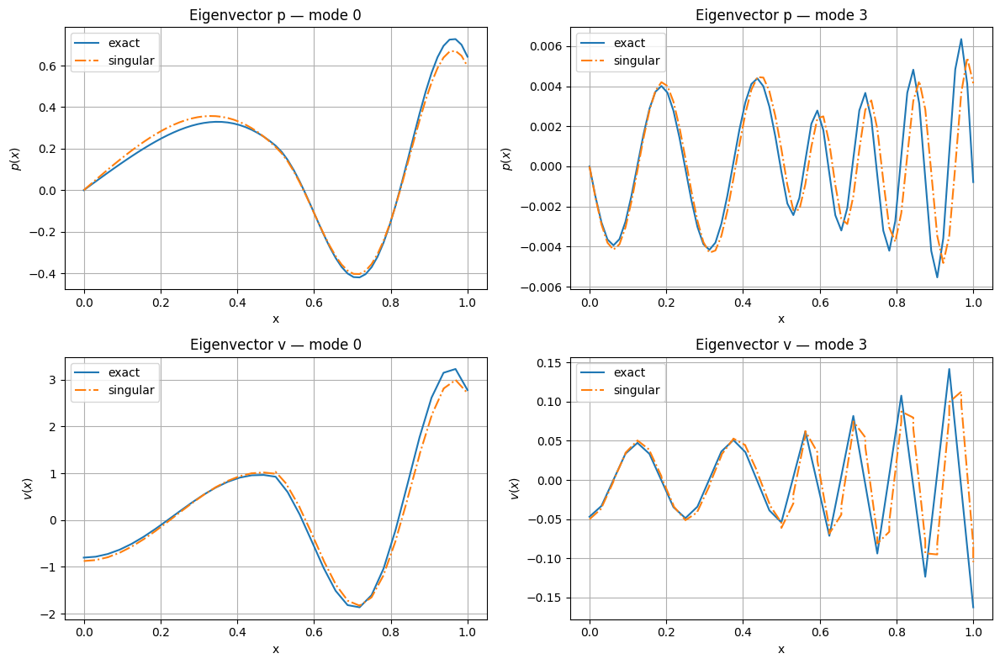

$[Closest] idx=0  \omega=(12.459739576998112-2.1492463993425015j)  \epsilon_r=(0.08622905736560892+0j)$
$[Closest] idx=25  \omega=(49.36627178340652-1.9079149454250954j)  \epsilon_r=(0.6787913647171752+0j)$


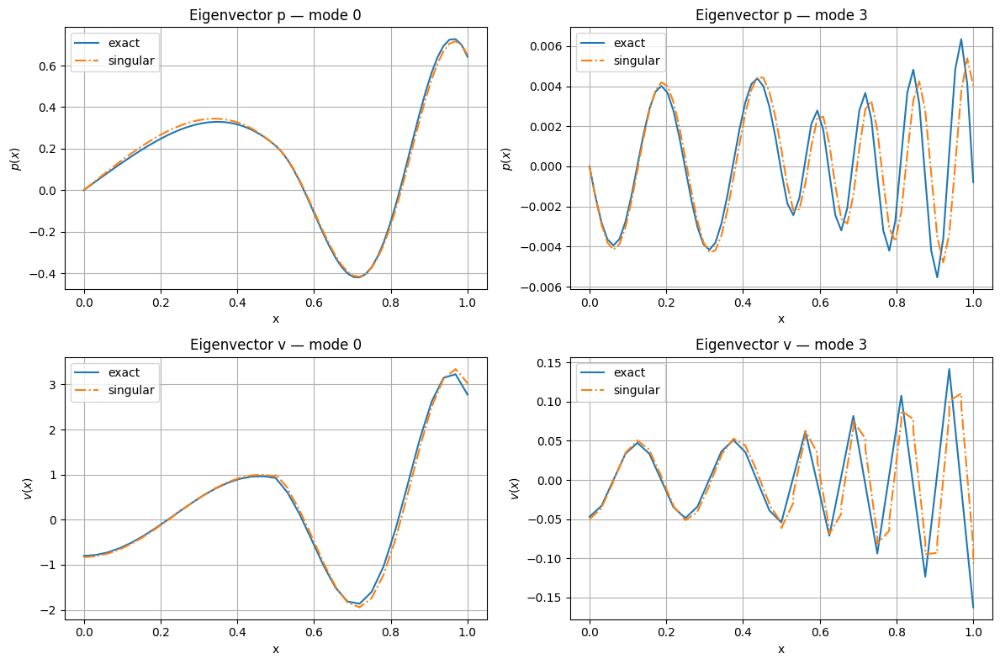

$[Closest] idx=0  \omega=(12.445511411706175-2.13729969829002j)  \epsilon_r=(0.09650367304296356+0j)$
$[Closest] idx=26  \omega=(49.4194445664572-1.9076010505081273j)  \epsilon_r=(0.6478884901676503+0j)$


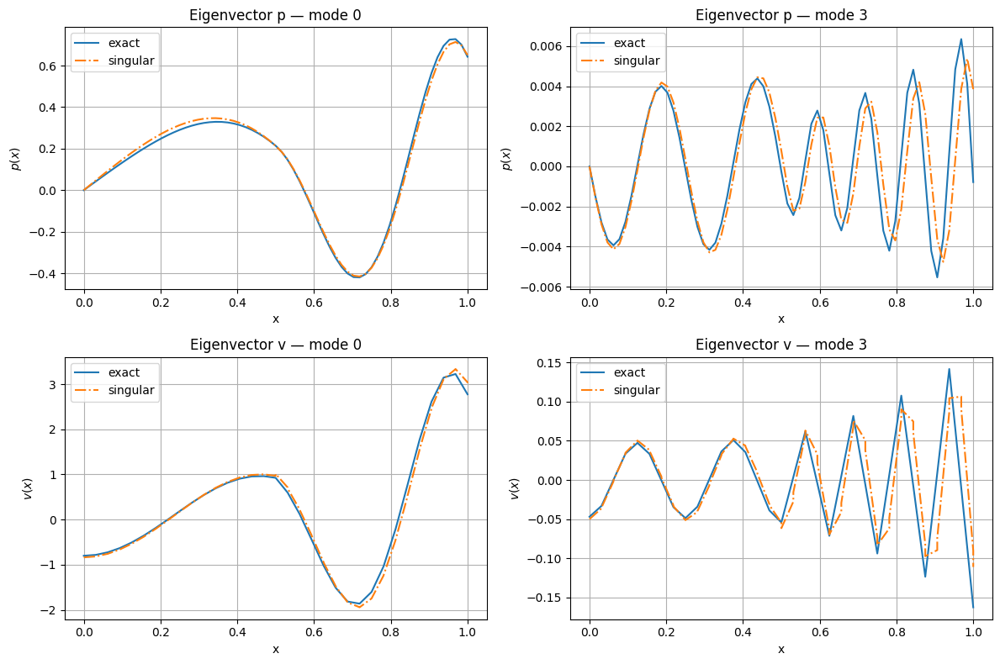

$[Closest] idx=0  \omega=(12.44182865887969-2.136608118435197j)  \epsilon_r=(0.09866188726394065+0j)$
$[Closest] idx=27  \omega=(49.43079456175765-1.8923190689637475j)  \epsilon_r=(0.6442155759438231+0j)$


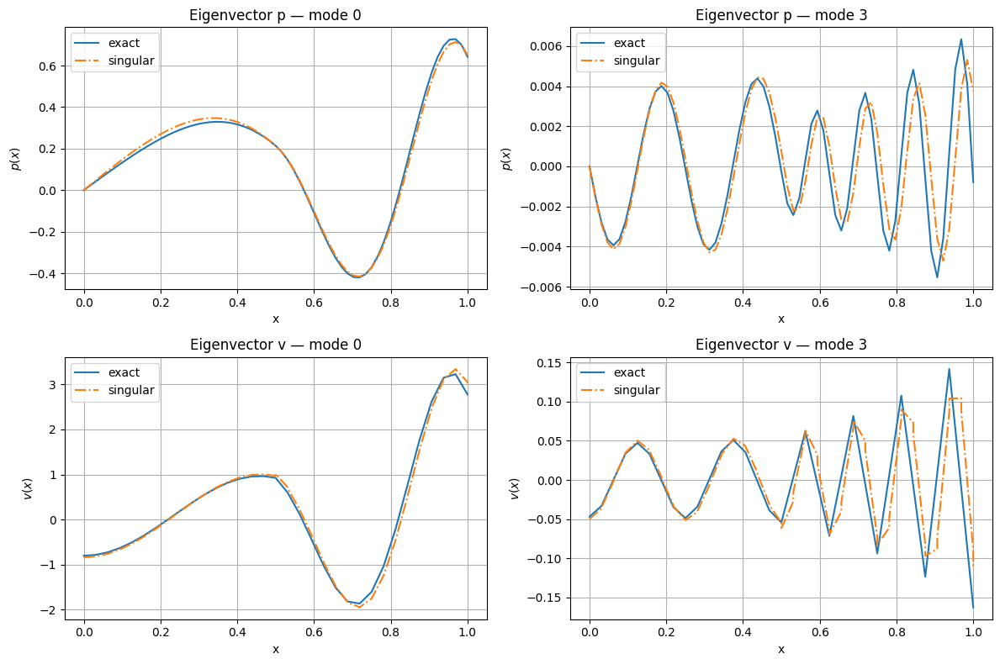

$[Closest] idx=0  \omega=(12.441463877986852-2.1376204231475953j)  \epsilon_r=(0.0986373666826493+0j)$
$[Closest] idx=27  \omega=(49.430365250975434-1.8816421909036725j)  \epsilon_r=(0.6465537058752833+0j)$


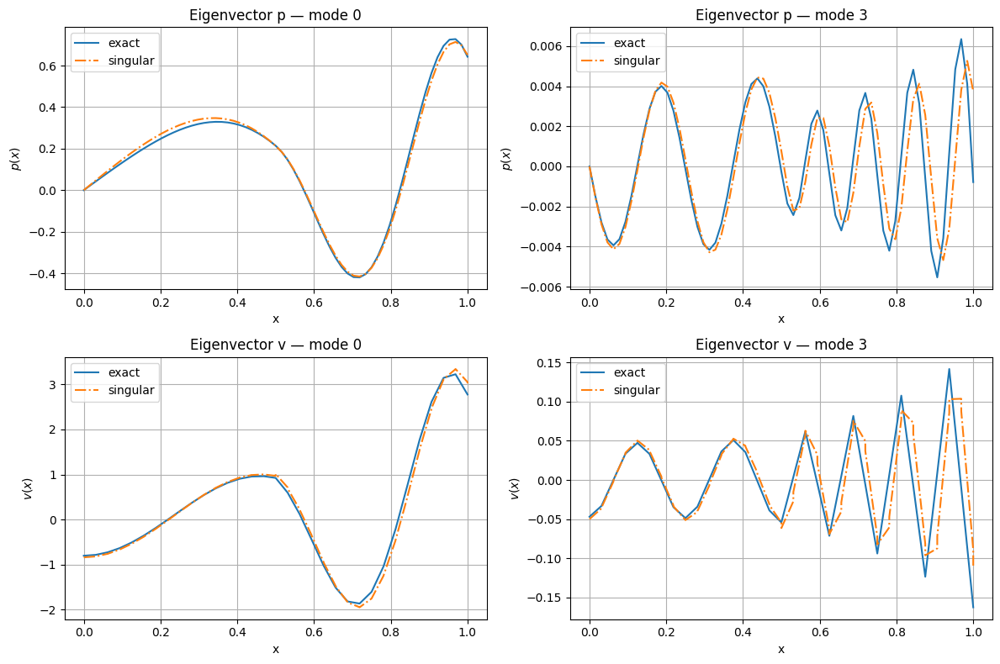

$[Closest] idx=0  \omega=(12.44181250914308-2.1379586898570877j)  \epsilon_r=(0.09837292009284529+0j)$
$[Closest] idx=27  \omega=(49.428482988557384-1.8742076150863944j)  \epsilon_r=(0.6491332188776708+0j)$


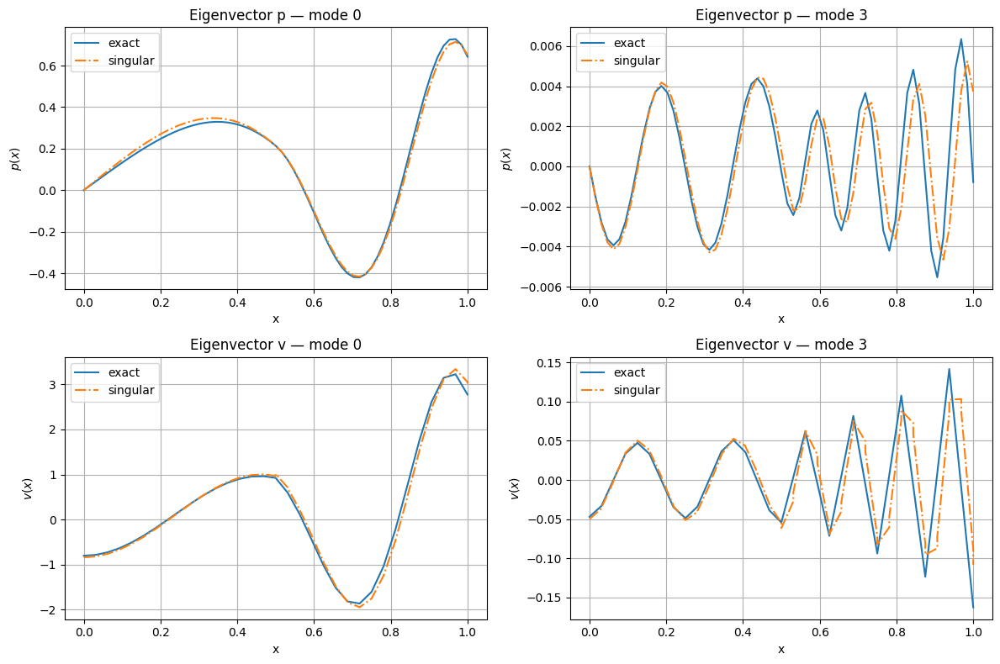

$[Closest] idx=0  \omega=(12.44205922653624-2.1380103476098946j)  \epsilon_r=(0.09822683169898516+0j)$
$[Closest] idx=27  \omega=(49.42673430846291-1.8679371306509895j)  \epsilon_r=(0.6514265242903226+0j)$


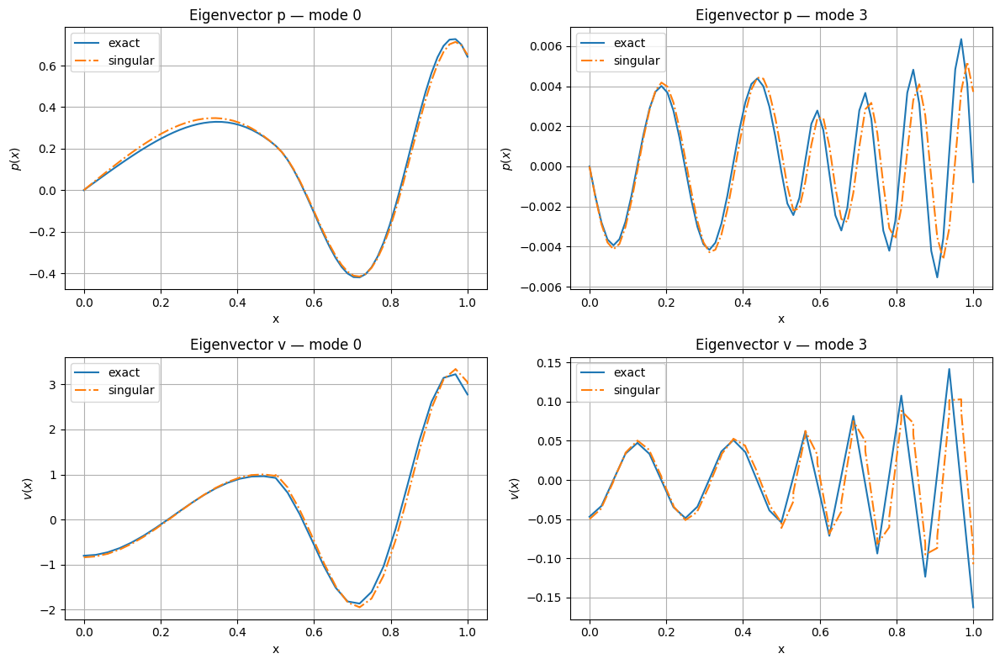

$[Closest] idx=0  \omega=(12.442125602998201-2.1380618022185973j)  \epsilon_r=(0.09817933411958779+0j)$
$[Closest] idx=27  \omega=(49.42497684416554-1.8620014159059488j)  \epsilon_r=(0.65367722592432+0j)$


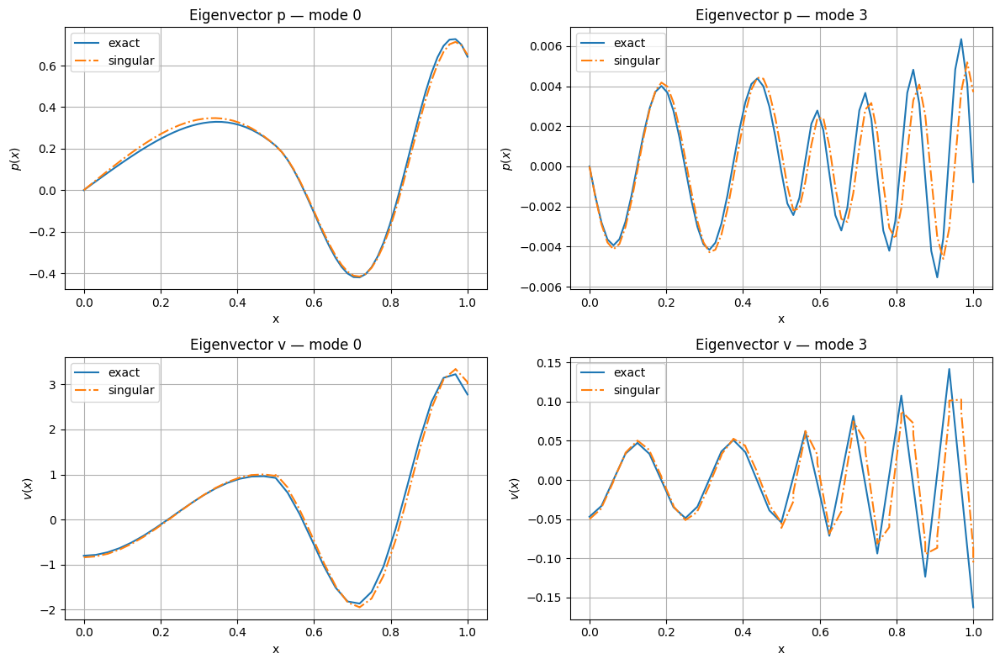

$[Closest] idx=0  \omega=(12.44208859249668-2.13817615778714j)  \epsilon_r=(0.09817462710086809+0j)$
$[Closest] idx=27  \omega=(49.42297785875183-1.856206379131573j)  \epsilon_r=(0.6560577797598348+0j)$


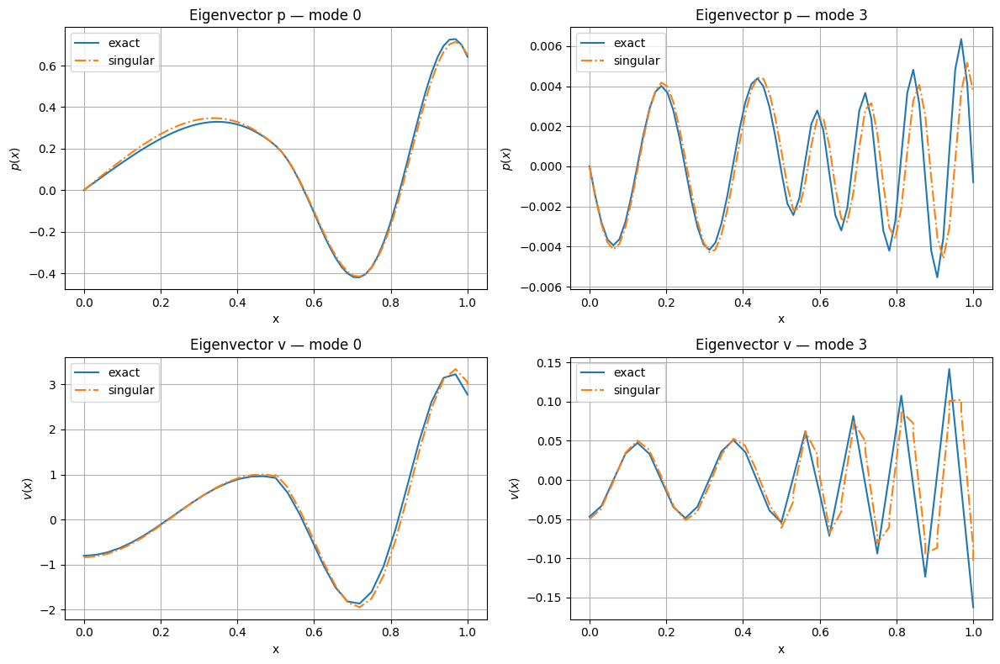

$[Closest] idx=0  \omega=(12.442012906401617-2.13834625853603j)  \epsilon_r=(0.09817900692215731+0j)$
$[Closest] idx=27  \omega=(49.42063234060674-1.8505546944456401j)  \epsilon_r=(0.6586271239318902+0j)$


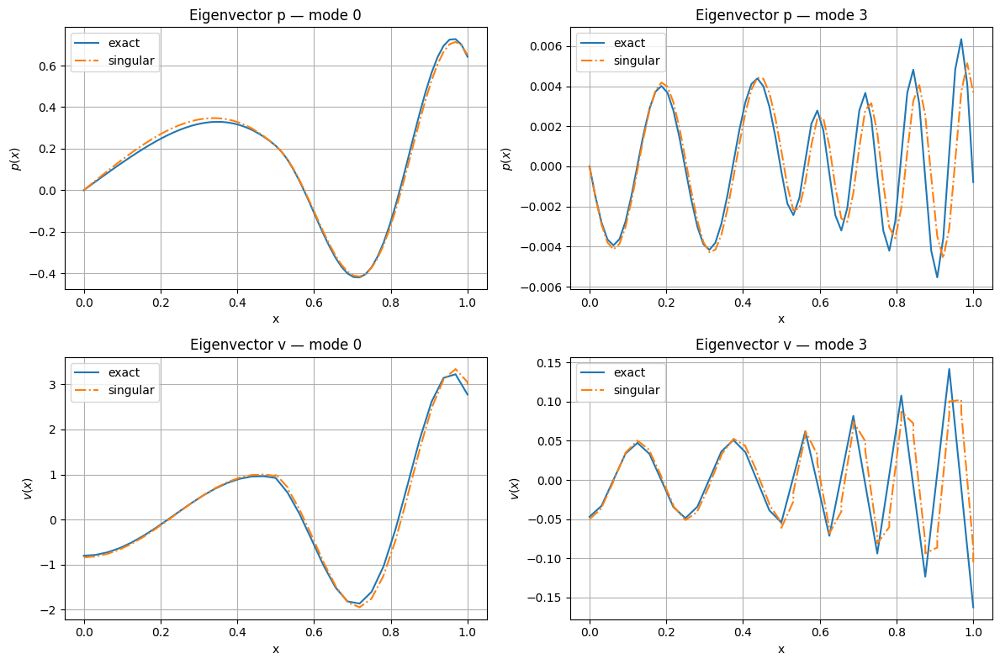

$[Closest] idx=0  \omega=(12.441933896325201-2.1385581212420393j)  \epsilon_r=(0.09817629499186681+0j)$
$[Closest] idx=27  \omega=(49.4179188346221-1.8450821775125419j)  \epsilon_r=(0.6613887707032735+0j)$


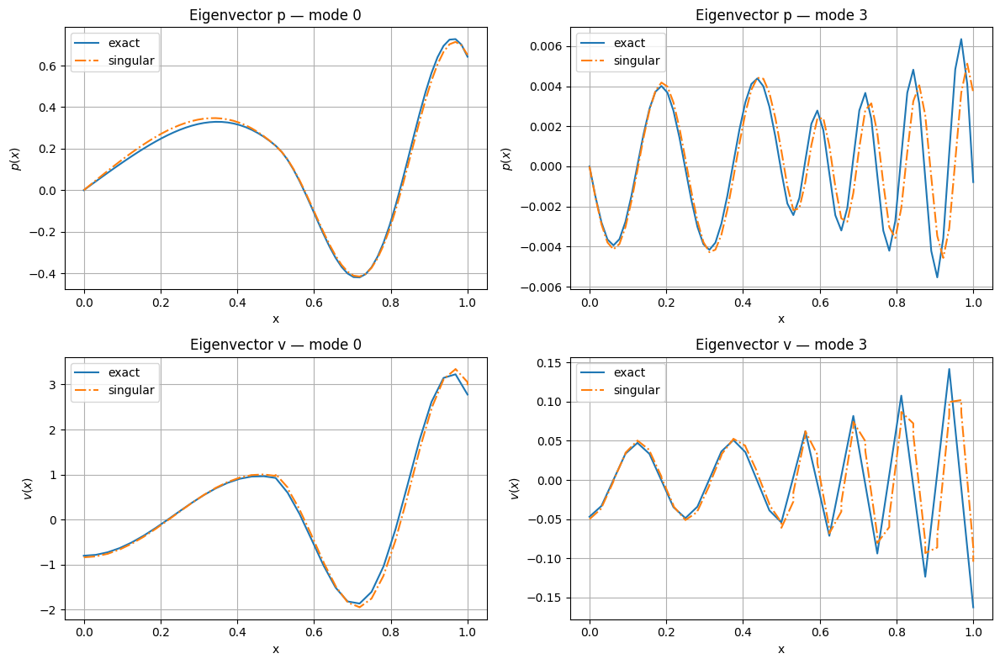

$[Closest] idx=0  \omega=(12.441869310358957-2.138803160207316j)  \epsilon_r=(0.0981587286468365+0j)$
$[Closest] idx=27  \omega=(49.41484949103121-1.8398175395791443j)  \epsilon_r=(0.6643280601869956+0j)$


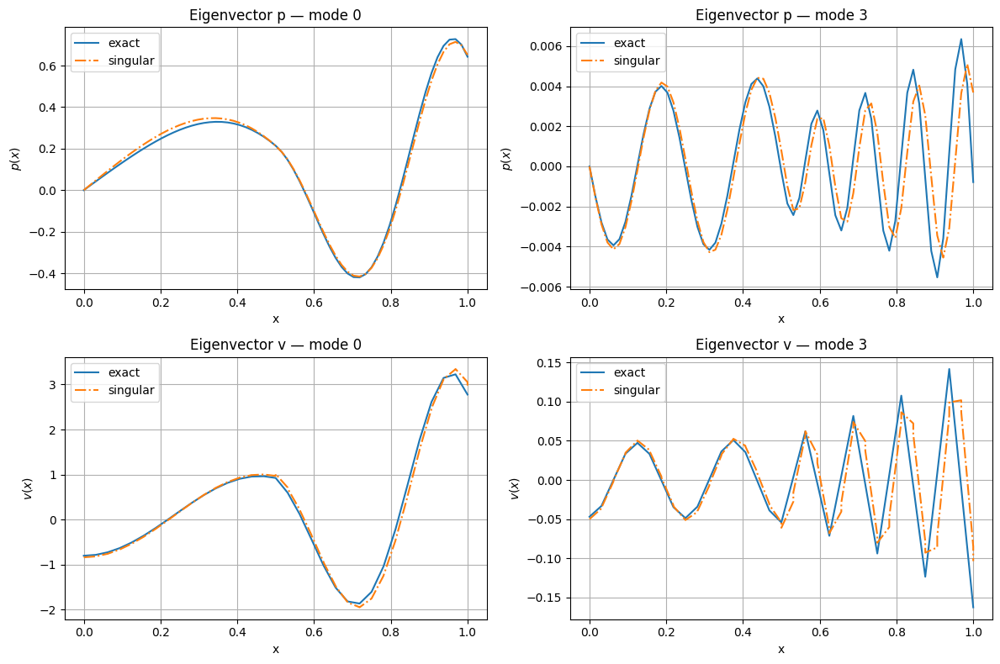

$[Closest] idx=0  \omega=(12.441829003750868-2.1390769562307033j)  \epsilon_r=(0.0981219335349926+0j)$
$[Closest] idx=28  \omega=(49.41144556098216-1.8347795791649335j)  \epsilon_r=(0.667427065960965+0j)$


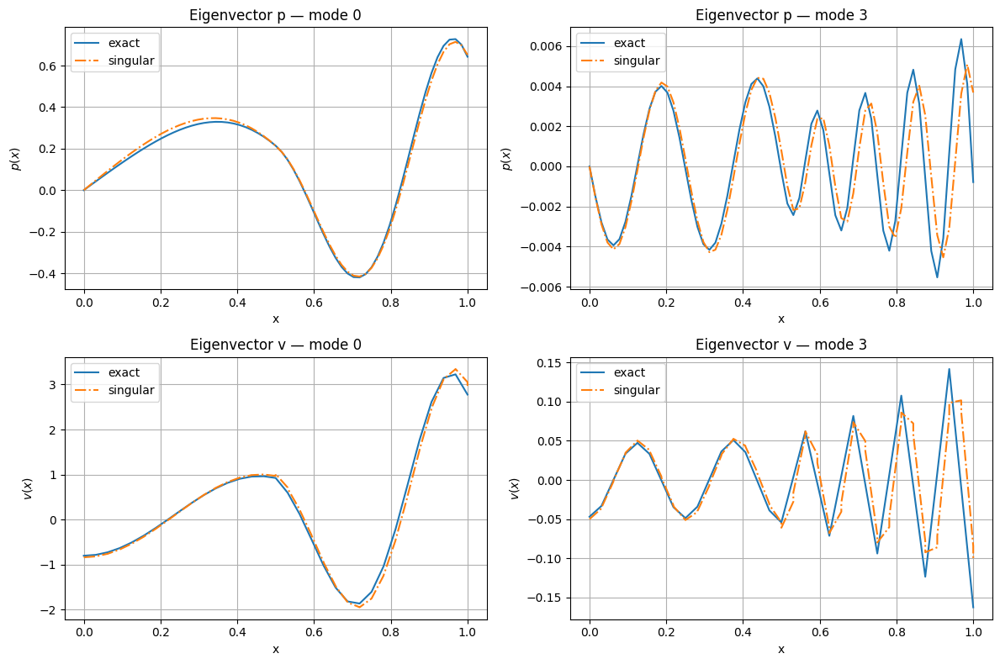

$[Closest] idx=0  \omega=(12.441819747271017-2.1393768790026715j)  \epsilon_r=(0.0980628204870001+0j)$
$[Closest] idx=29  \omega=(49.40772887018319-1.8299810943533934j)  \epsilon_r=(0.6706687907067816+0j)$


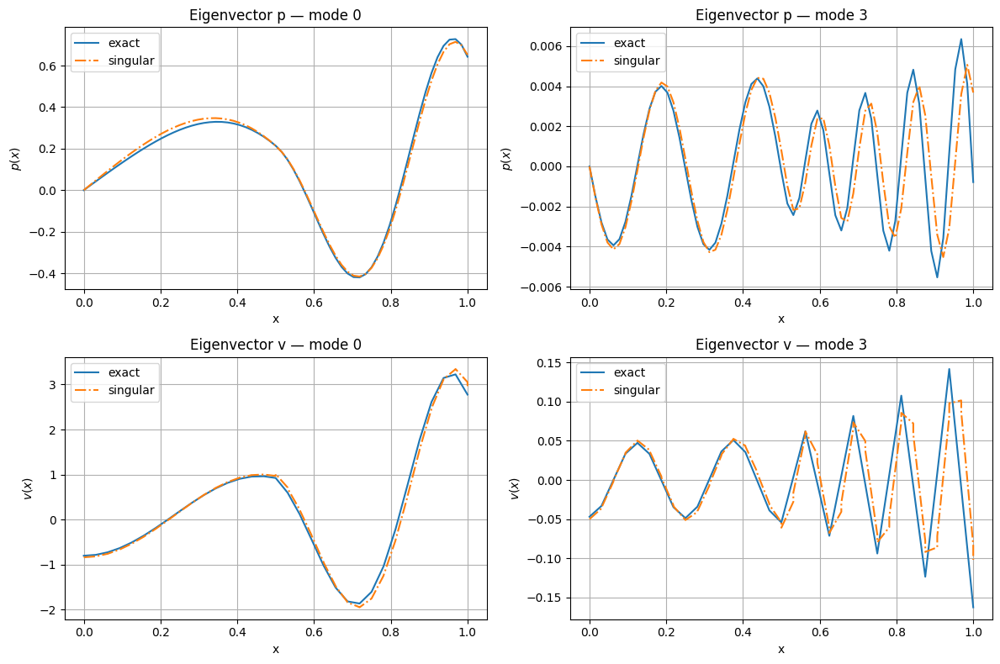

$[Closest] idx=0  \omega=(12.441847175944991-2.13970072489293j)  \epsilon_r=(0.0979788174616057+0j)$
$[Closest] idx=29  \omega=(49.403719909106464-1.8254318717563558j)  \epsilon_r=(0.6740376779103774+0j)$


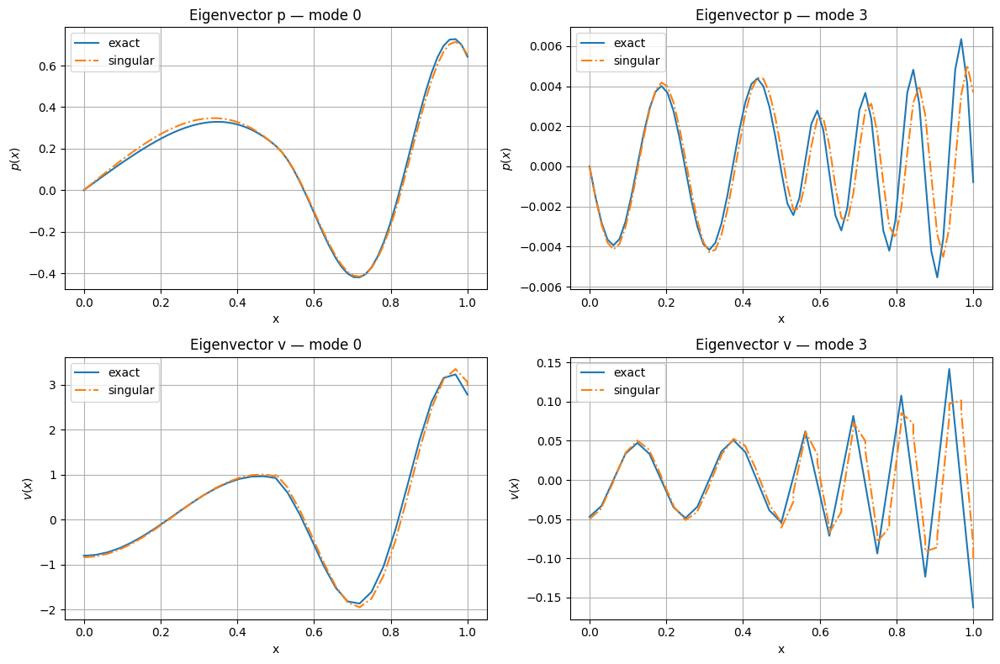

$[Closest] idx=0  \omega=(12.441916496013803-2.1400461406547406j)  \epsilon_r=(0.09786760631487773+0j)$
$[Closest] idx=29  \omega=(49.39943790610814-1.8211400764334709j)  \epsilon_r=(0.6775192948394884+0j)$


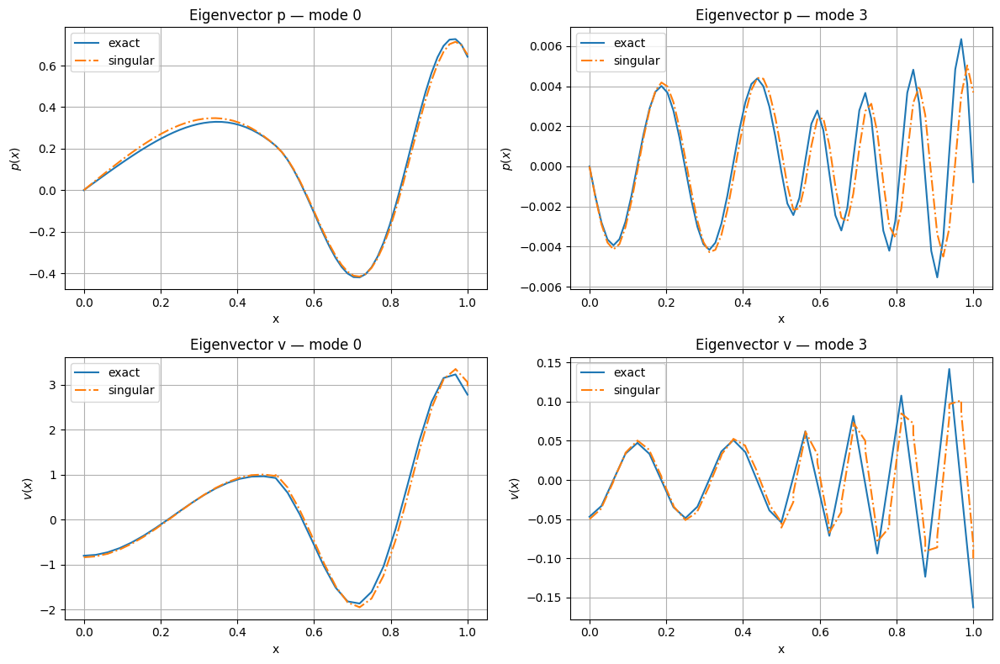

$[Closest] idx=0  \omega=(12.442032727598418-2.1404104227472107j)  \epsilon_r=(0.09772703109810191+0j)$
$[Closest] idx=29  \omega=(49.39490118794597-1.8171127118024315j)  \epsilon_r=(0.6811000421810589+0j)$


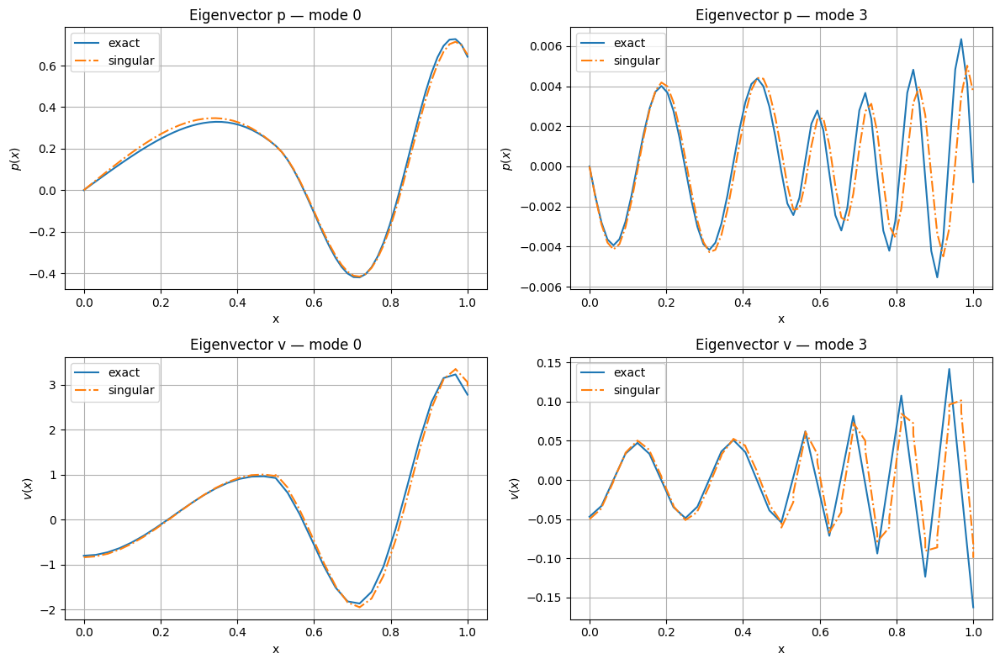

$[Closest] idx=0  \omega=(12.442200787322962-2.1407904606439905j)  \epsilon_r=(0.09755506285256035+0j)$
$[Closest] idx=29  \omega=(49.39012739784469-1.8133557134041185j)  \epsilon_r=(0.6847670232570684+0j)$


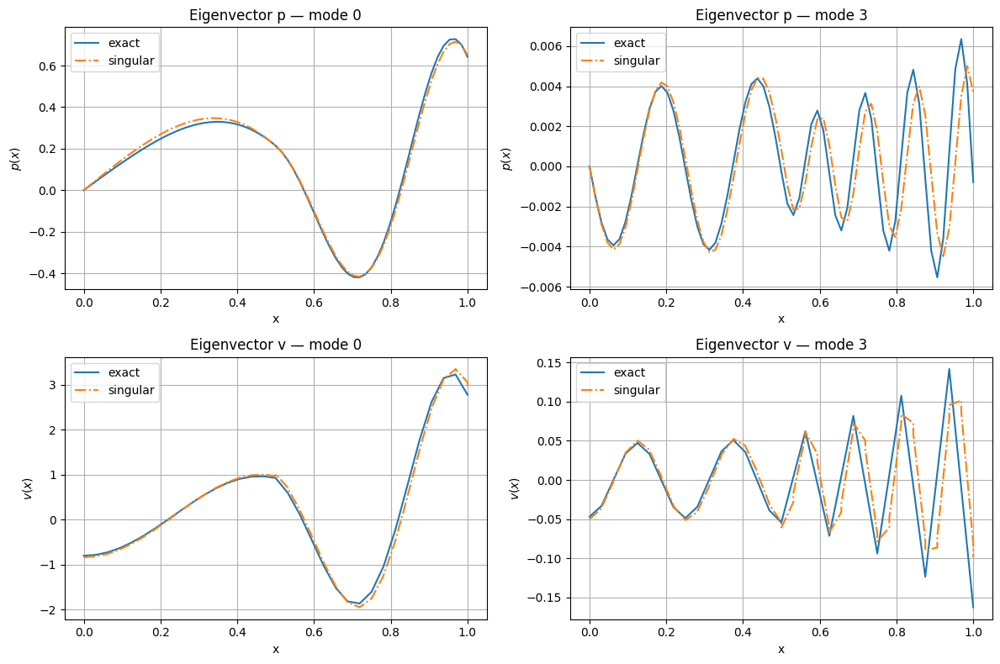

$[Closest] idx=0  \omega=(12.44242551585501-2.1411827265518615j)  \epsilon_r=(0.09734978507078096+0j)$
$[Closest] idx=29  \omega=(49.38513355827014-1.8098739599177314j)  \epsilon_r=(0.6885080193542806+0j)$


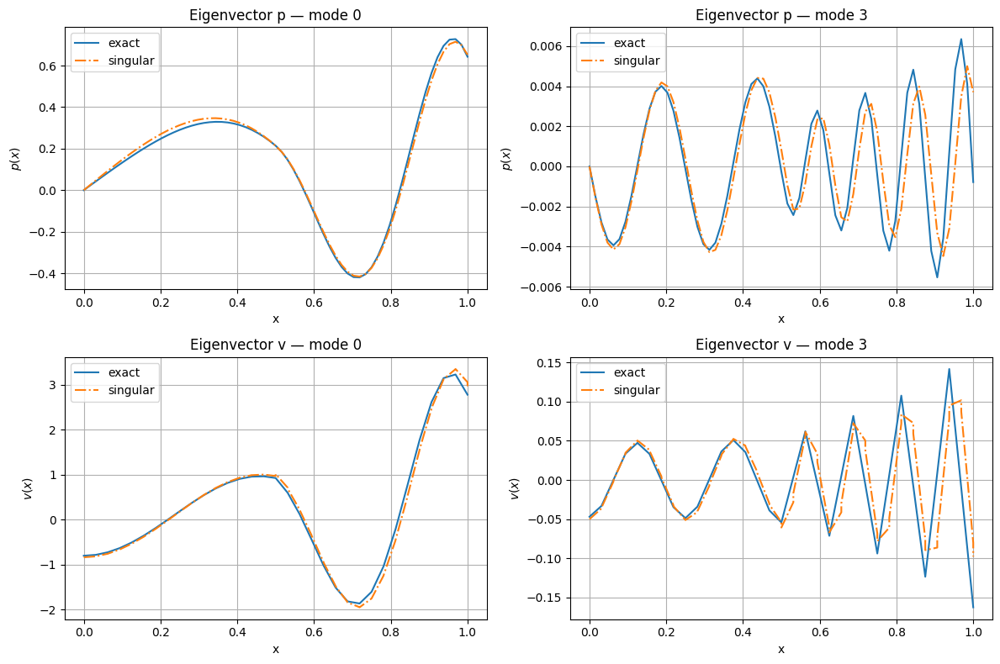

$[Closest] idx=0  \omega=(12.44271168393971-2.1415832774127534j)  \epsilon_r=(0.09710938909085734+0j)$
$[Closest] idx=29  \omega=(49.37993605047703-1.8066713017791352j)  \epsilon_r=(0.6923115069141957+0j)$


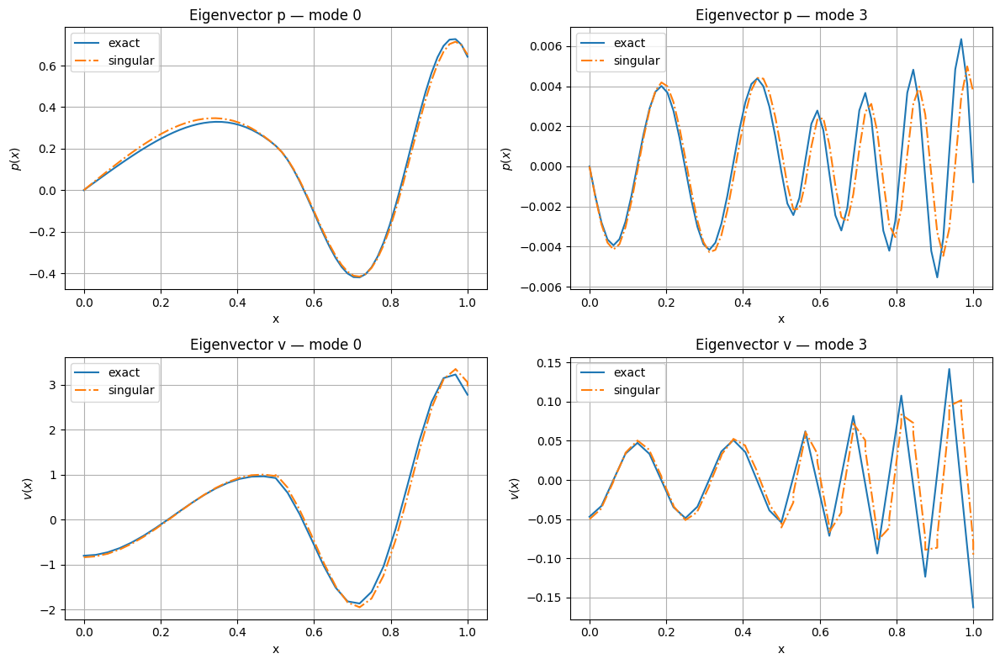

$[Closest] idx=0  \omega=(12.443063987715089-2.141987759319204j)  \epsilon_r=(0.09683217588583737+0j)$
$[Closest] idx=29  \omega=(49.374550568752284-1.8037506235930498j)  \epsilon_r=(0.6961666790704348+0j)$


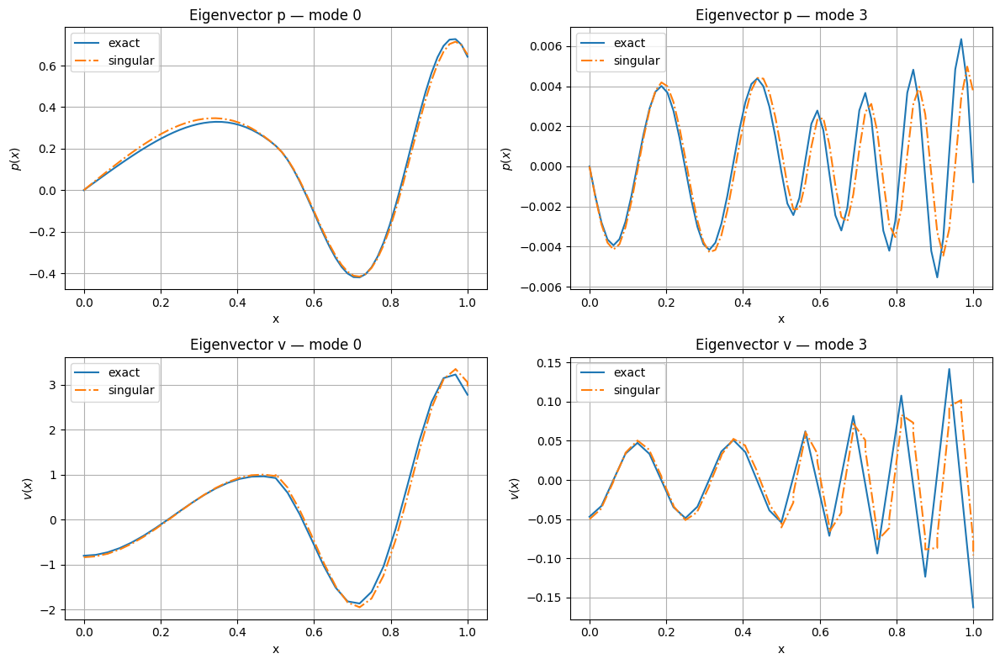

$[Closest] idx=0  \omega=(12.44348703731819-2.142391412299383j)  \epsilon_r=(0.09651656274962325+0j)$
$[Closest] idx=29  \omega=(49.368992078772415-1.8011139289406233j)  \epsilon_r=(0.7000634570321842+0j)$


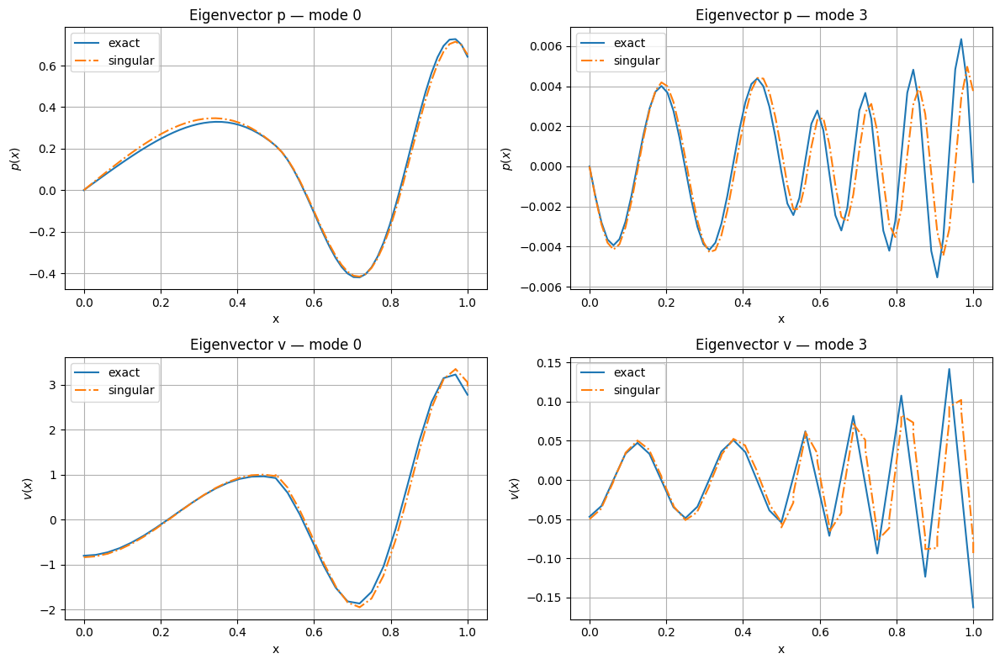

$[Closest] idx=0  \omega=(12.443985340704858-2.1427890754952106j)  \epsilon_r=(0.09616109410643561+0j)$
$[Closest] idx=29  \omega=(49.36327478947438-1.798762433180622j)  \epsilon_r=(0.7039924893745857+0j)$


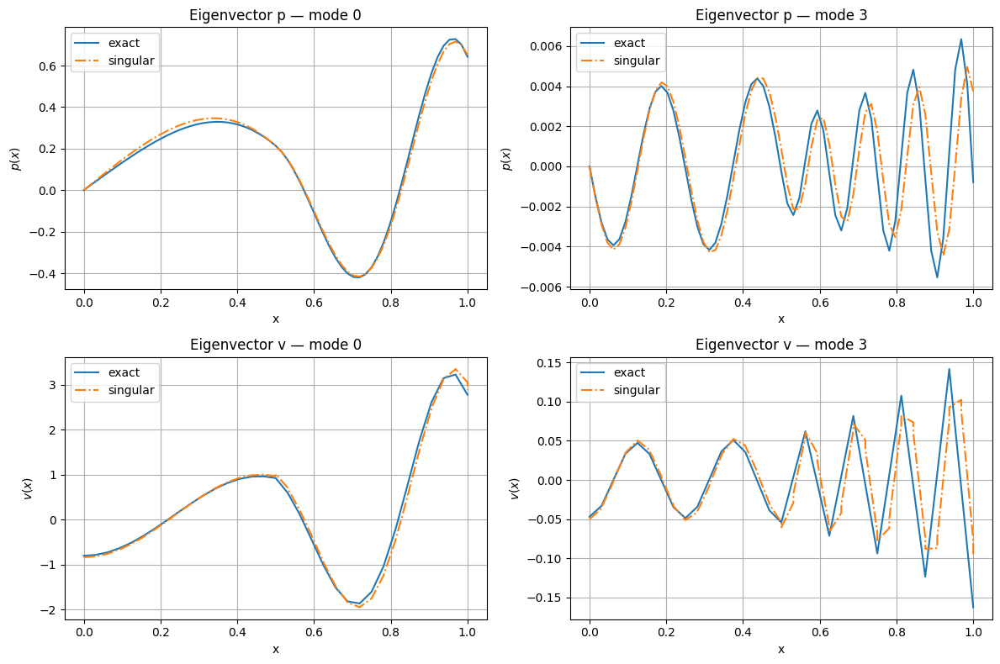

$[Closest] idx=0  \omega=(12.444563283802882-2.1431751931392773j)  \epsilon_r=(0.09576445605927406+0j)$
$[Closest] idx=29  \omega=(49.35741213793011-1.796696654499799j)  \epsilon_r=(0.7079451421302876+0j)$


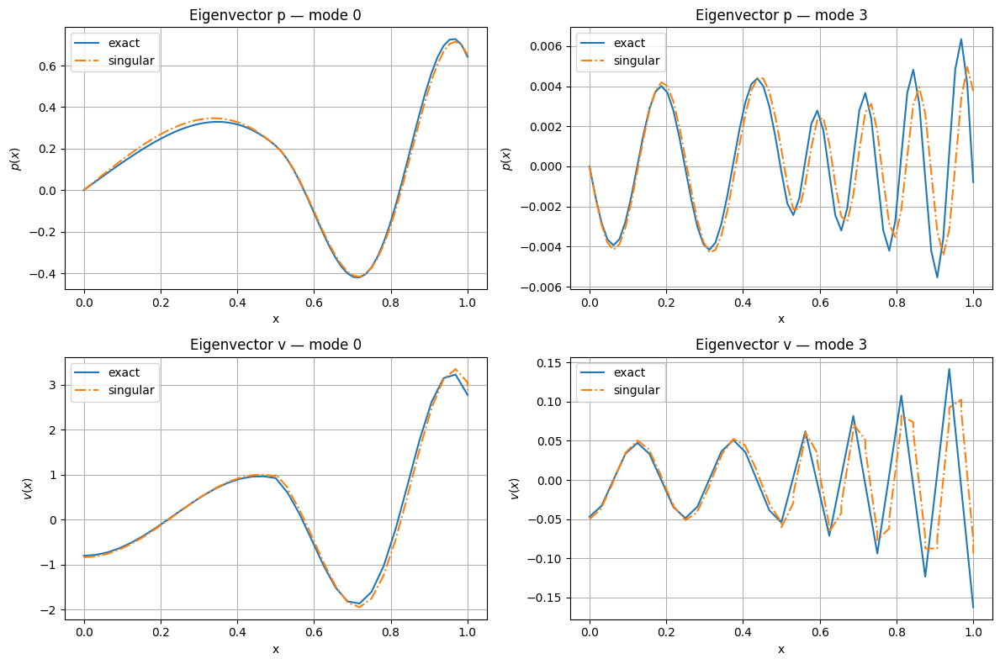

$[Closest] idx=0  \omega=(12.445225107704925-2.1435438217422833j)  \epsilon_r=(0.09532549455040254+0j)$
$[Closest] idx=29  \omega=(49.35141678342162-1.794916498630954j)  \epsilon_r=(0.7119134833350808+0j)$


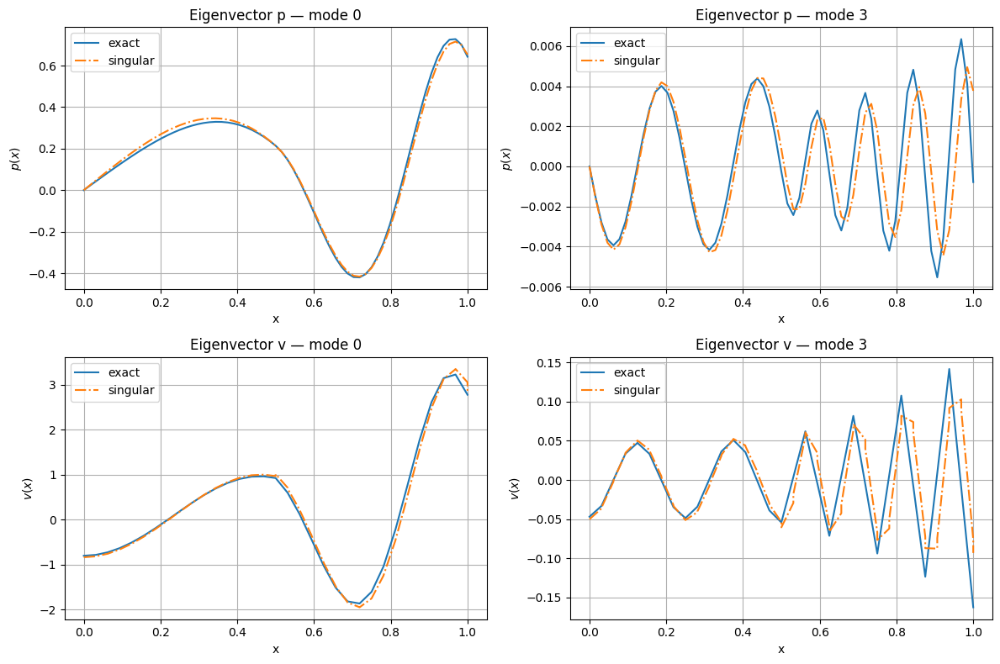

$[Closest] idx=0  \omega=(12.445974883360797-2.1438886388658105j)  \epsilon_r=(0.09484323718417456+0j)$
$[Closest] idx=29  \omega=(49.345300606943326-1.7934213362151064j)  \epsilon_r=(0.7158902648128086+0j)$


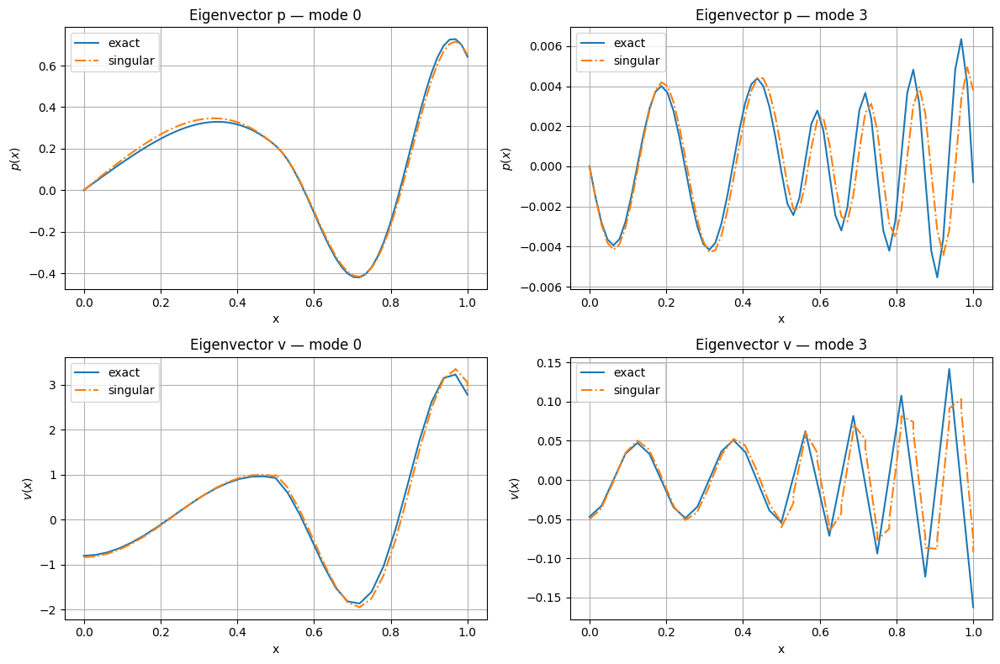

$[Closest] idx=0  \omega=(12.446816484093267-2.1442029538412375j)  \epsilon_r=(0.09431691887531549+0j)$
$[Closest] idx=29  \omega=(49.339074713506164-1.7922100735742668j)  \epsilon_r=(0.7198689028551153+0j)$


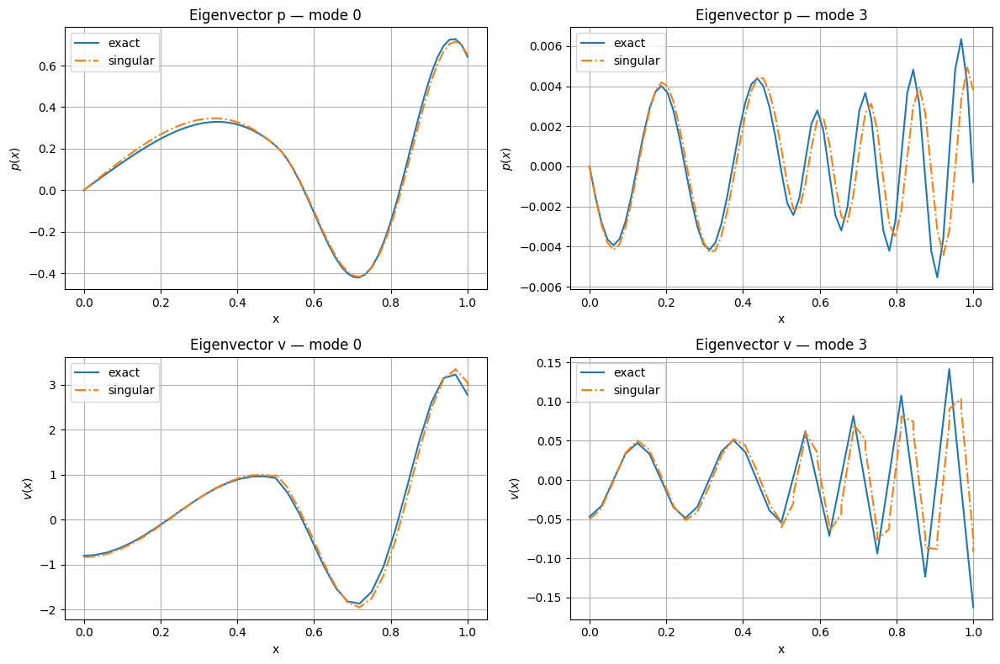

$[Closest] idx=0  \omega=(12.447753556198595-2.1444797207896507j)  \epsilon_r=(0.09374601155688228+0j)$
$[Closest] idx=30  \omega=(49.33274943586406-1.791281218238684j)  \epsilon_r=(0.723843458538131+0j)$


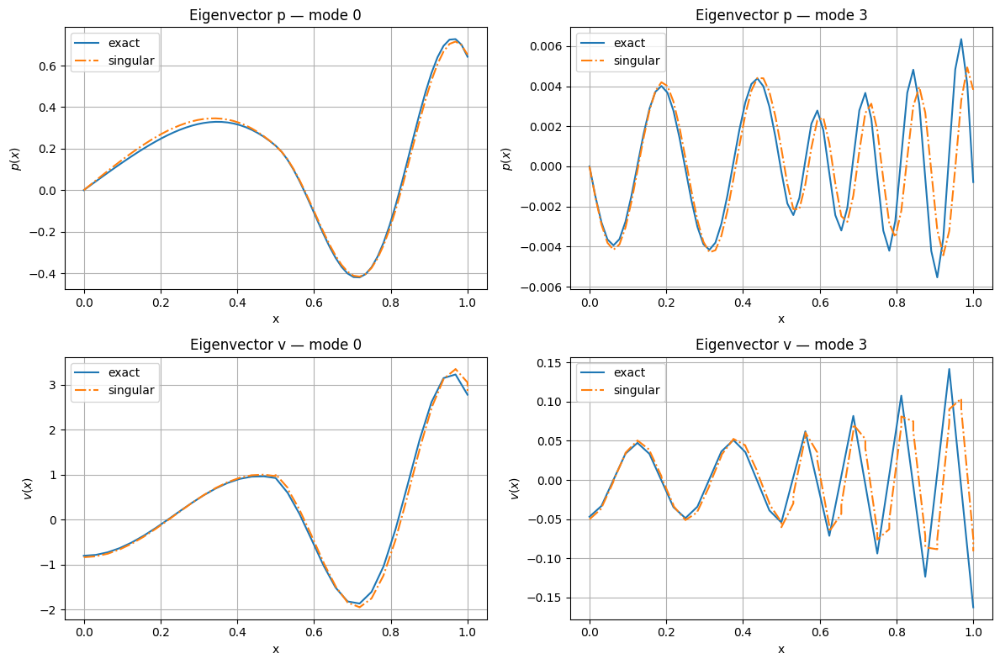

$[Closest] idx=1  \omega=(12.44878948788044-2.144711554296304j)  \epsilon_r=(0.0931302582226905+0j)$
$[Closest] idx=30  \omega=(49.32633433920546-1.790632940467608j)  \epsilon_r=(0.7278086178651041+0j)$


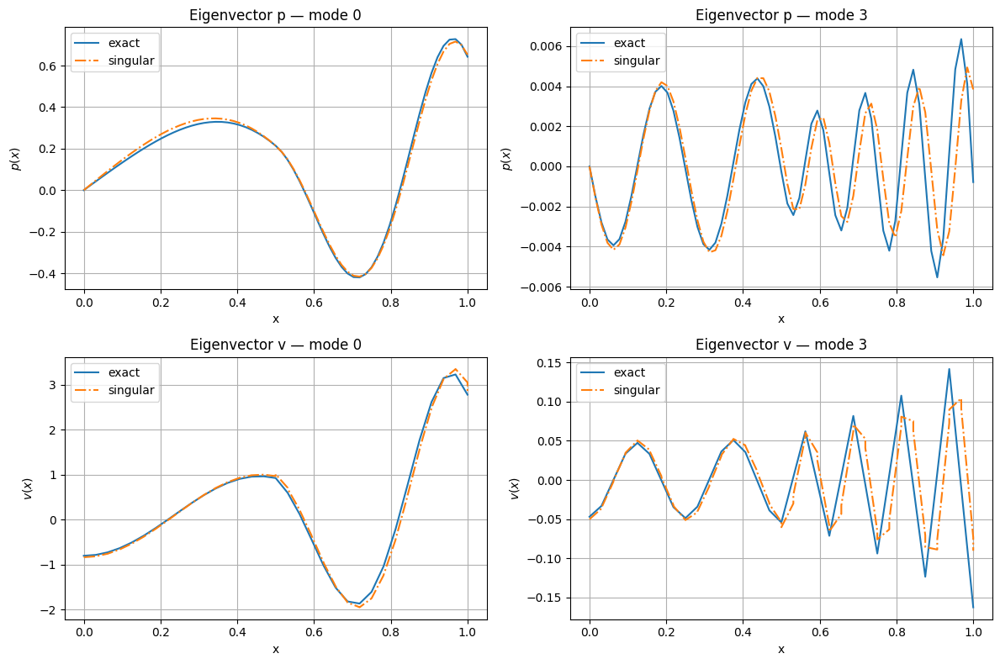

$[Closest] idx=0  \omega=(12.44992737678642-2.14489074808714j)  \epsilon_r=(0.09246971159747047+0j)$
$[Closest] idx=30  \omega=(49.31983822685358-1.7902631316319557j)  \epsilon_r=(0.731759671683967+0j)$


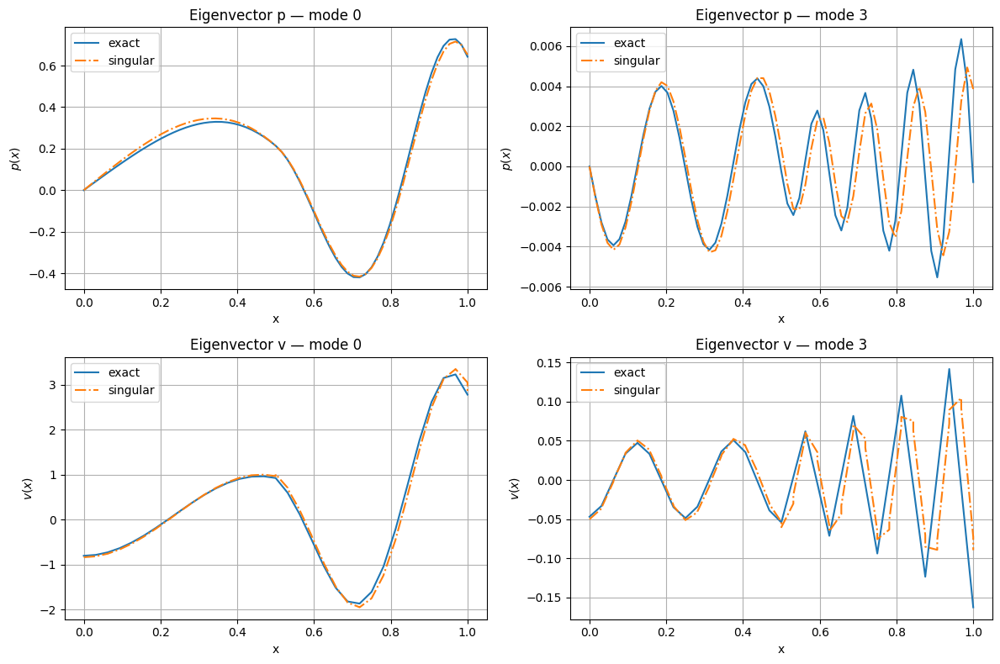

$[Closest] idx=0  \omega=(12.451169996457228-2.1450092970423005j)  \epsilon_r=(0.0917647777284415+0j)$
$[Closest] idx=30  \omega=(49.313269147233584-1.7901694598999913j)  \epsilon_r=(0.7356924952793285+0j)$


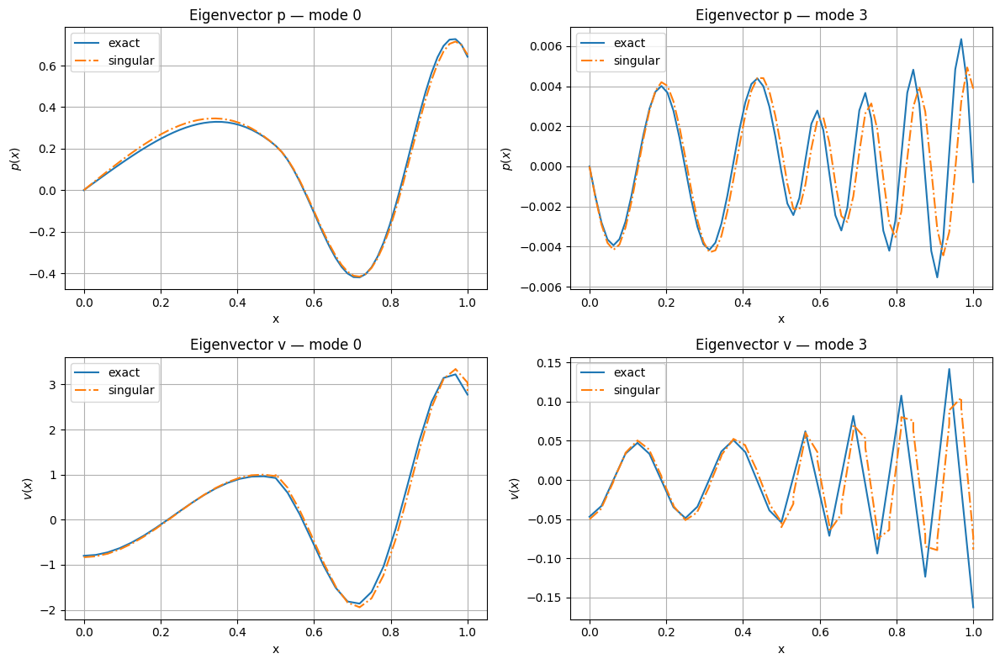

$[Closest] idx=1  \omega=(12.452519762053413-2.145058922860865j)  \epsilon_r=(0.09101626477223407+0j)$
$[Closest] idx=30  \omega=(49.306634402345246-1.7903494233397577j)  \epsilon_r=(0.7396035276032825+0j)$


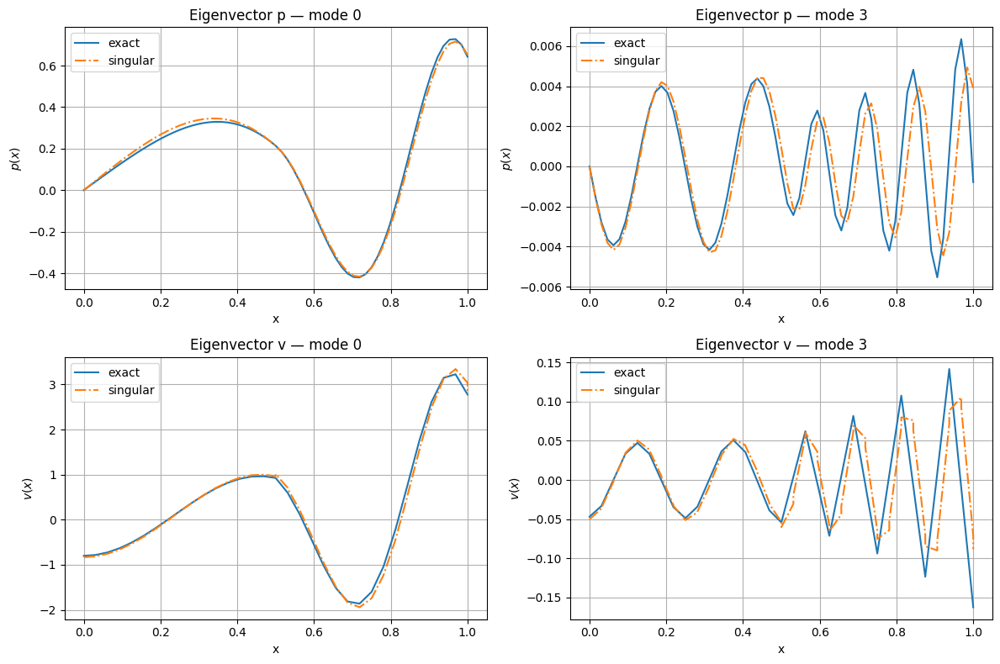

$[Closest] idx=0  \omega=(12.453978695788669-2.145031103659086j)  \epsilon_r=(0.09022543720837811+0j)$
$[Closest] idx=30  \omega=(49.299940557863174-1.790800400317907j)  \epsilon_r=(0.743489750216542+0j)$


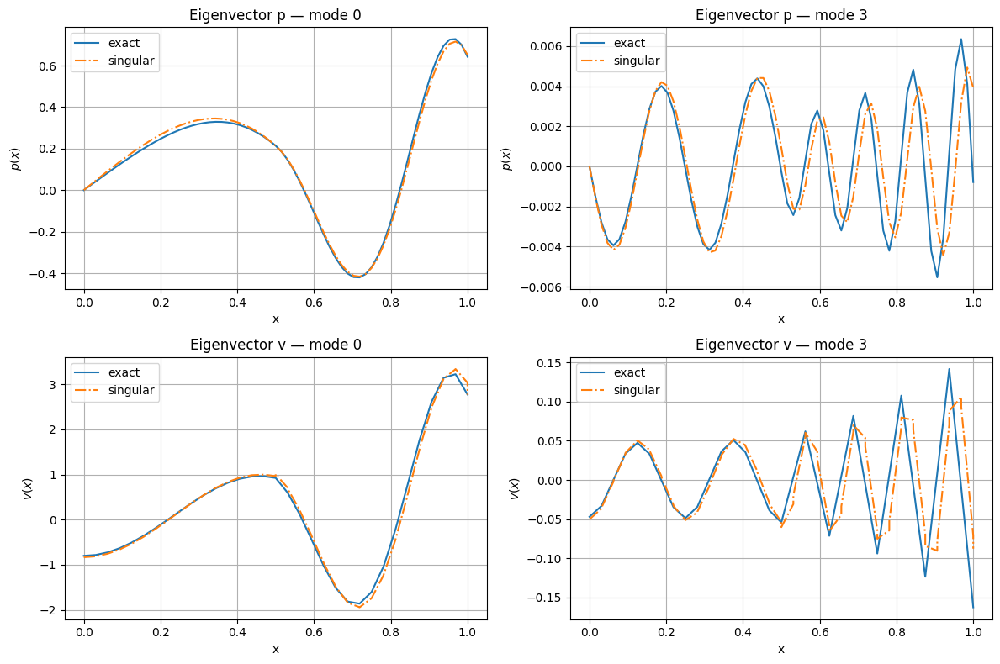

$[Closest] idx=0  \omega=(12.455548392567495-2.144917107742216j)  \epsilon_r=(0.08939407563708042+0j)$
$[Closest] idx=30  \omega=(49.293193454825776-1.7915196969647111j)  \epsilon_r=(0.7473486661124217+0j)$


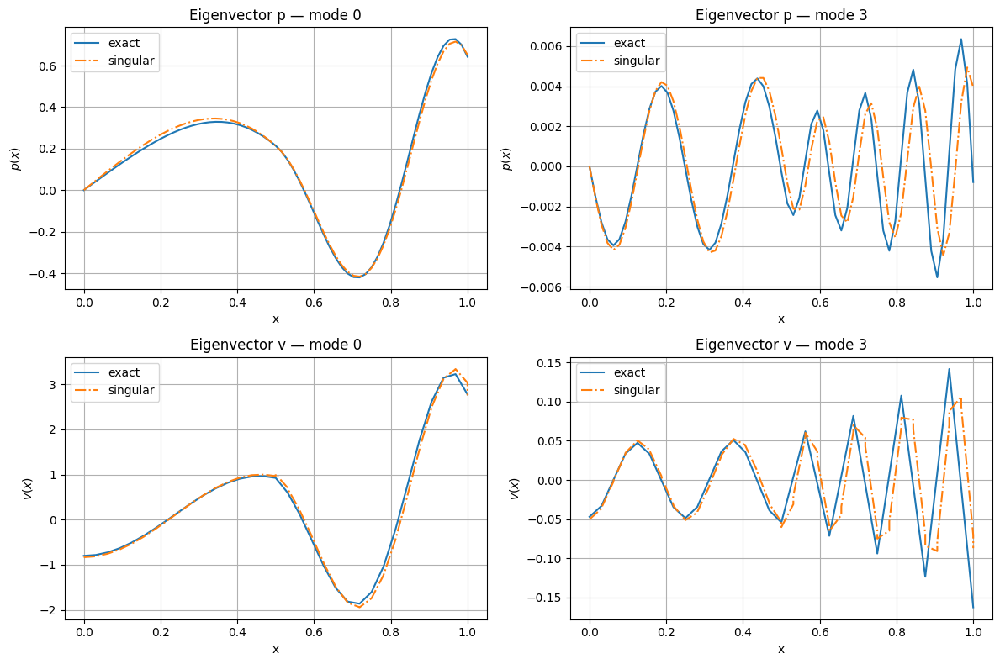

$[Closest] idx=0  \omega=(12.457229986395935-2.144708031730788j)  \epsilon_r=(0.08852454220581599+0j)$
$[Closest] idx=30  \omega=(49.28639822272783-1.7925045914349733j)  \epsilon_r=(0.7511782786782286+0j)$


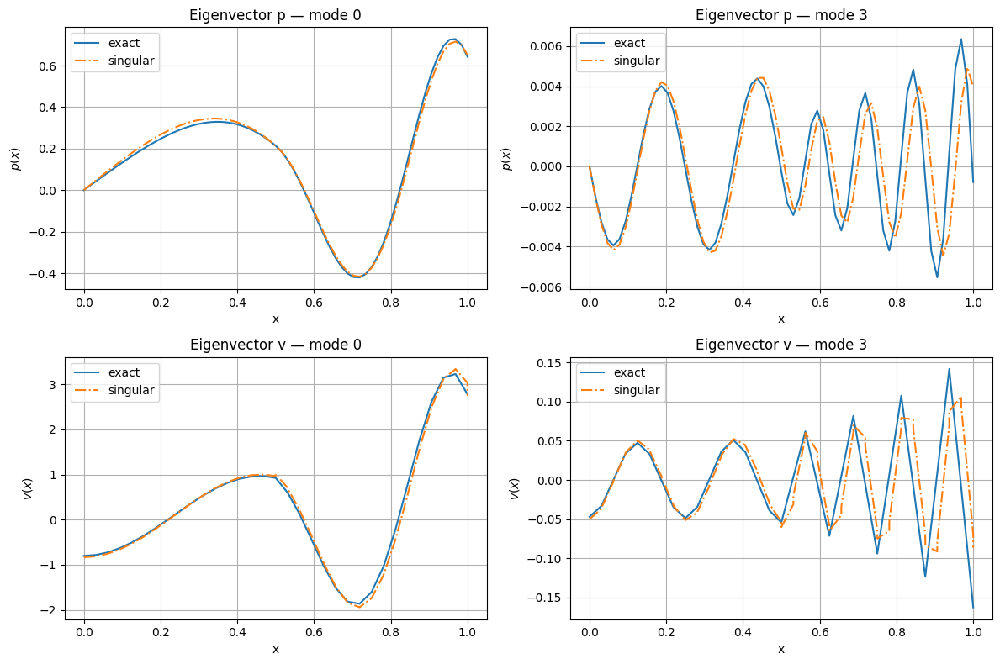

$[Closest] idx=0  \omega=(12.459024118201881-2.14439484315106j)  \epsilon_r=(0.08761985154249405+0j)$
$[Closest] idx=31  \omega=(49.27955929369107-1.7937523747242232j)  \epsilon_r=(0.7549770711036207+0j)$


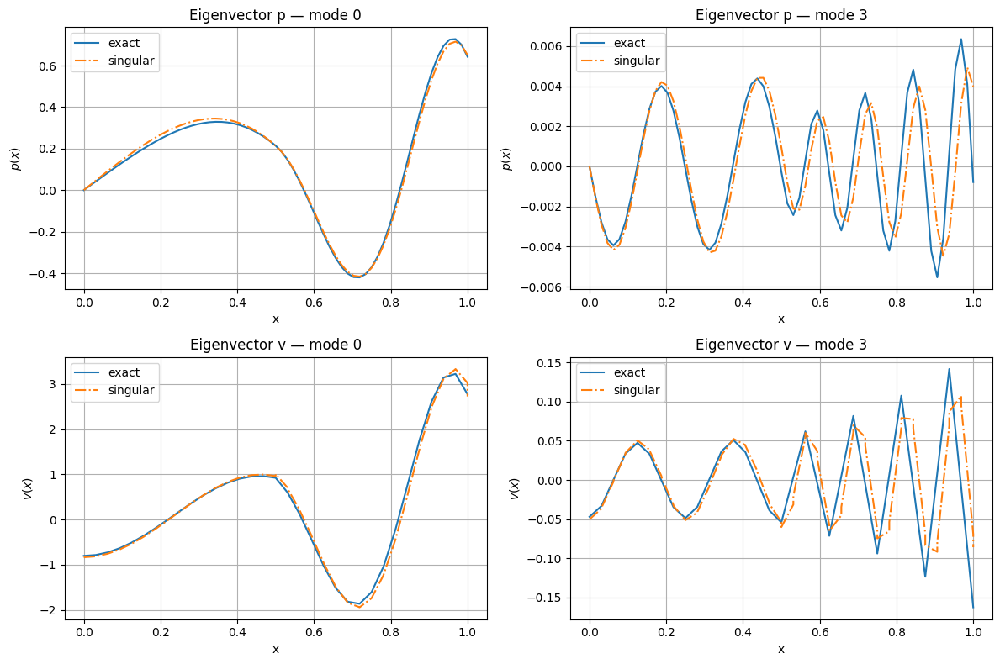

$[Closest] idx=0  \omega=(12.46093090576434-2.143968427508703j)  \epsilon_r=(0.08668374683542678+0j)$
$[Closest] idx=31  \omega=(49.27268041732672-1.795260387856186j)  \epsilon_r=(0.7587439865605614+0j)$


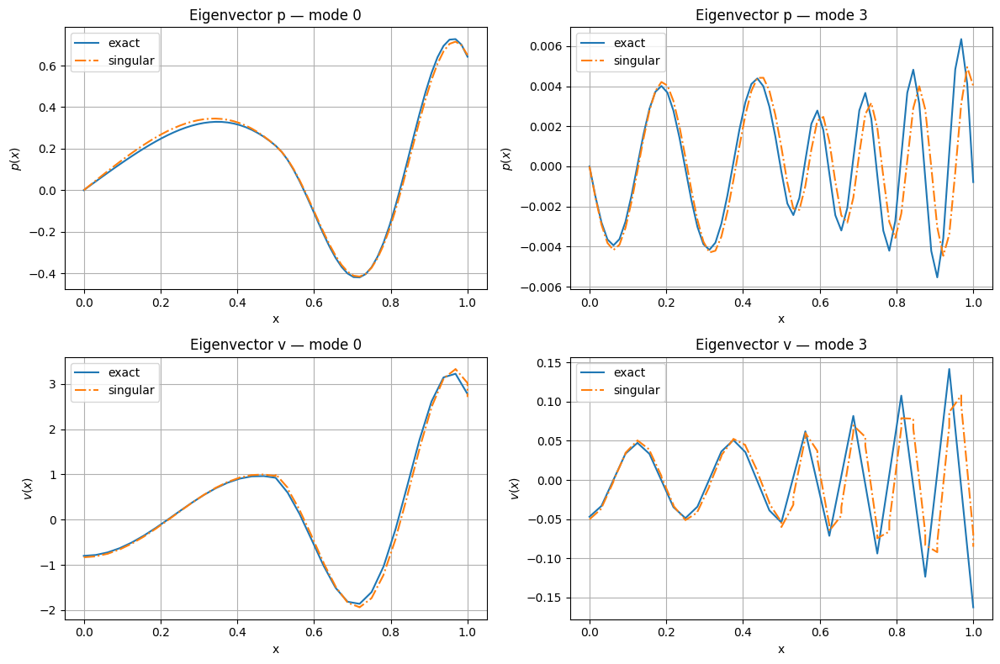

$[Closest] idx=0  \omega=(12.462949916501806-2.14341963975949j)  \epsilon_r=(0.08572078037092341+0j)$
$[Closest] idx=31  \omega=(49.26576467581726-1.7970260553243824j)  \epsilon_r=(0.7624784094943233+0j)$


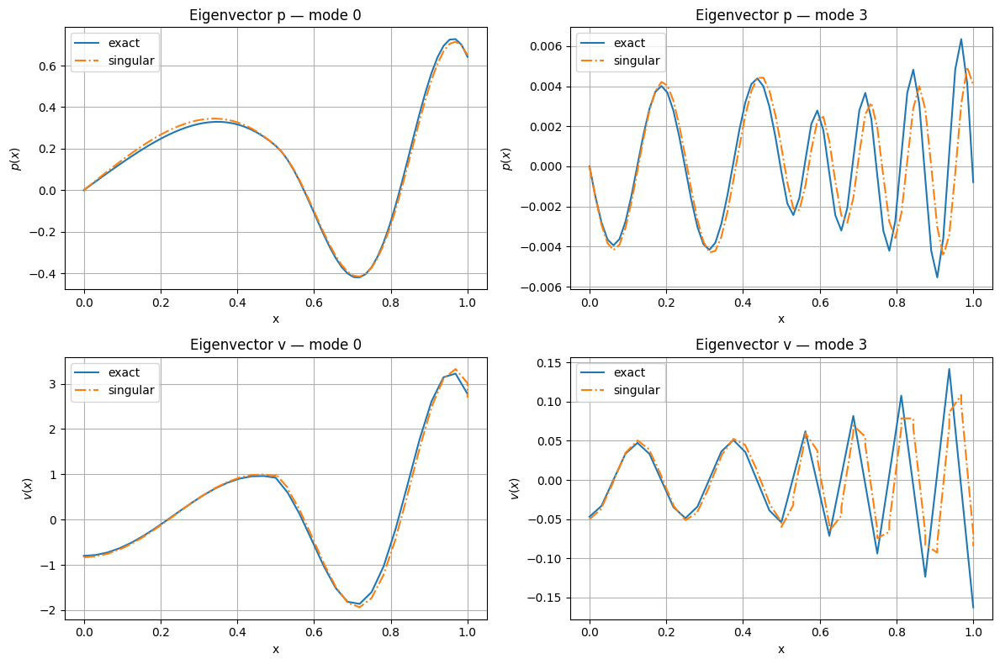

$[Closest] idx=0  \omega=(12.465080143906752-2.1427393599700135j)  \epsilon_r=(0.0847363973913223+0j)$
$[Closest] idx=31  \omega=(49.2588144987584-1.7990469147426462j)  \epsilon_r=(0.7661801483309638+0j)$


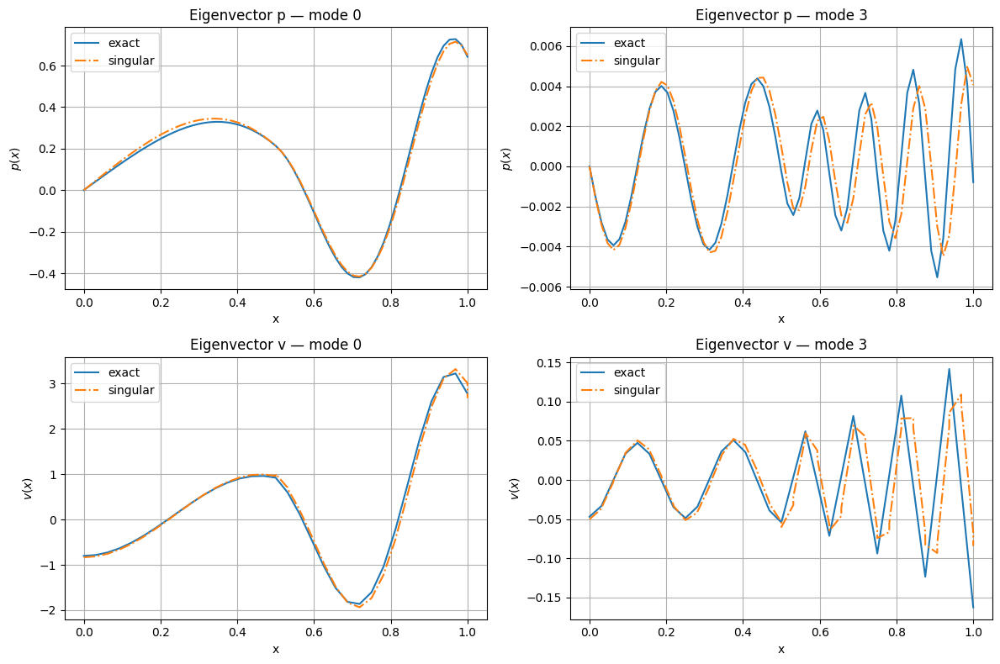

$[Closest] idx=0  \omega=(12.467319988428962-2.1419185528256004j)  \epsilon_r=(0.08373702154173487+0j)$
$[Closest] idx=31  \omega=(49.25183167728415-1.8013206427219337j)  \epsilon_r=(0.7698494198943762+0j)$


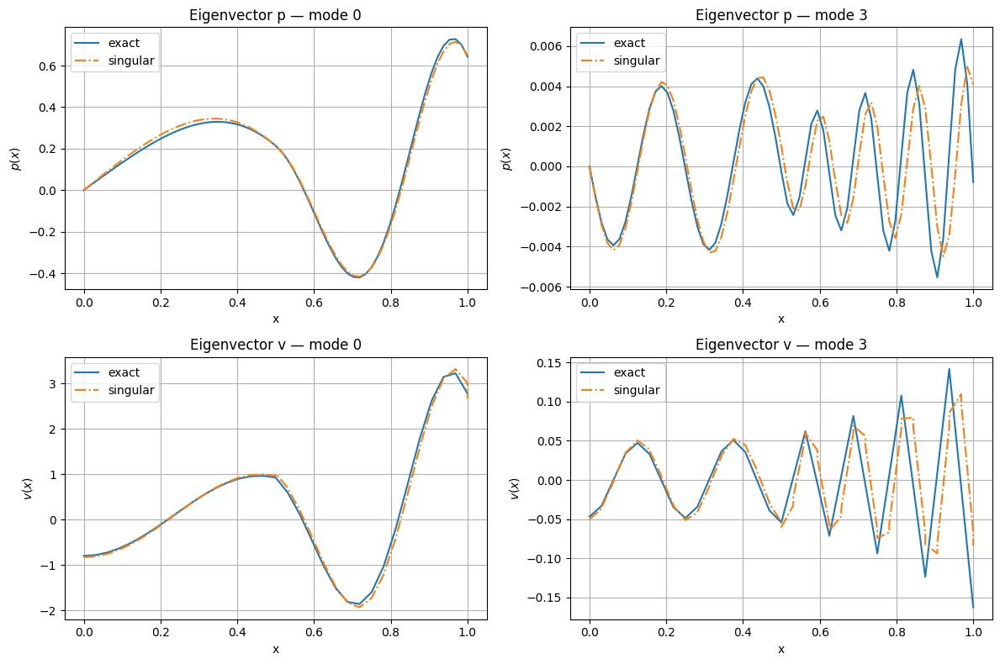


=== Executando para N = 3, h = 0.015625 ===
$[Closest] idx=0  \omega=(12.53132022227309-2.074461963105449j)  \epsilon_r=(0.08096450275033011+0j)$
$[Closest] idx=25  \omega=(50.02663481202723-2.046484353528229j)  \epsilon_r=(0.18598979963901502+0j)$


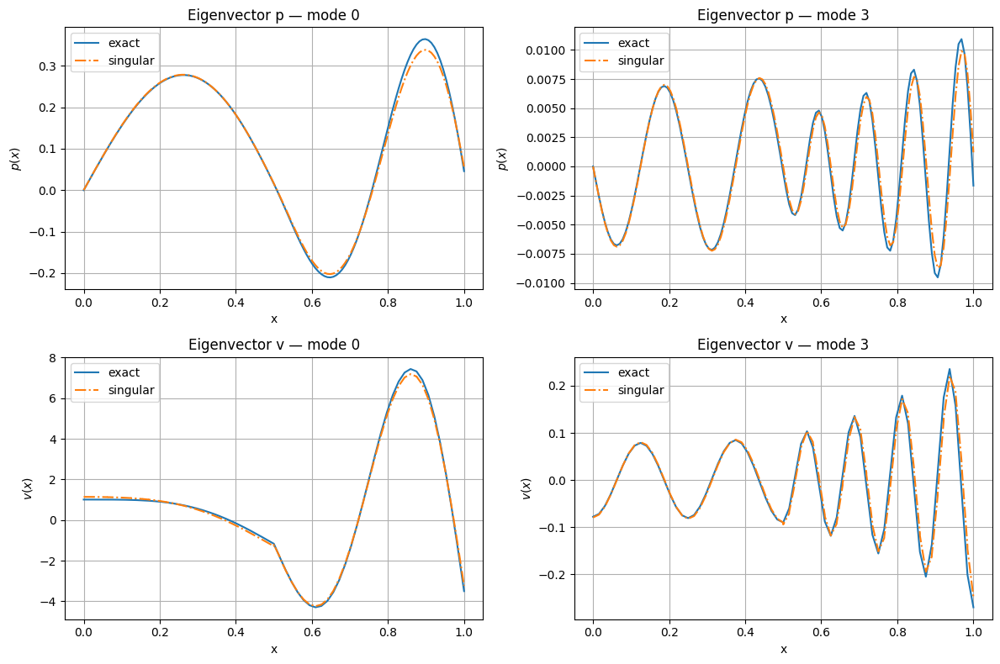

$[Closest] idx=0  \omega=(12.508974570630734-2.1785927242504184j)  \epsilon_r=(0.044203672486248125+0j)$
$[Closest] idx=27  \omega=(49.958729392537-2.0775773116449394j)  \epsilon_r=(0.21432012279999424+0j)$


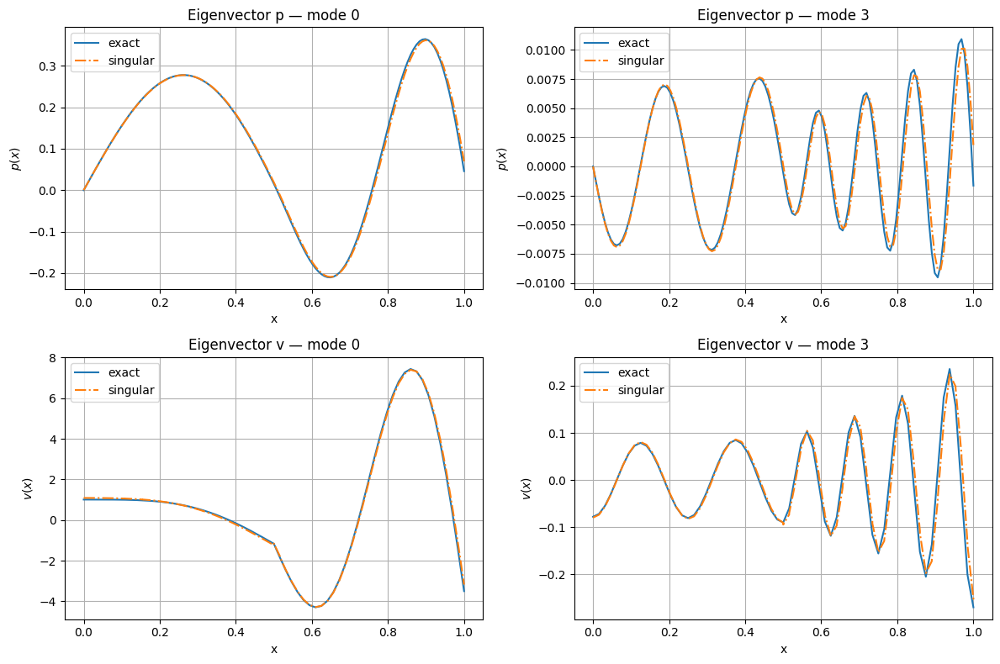

$[Closest] idx=0  \omega=(12.505687445292837-2.17690103828132j)  \epsilon_r=(0.04632821638741815+0j)$
$[Closest] idx=27  \omega=(49.95411119871352-2.0656827207411625j)  \epsilon_r=(0.21880679998859537+0j)$


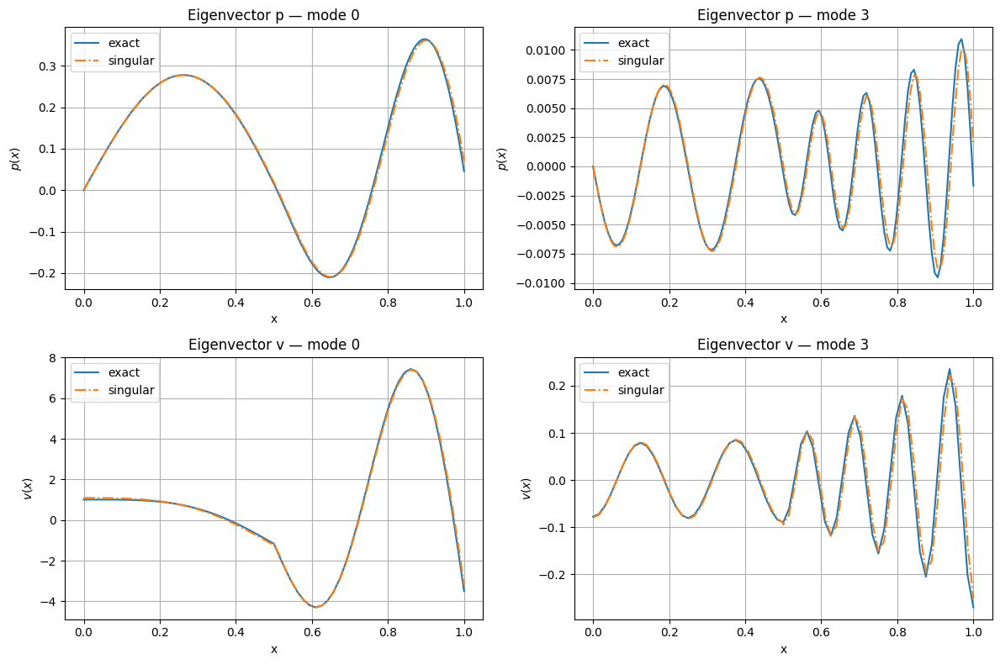

$[Closest] idx=0  \omega=(12.505256116328043-2.1770066844685894j)  \epsilon_r=(0.04655422553917825+0j)$
$[Closest] idx=27  \omega=(49.95223257492372-2.0644424094595792j)  \epsilon_r=(0.2200128714038636+0j)$


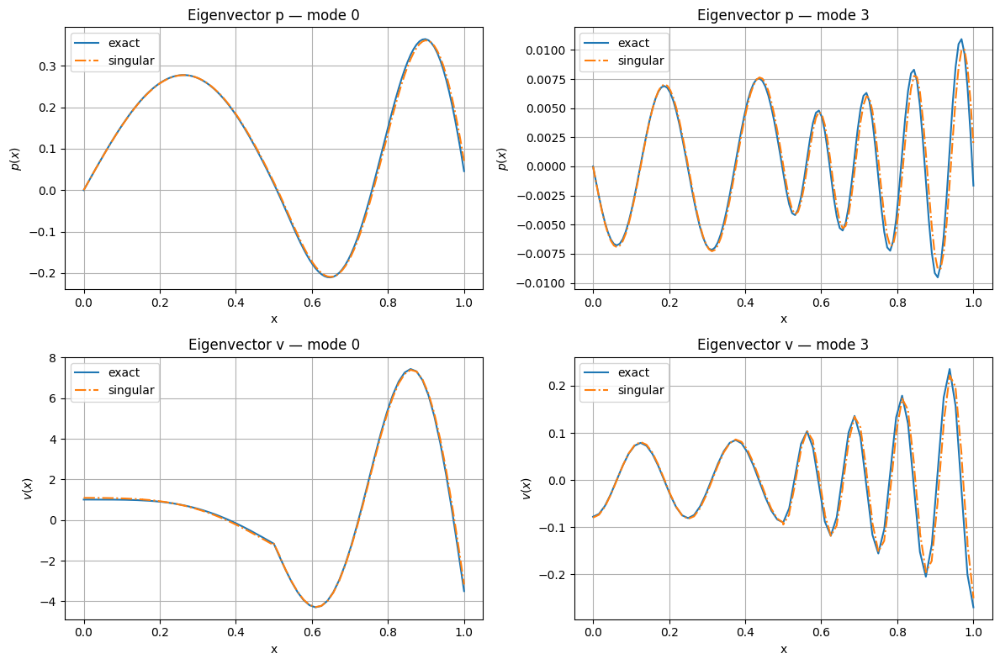

$[Closest] idx=0  \omega=(12.505314412720667-2.1770936554066074j)  \epsilon_r=(0.04650721530830241+0j)$
$[Closest] idx=27  \omega=(49.95155166872424-2.0645263223678176j)  \epsilon_r=(0.22035271362476988+0j)$


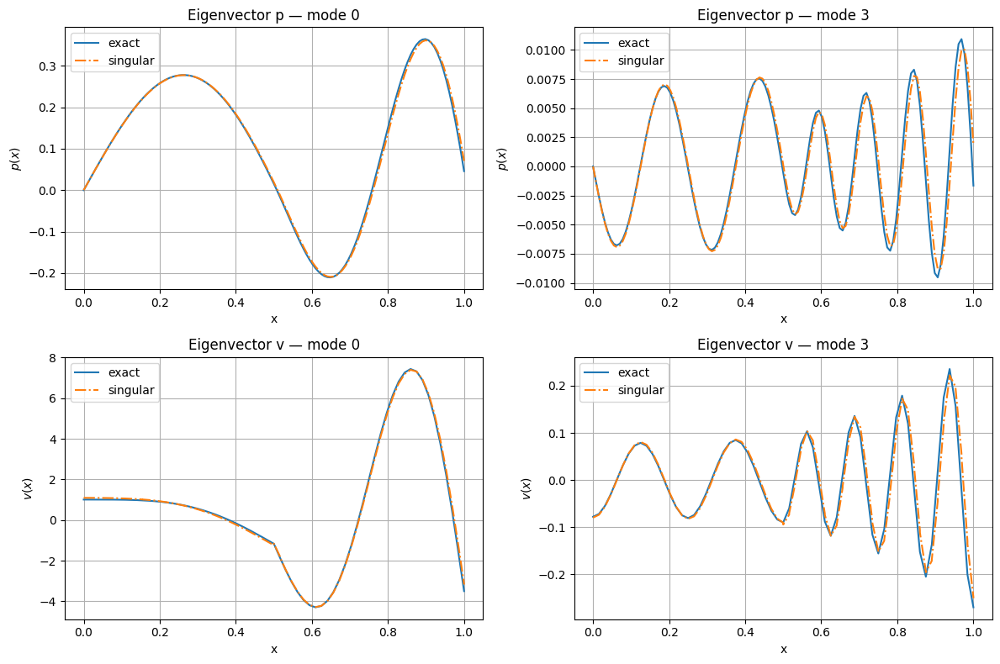

$[Closest] idx=0  \omega=(12.505382855191847-2.1770560267661234j)  \epsilon_r=(0.04647469388299824+0j)$
$[Closest] idx=27  \omega=(49.95116339508506-2.0645031411298334j)  \epsilon_r=(0.22055954295033942+0j)$


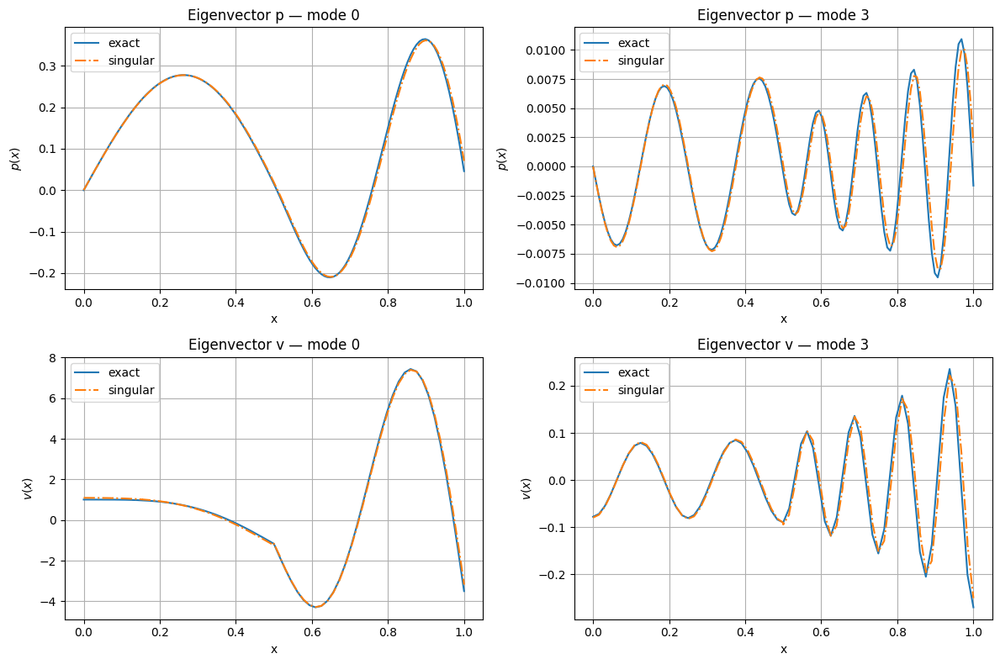

$[Closest] idx=0  \omega=(12.50541096200325-2.1770257365926406j)  \epsilon_r=(0.046463758317041276+0j)$
$[Closest] idx=27  \omega=(49.950783360153544-2.06439328355905j)  \epsilon_r=(0.2207779374272492+0j)$


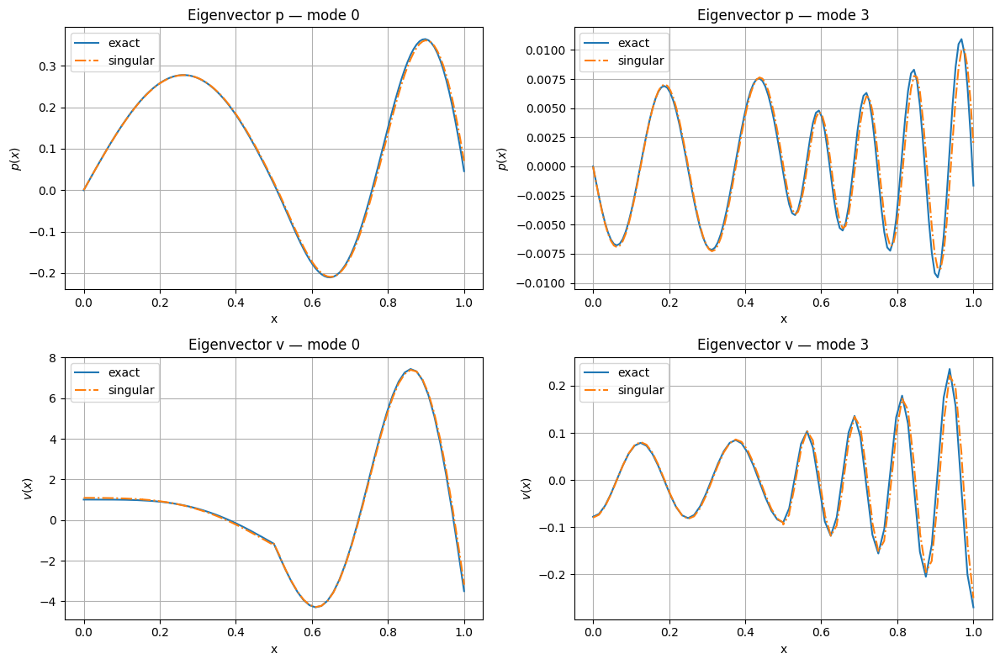

$[Closest] idx=0  \omega=(12.505417193783066-2.177018482382312j)  \epsilon_r=(0.04646142275907343+0j)$
$[Closest] idx=27  \omega=(49.95037658292593-2.0642710103521016j)  \epsilon_r=(0.22101258585272776+0j)$


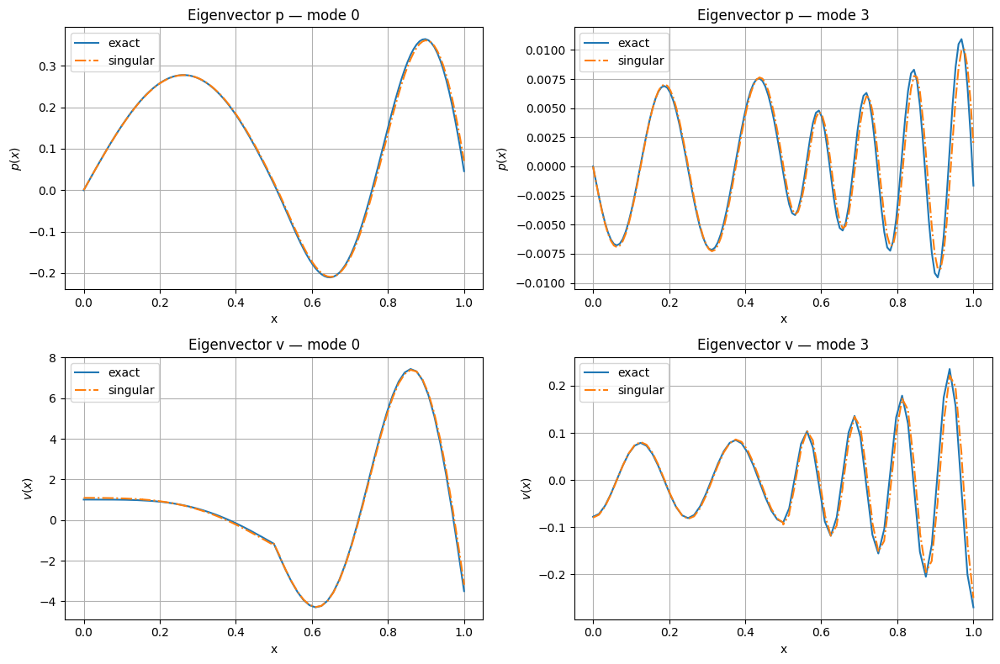

$[Closest] idx=0  \omega=(12.505415374352033-2.1770240093829725j)  \epsilon_r=(0.046461549955511106+0j)$
$[Closest] idx=27  \omega=(49.94995069990683-2.0641637654802176j)  \epsilon_r=(0.2212544908950576+0j)$


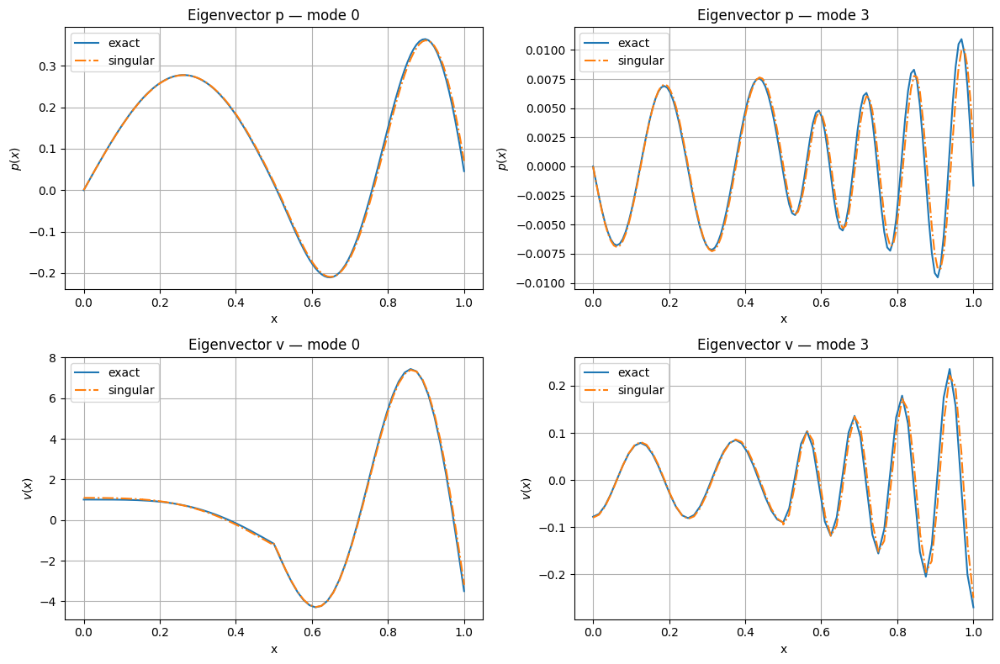

$[Closest] idx=0  \omega=(12.505411417491413-2.177035373538541j)  \epsilon_r=(0.046461934130656295+0j)$
$[Closest] idx=27  \omega=(49.949512259511195-2.0640790838335557j)  \epsilon_r=(0.22149885888452414+0j)$


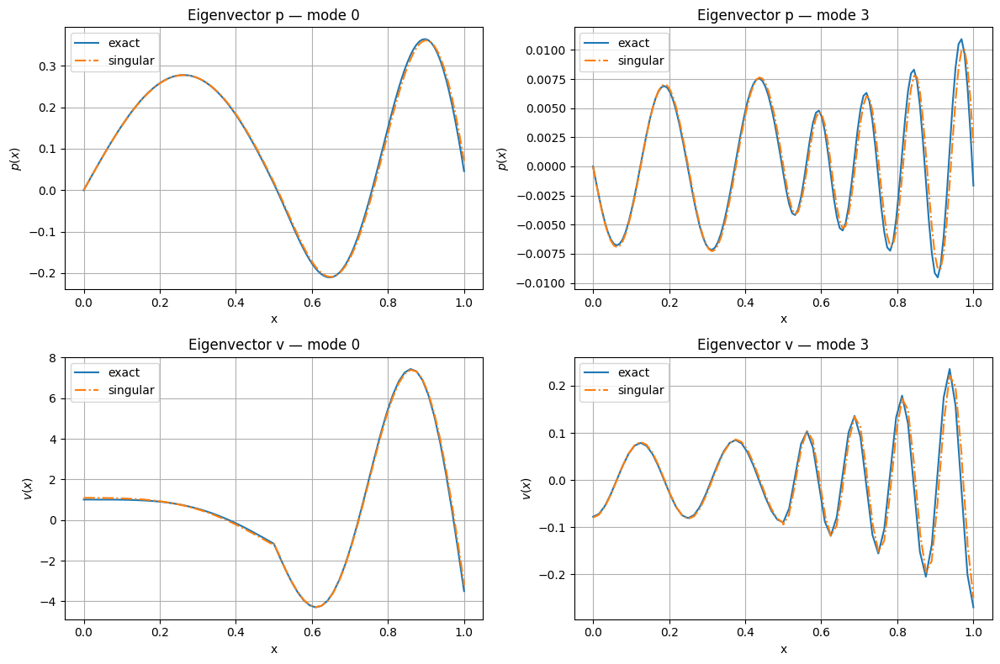

$[Closest] idx=0  \omega=(12.505407608589259-2.1770497832346654j)  \epsilon_r=(0.04646174109739695+0j)$
$[Closest] idx=27  \omega=(49.94906429263725-2.0640189806168547j)  \epsilon_r=(0.22174374219318793+0j)$


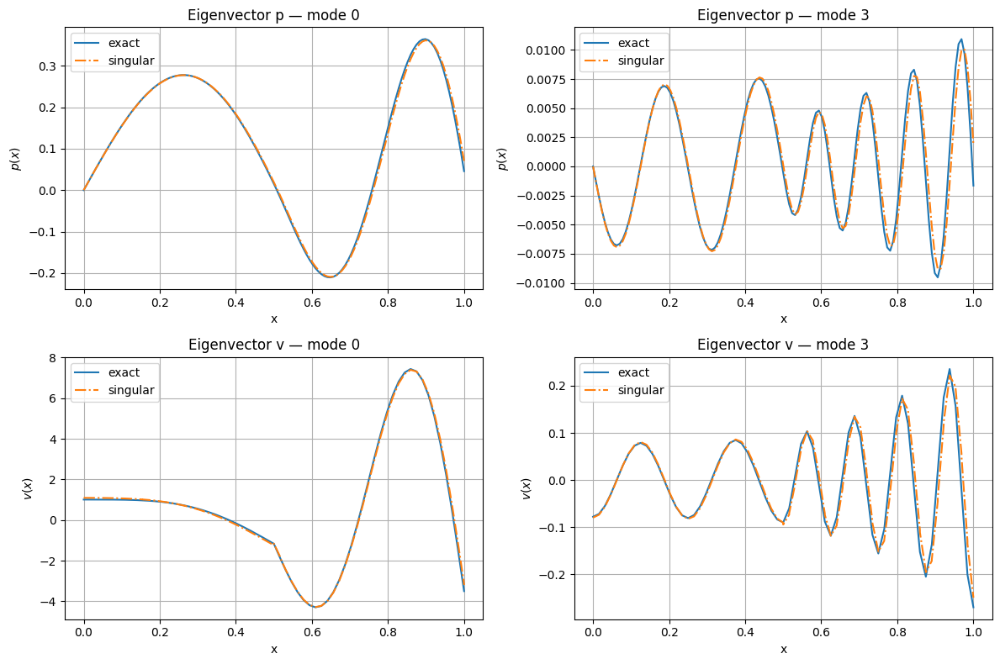

$[Closest] idx=0  \omega=(12.505404941374353-2.1770662762863506j)  \epsilon_r=(0.04646056736359351+0j)$
$[Closest] idx=27  \omega=(49.948608338363165-2.063984214377932j)  \epsilon_r=(0.2219882039899789+0j)$


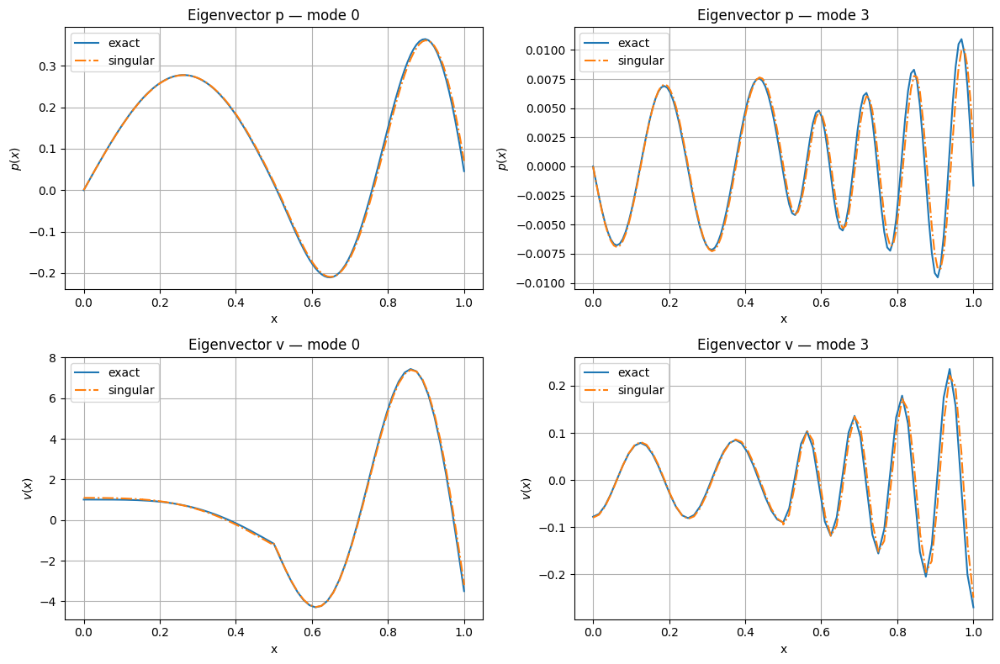

$[Closest] idx=0  \omega=(12.505403978994927-2.1770844957701456j)  \epsilon_r=(0.04645815372371398+0j)$
$[Closest] idx=28  \omega=(49.948145508823885-2.0639752833736997j)  \epsilon_r=(0.2222315805627516+0j)$


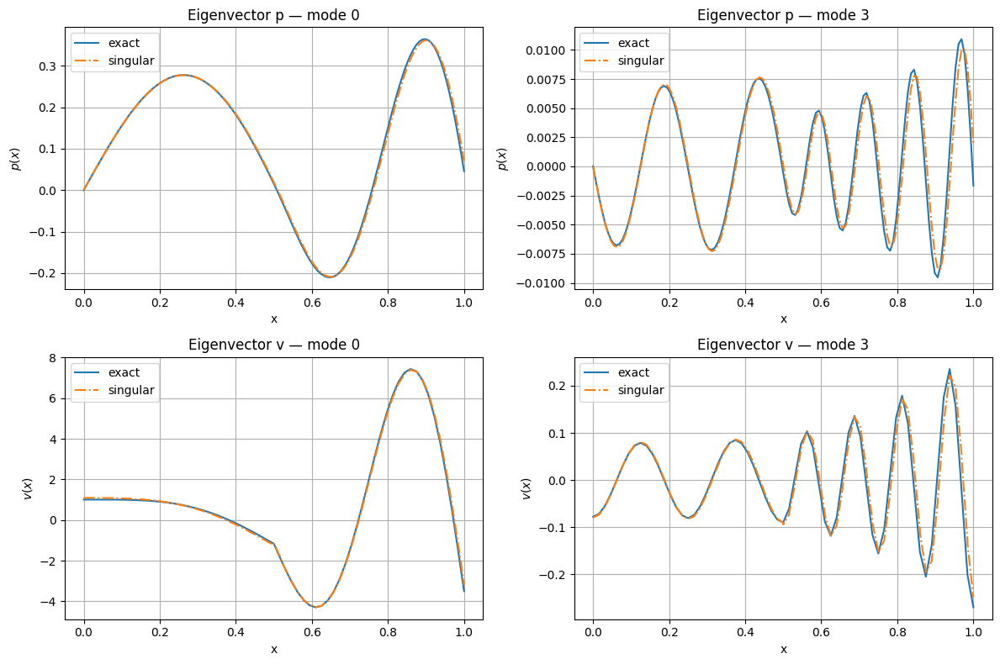

$[Closest] idx=0  \omega=(12.505405133691523-2.1771042506069116j)  \epsilon_r=(0.046454299035555736+0j)$
$[Closest] idx=28  \omega=(49.94767683140313-2.0639926221548928j)  \epsilon_r=(0.22247326683646304+0j)$


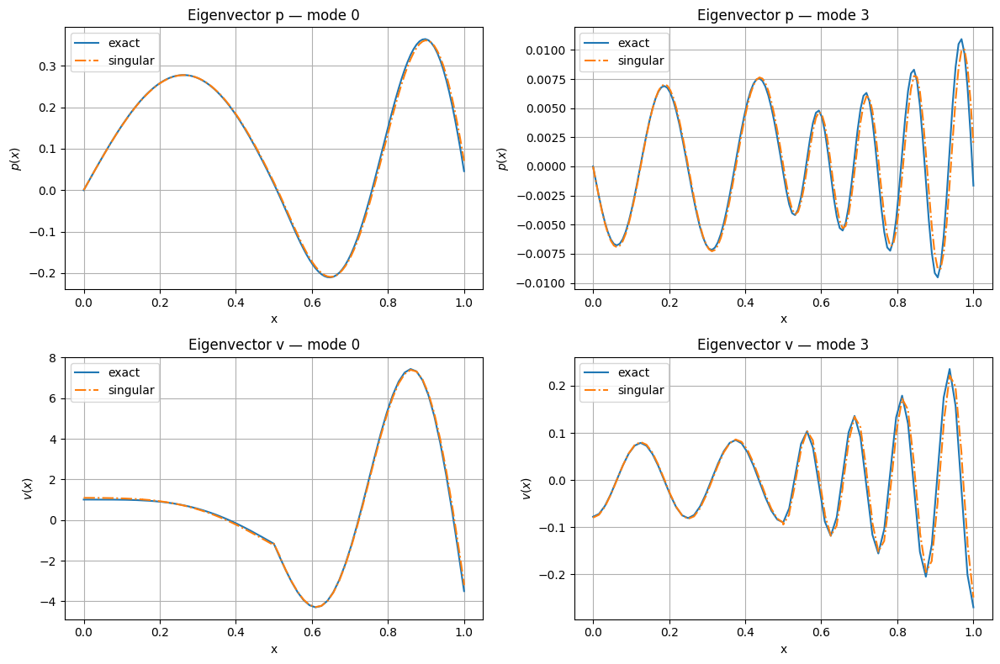

$[Closest] idx=0  \omega=(12.50540875760566-2.177125381055631j)  \epsilon_r=(0.04644883086653692+0j)$
$[Closest] idx=28  \omega=(49.94720333168663-2.0640366352035033j)  \epsilon_r=(0.2227126669556966+0j)$


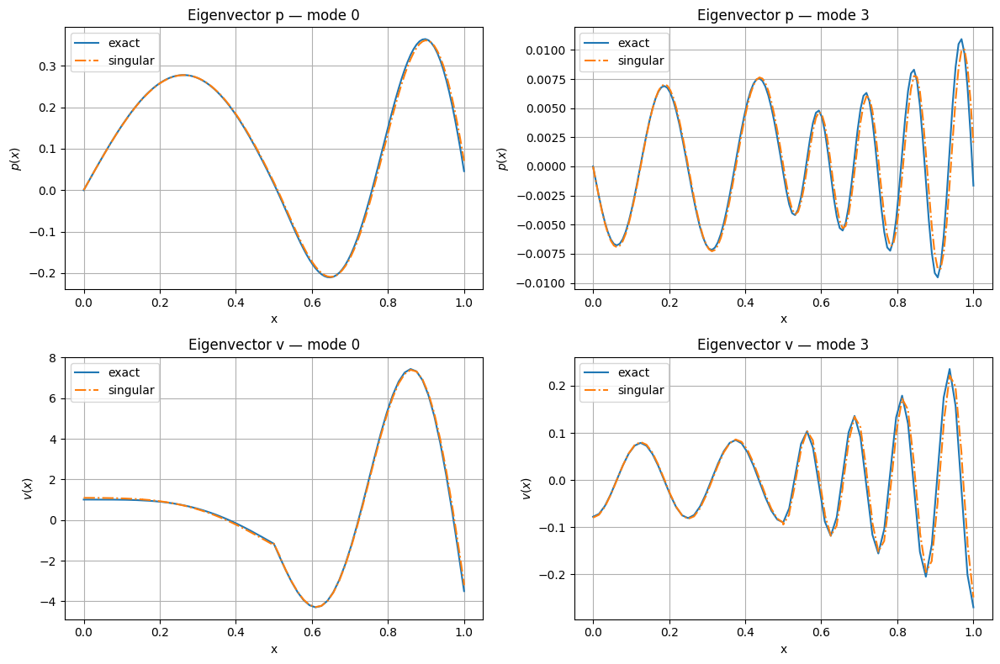

$[Closest] idx=0  \omega=(12.505415175324629-2.1771477203334593j)  \epsilon_r=(0.046441593355142724+0j)$
$[Closest] idx=28  \omega=(49.94672604757088-2.064107702338399j)  \epsilon_r=(0.2229491859531975+0j)$


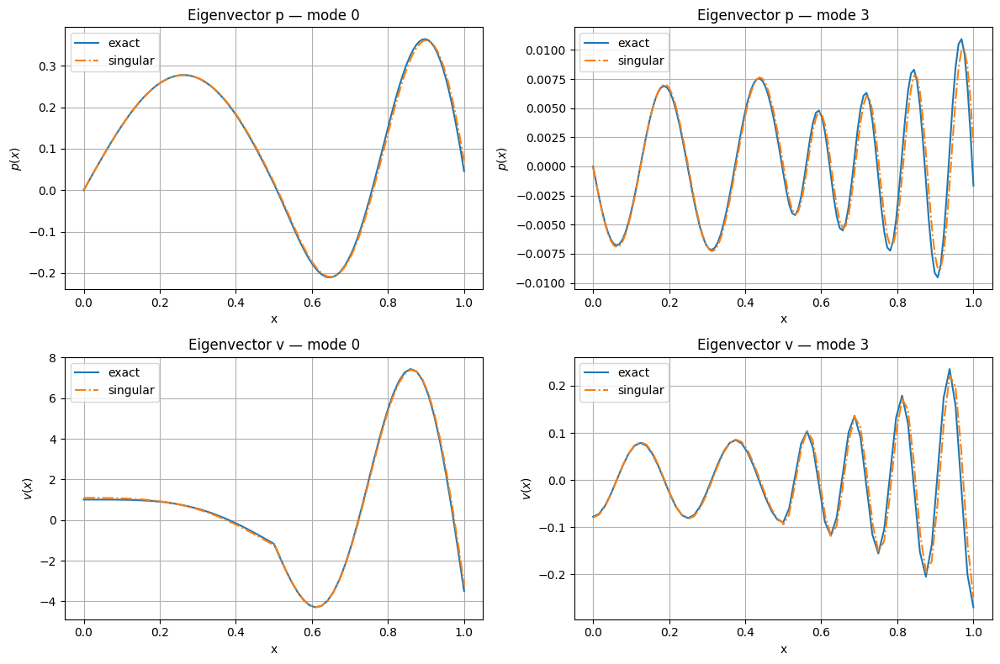

$[Closest] idx=0  \omega=(12.505424697428088-2.177171083757854j)  \epsilon_r=(0.04643244131227589+0j)$
$[Closest] idx=28  \omega=(49.94624602965197-2.064206179751104j)  \epsilon_r=(0.22318222937006582+0j)$


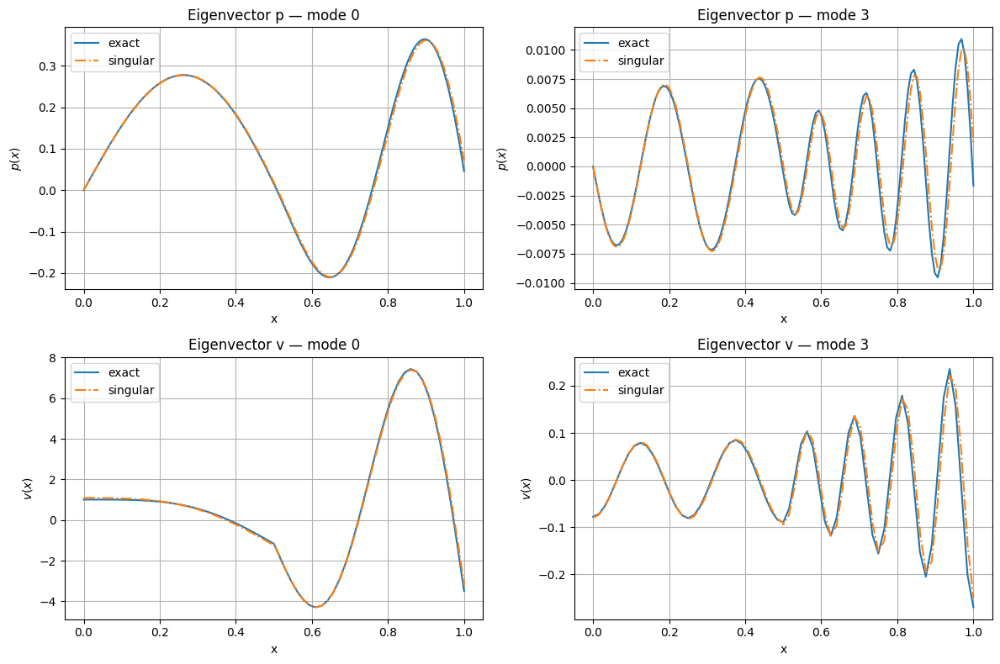

$[Closest] idx=0  \omega=(12.505437626914592-2.1771952655962132j)  \epsilon_r=(0.04642123708883758+0j)$
$[Closest] idx=28  \omega=(49.94576434020711-2.064332400272174j)  \epsilon_r=(0.22341120374142165+0j)$


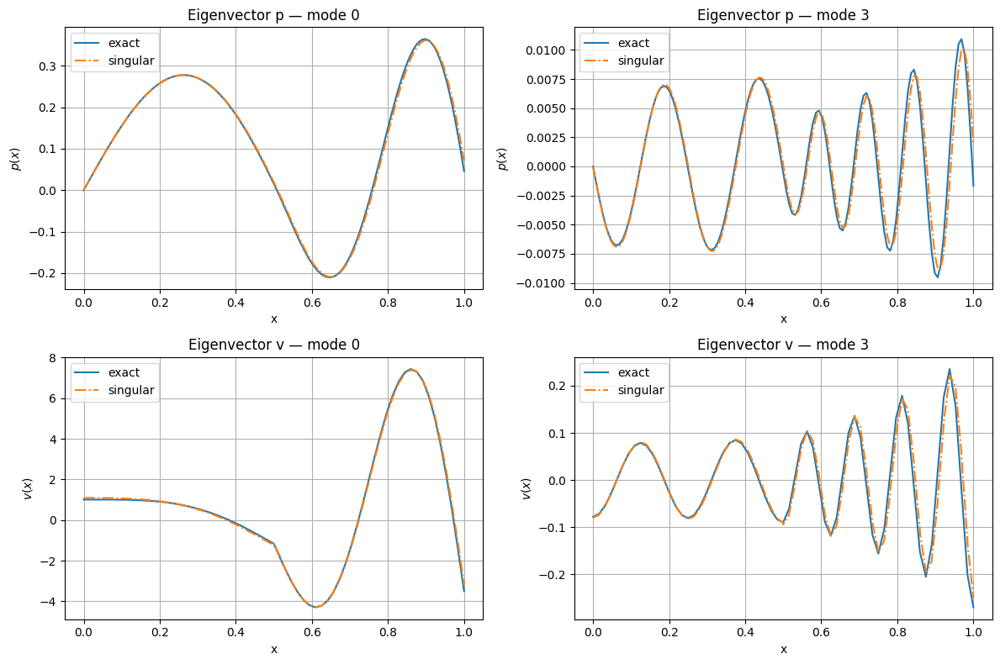

$[Closest] idx=0  \omega=(12.505454262495839-2.1772200381760074j)  \epsilon_r=(0.04640784884787302+0j)$
$[Closest] idx=29  \omega=(49.94528205258167-2.0644866734264076j)  \epsilon_r=(0.2236355168983507+0j)$


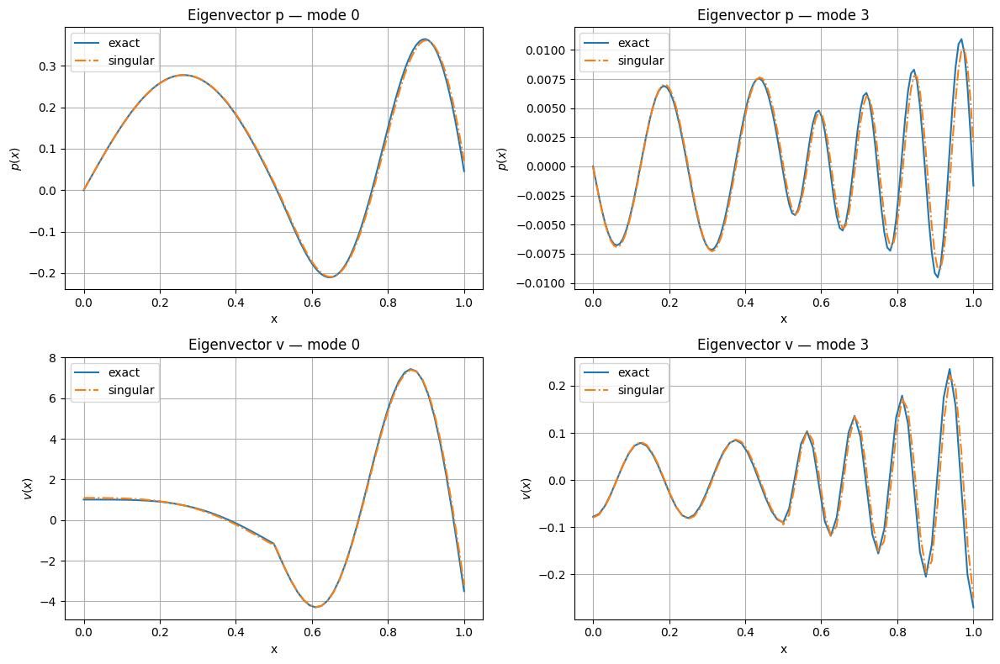

$[Closest] idx=0  \omega=(12.505474900339244-2.1772451517279574j)  \epsilon_r=(0.046392149599706986+0j)$
$[Closest] idx=29  \omega=(49.94480025093353-2.0646692854284296j)  \epsilon_r=(0.22385457808379672+0j)$


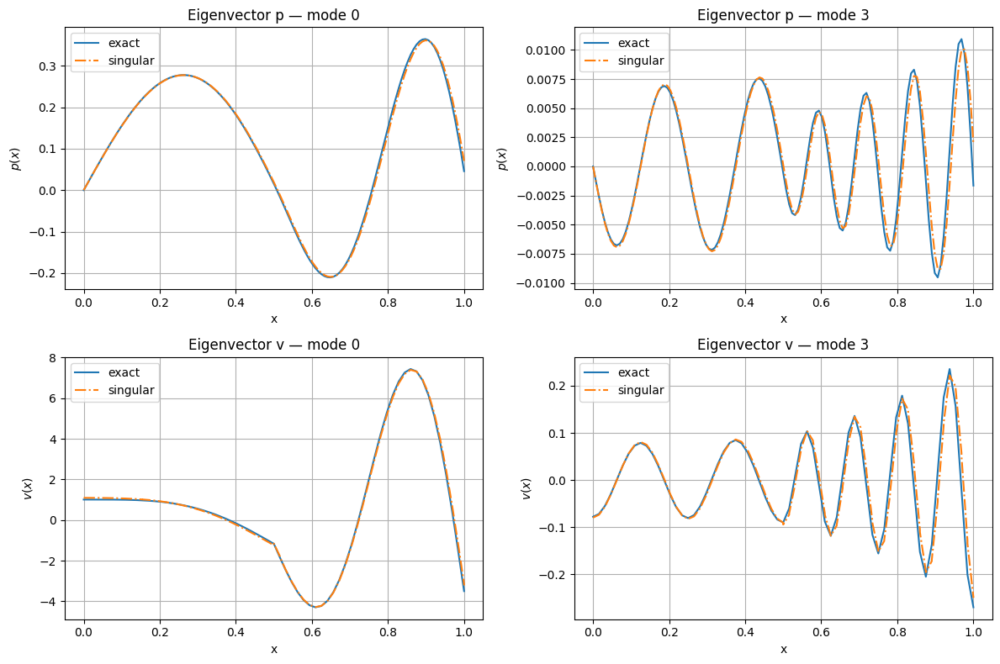

$[Closest] idx=0  \omega=(12.505499834982098-2.1772703344883304j)  \epsilon_r=(0.0463740166709063+0j)$
$[Closest] idx=29  \omega=(49.94432003014764-2.0648804991726792j)  \epsilon_r=(0.22406779797123116+0j)$


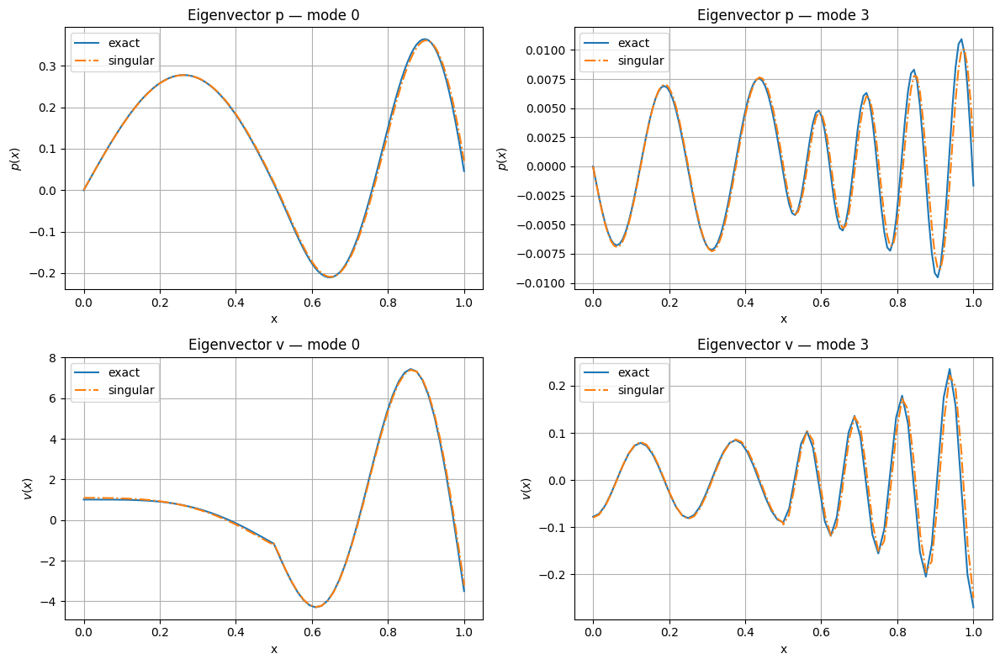

$[Closest] idx=0  \omega=(12.50552935978217-2.177295292897271j)  \epsilon_r=(0.04635333142960174+0j)$
$[Closest] idx=29  \omega=(49.943842495818195-2.0651205542273434j)  \epsilon_r=(0.22427458863690808+0j)$


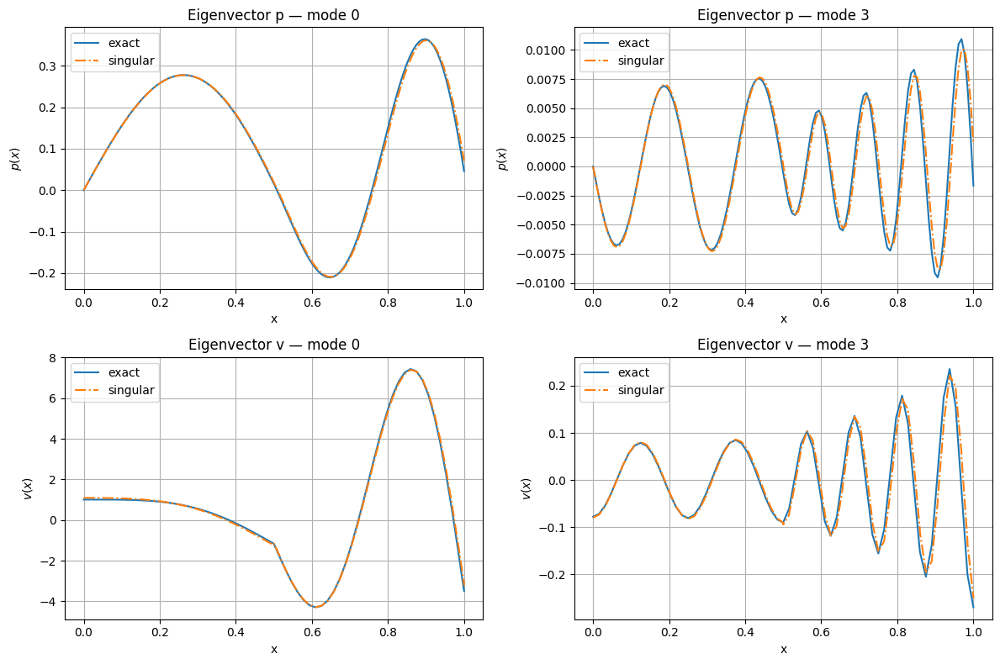

$[Closest] idx=0  \omega=(12.505563767098973-2.1773197118301515j)  \epsilon_r=(0.046329979169782765+0j)$
$[Closest] idx=29  \omega=(49.943368764263894-2.065389666823129j)  \epsilon_r=(0.22447436350604266+0j)$


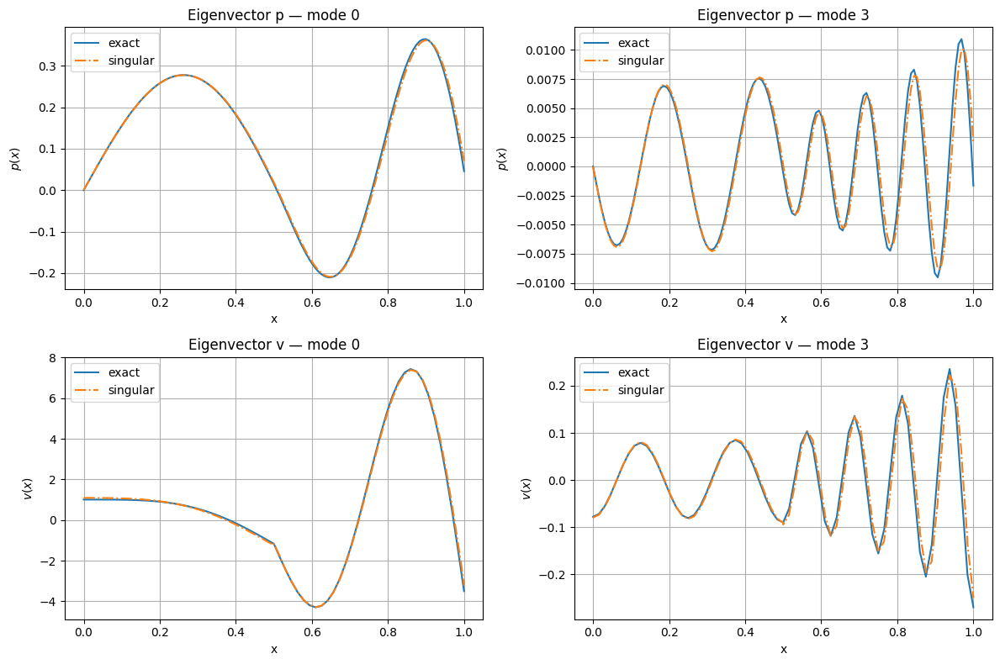

$[Closest] idx=0  \omega=(12.505603348312903-2.177343254839771j)  \epsilon_r=(0.04630384909971523+0j)$
$[Closest] idx=29  \omega=(49.9428999625624-2.065688029831432j)  \epsilon_r=(0.22466653728247246+0j)$


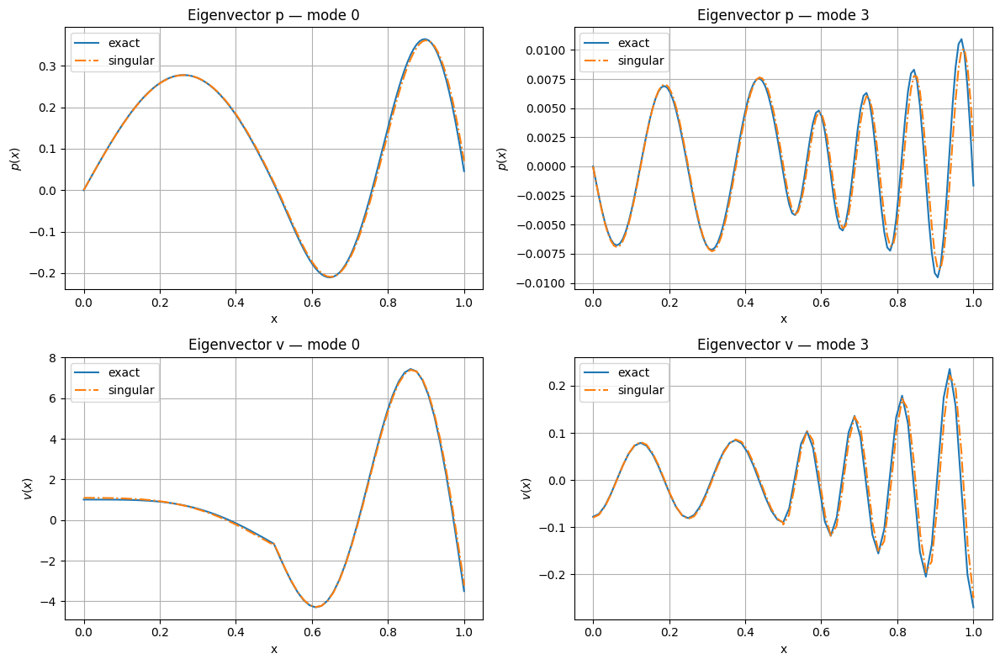

$[Closest] idx=0  \omega=(12.505648393741872-2.1773655644011605j)  \epsilon_r=(0.046274834404333234+0j)$
$[Closest] idx=29  \omega=(49.94243722859831-2.0660158127171635j)  \epsilon_r=(0.22485052586589946+0j)$


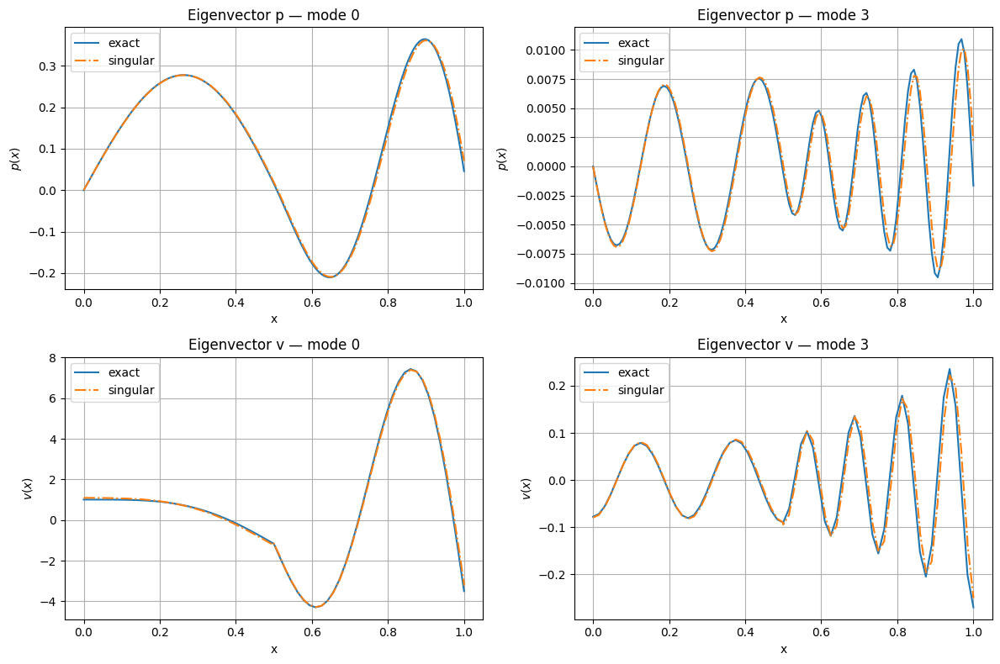

$[Closest] idx=0  \omega=(12.505699192493362-2.1773862621604976j)  \epsilon_r=(0.04624283236221926+0j)$
$[Closest] idx=29  \omega=(49.941981711127895-2.0663731614696936j)  \epsilon_r=(0.22502574625664137+0j)$


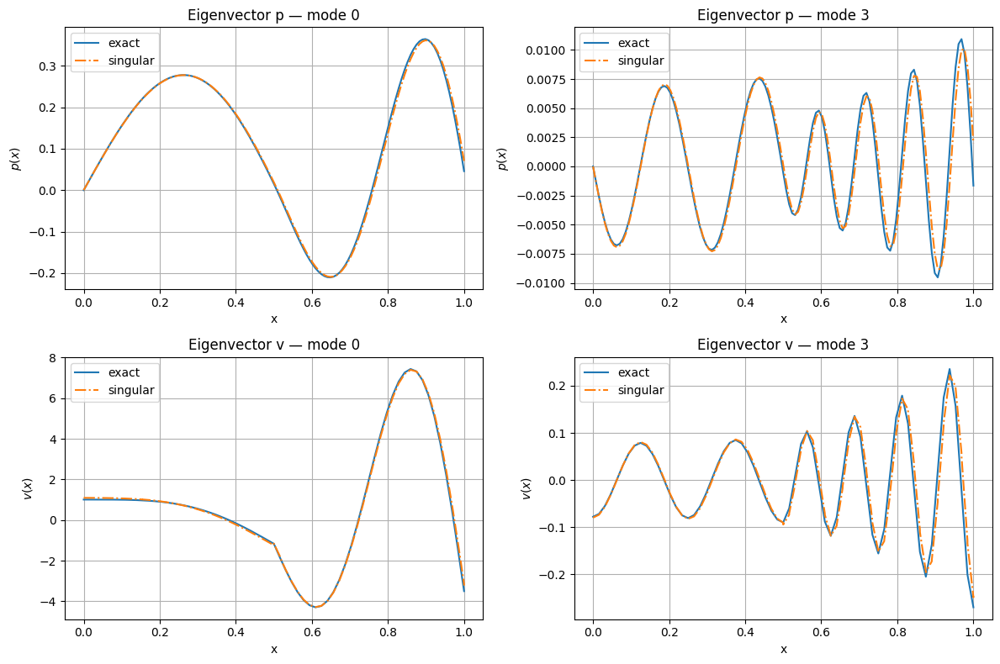

$[Closest] idx=0  \omega=(12.505756032269392-2.1774049491867244j)  \epsilon_r=(0.046207744509908666+0j)$
$[Closest] idx=30  \omega=(49.941534569848-2.066760198500216j)  \epsilon_r=(0.22519161645392027+0j)$


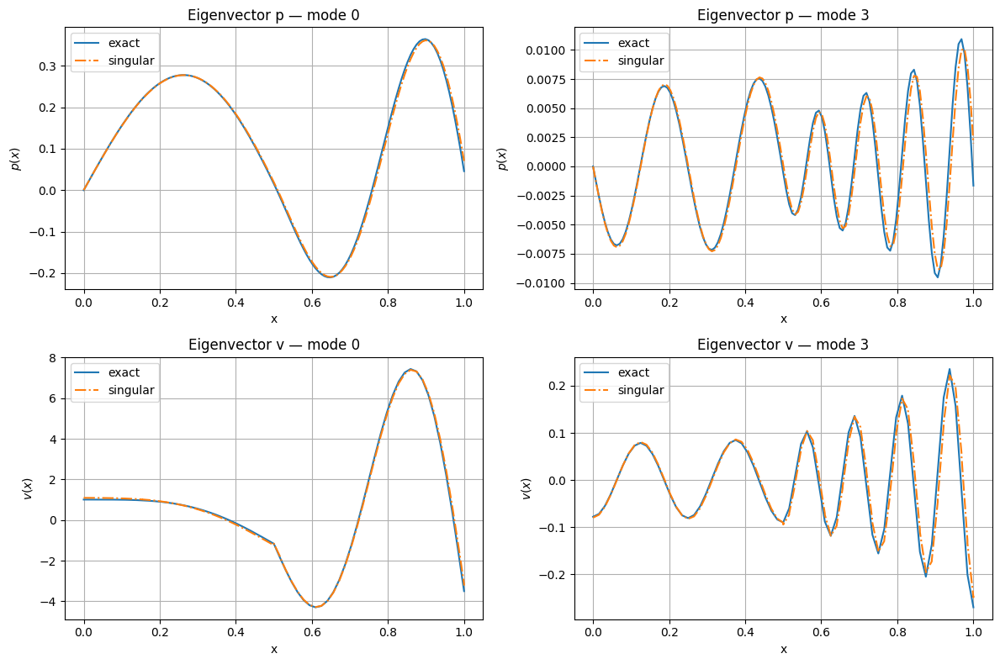

$[Closest] idx=0  \omega=(12.50581919914109-2.177421206231736j)  \epsilon_r=(0.04616947684559973+0j)$
$[Closest] idx=30  \omega=(49.94109697548874-2.0671770225141484j)  \epsilon_r=(0.2253475553405903+0j)$


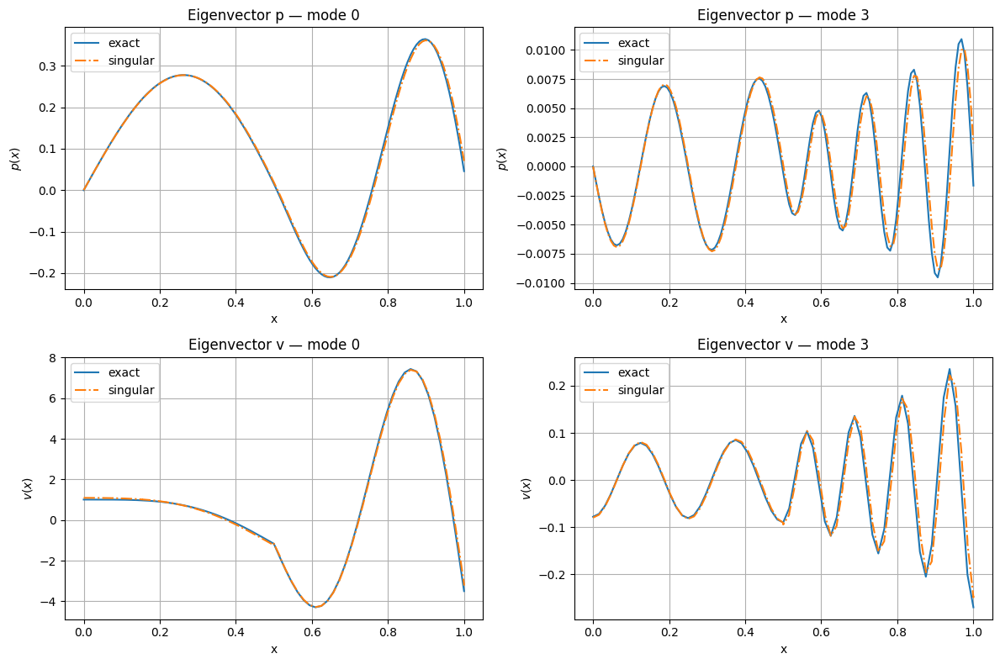

$[Closest] idx=0  \omega=(12.5058889772978-2.1774345939990005j)  \epsilon_r=(0.04612794007210189+0j)$
$[Closest] idx=29  \omega=(49.940670109903934-2.0676237083463134j)  \epsilon_r=(0.22549298256388506+0j)$


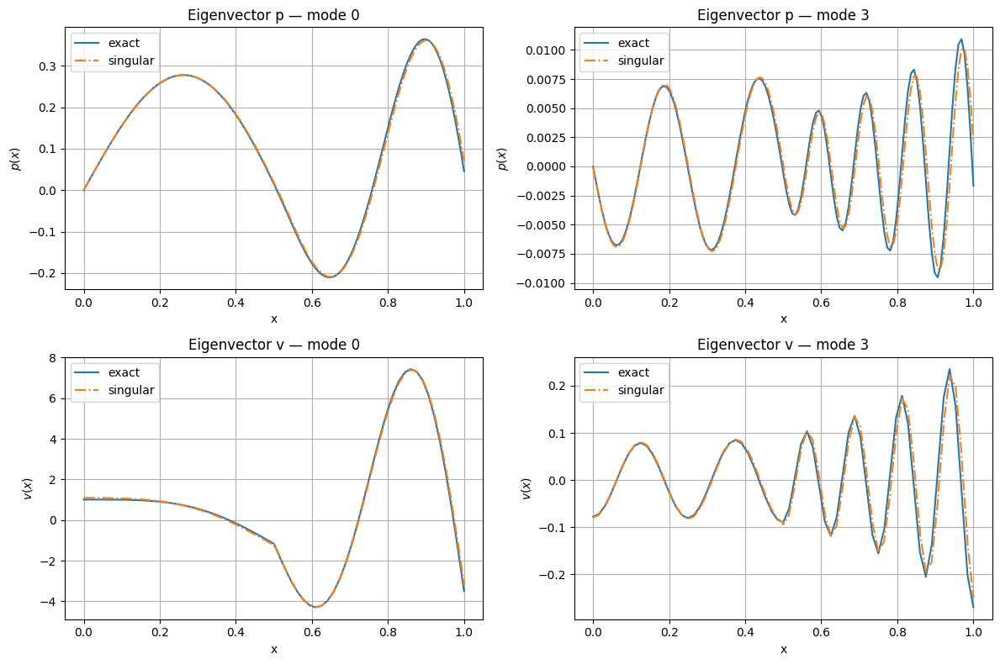

$[Closest] idx=0  \omega=(12.505965648778206-2.177444653424594j)  \epsilon_r=(0.04608304987683999+0j)$
$[Closest] idx=29  \omega=(49.94025516618096-2.0681003067622954j)  \epsilon_r=(0.22562731840666256+0j)$


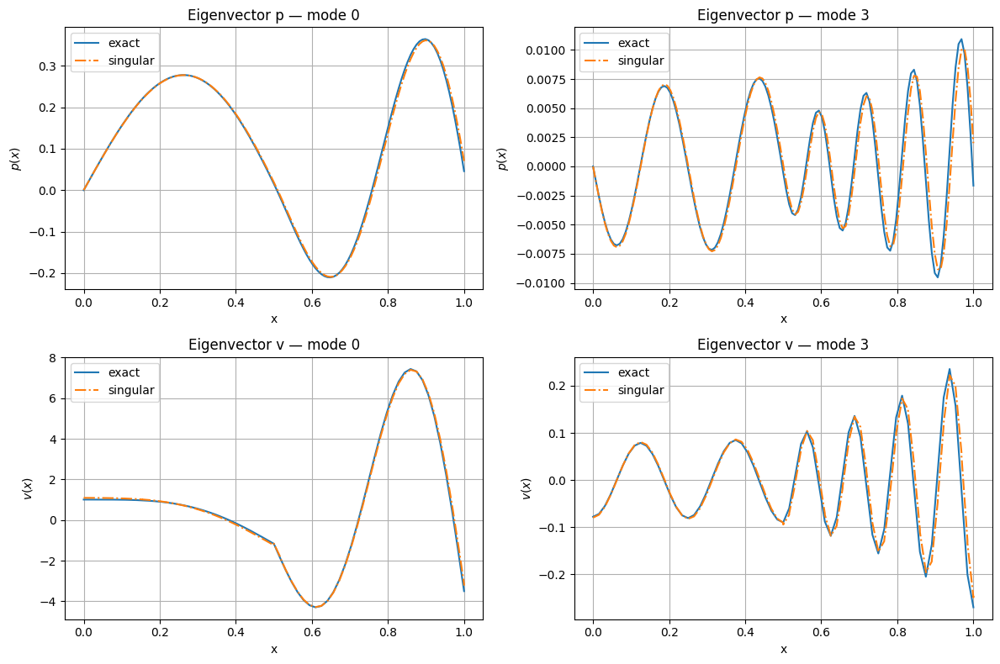

$[Closest] idx=0  \omega=(12.506049493185108-2.1774509059716154j)  \epsilon_r=(0.04603472725061636+0j)$
$[Closest] idx=29  \omega=(49.93985334875577-2.068606844226639j)  \epsilon_r=(0.22574998365279483+0j)$


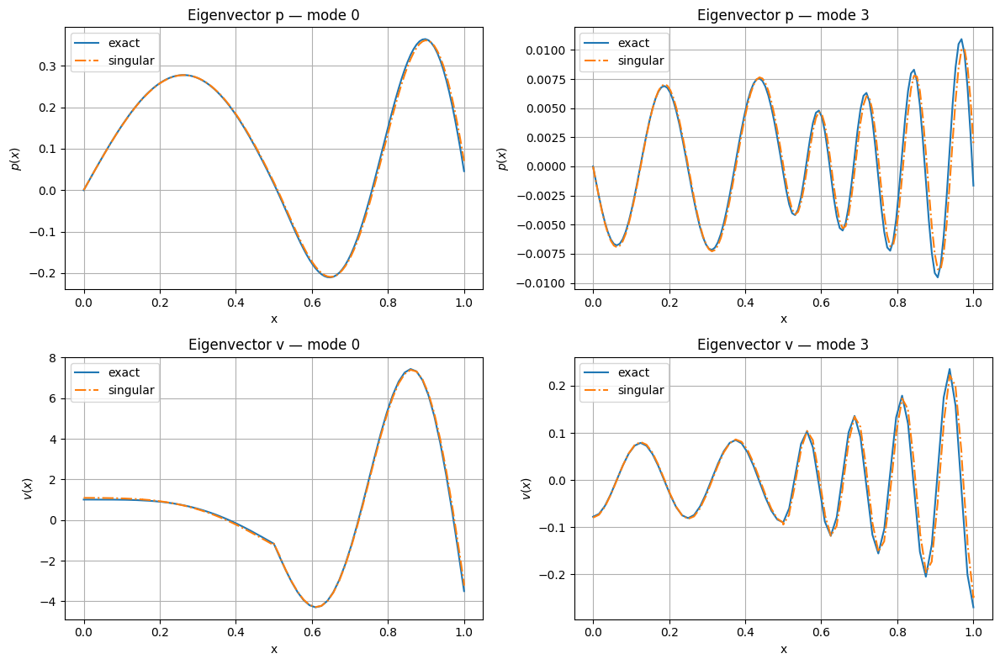

$[Closest] idx=0  \omega=(12.506140787386856-2.177452853939991j)  \epsilon_r=(0.04598289884601807+0j)$
$[Closest] idx=29  \omega=(49.93946587353104-2.069143322630879j)  \epsilon_r=(0.22586039944959238+0j)$


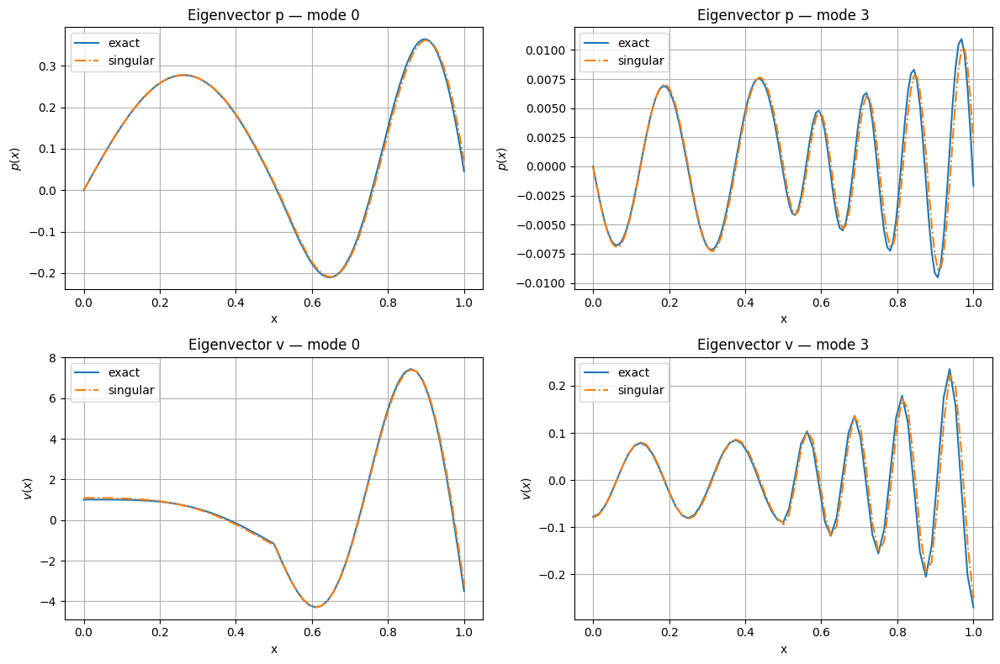

$[Closest] idx=0  \omega=(12.506239805207036-2.177449980793398j)  \epsilon_r=(0.04592749737724354+0j)$
$[Closest] idx=29  \omega=(49.93909396800212-2.069709718982493j)  \epsilon_r=(0.2259579871652397+0j)$


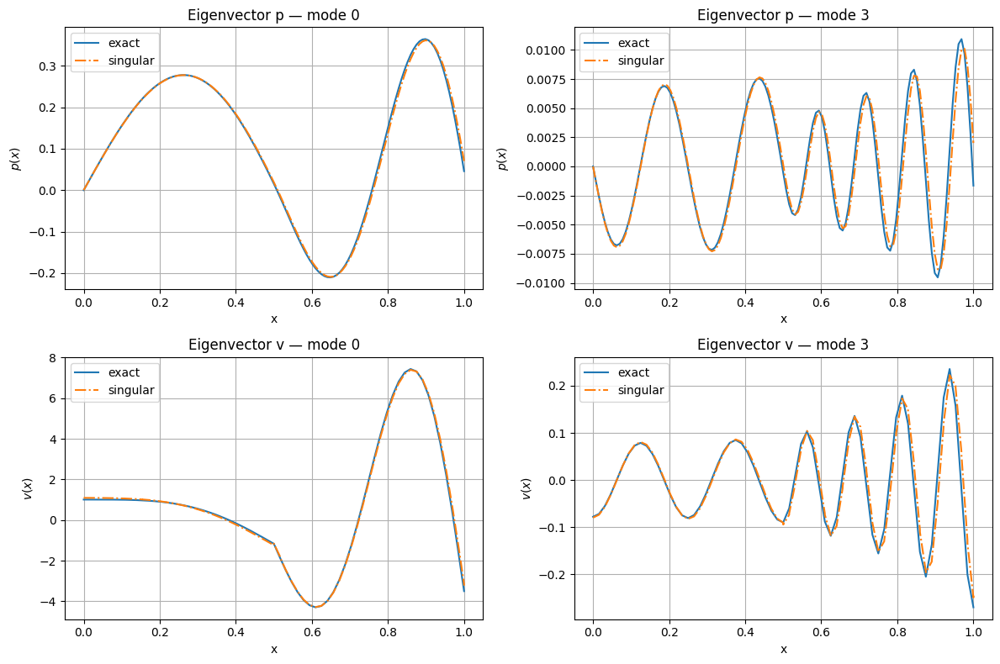

$[Closest] idx=0  \omega=(12.506346817103017-2.1774417515048254j)  \epsilon_r=(0.045868462063868354+0j)$
$[Closest] idx=29  \omega=(49.93873887138745-2.0703059850537944j)  \epsilon_r=(0.22604216824310994+0j)$


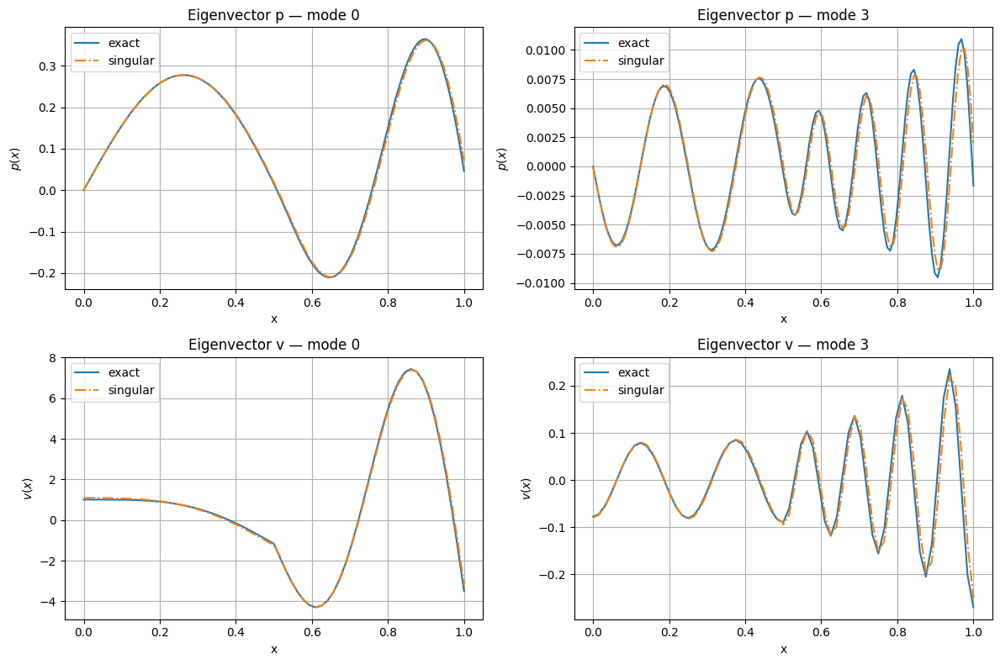

$[Closest] idx=0  \omega=(12.506462089834391-2.1774276129204613j)  \epsilon_r=(0.04580573912117325+0j)$
$[Closest] idx=29  \omega=(49.938401834755226-2.070932046985503j)  \epsilon_r=(0.2261123640573114+0j)$


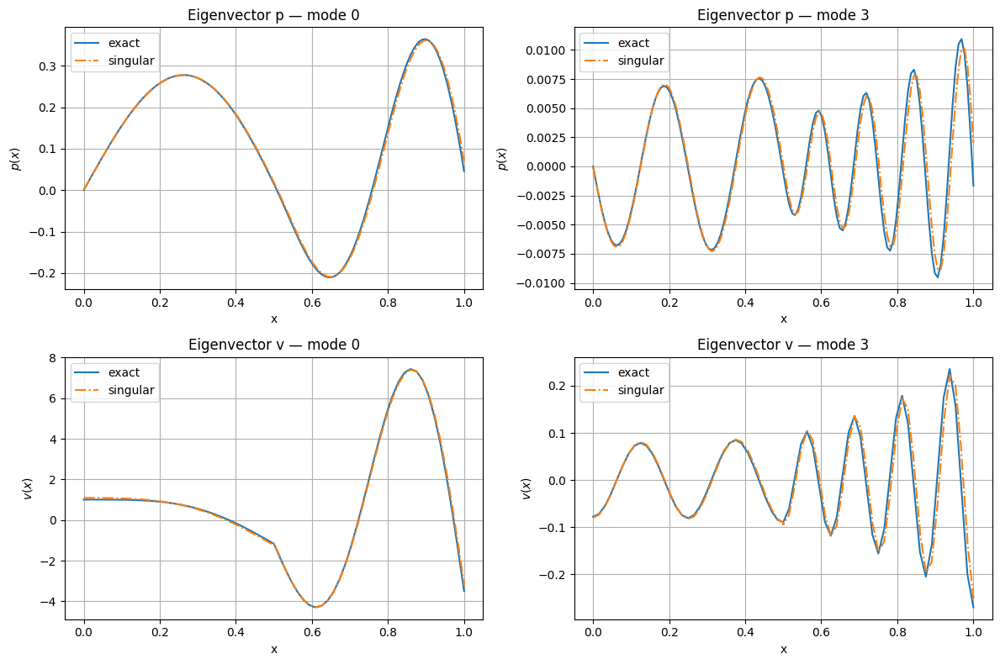

$[Closest] idx=0  \omega=(12.5065858861219-2.1774069941451026j)  \epsilon_r=(0.04573928229942399+0j)$
$[Closest] idx=29  \omega=(49.93808412115699-2.071587804846783j)  \epsilon_r=(0.22616799576464958+0j)$


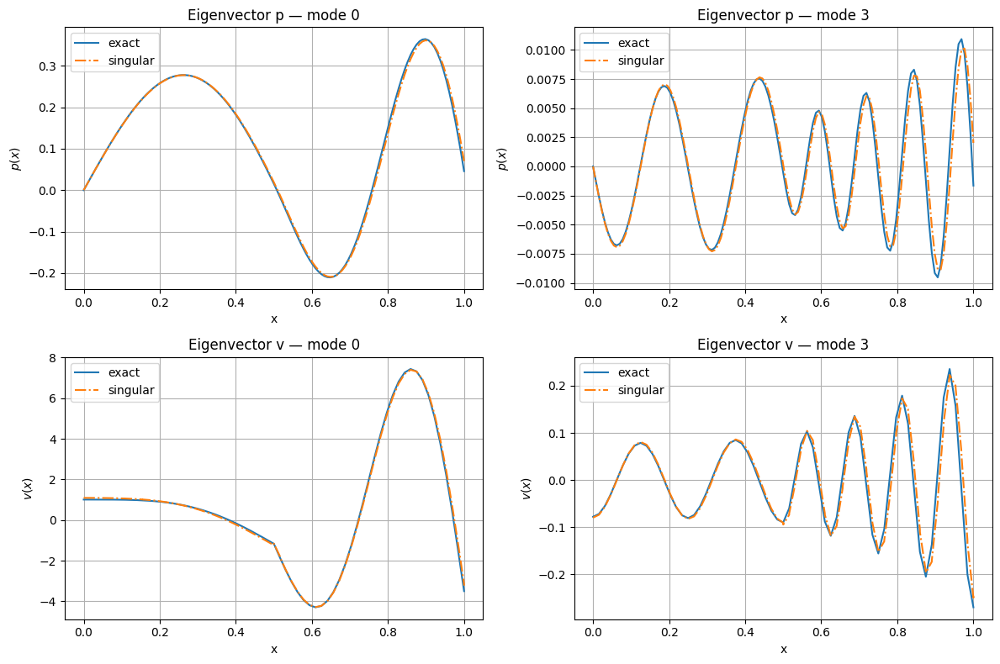

$[Closest] idx=0  \omega=(12.50671846429734-2.177379306948804j)  \epsilon_r=(0.04566905347519719+0j)$
$[Closest] idx=29  \omega=(49.93778700574694-2.0722731321465386j)  \epsilon_r=(0.2262084841627764+0j)$


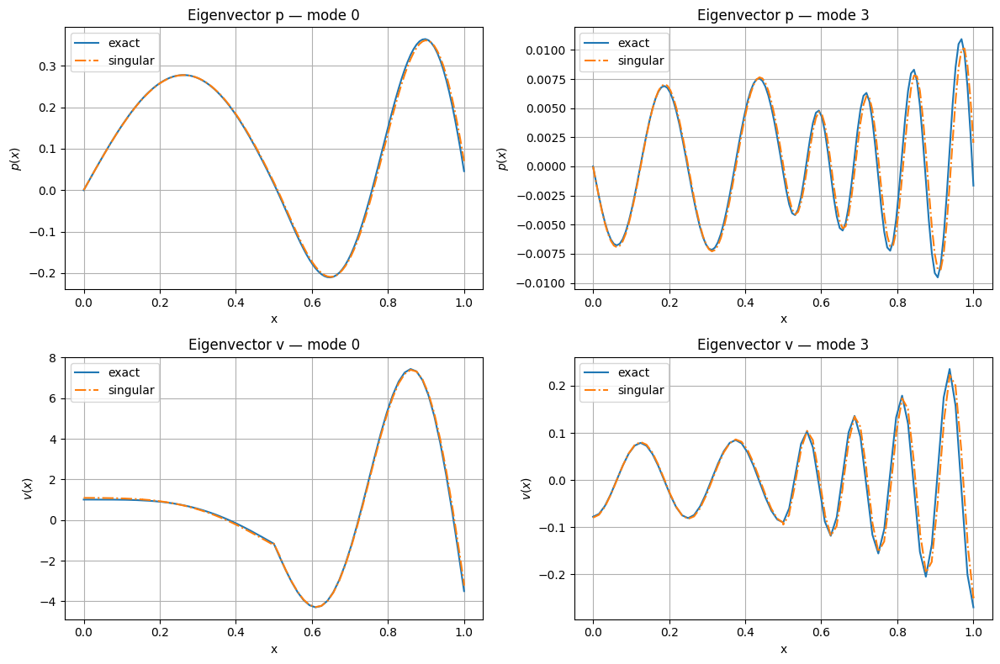

$[Closest] idx=0  \omega=(12.50686007794505-2.177343946195073j)  \epsilon_r=(0.045595023297732955+0j)$
$[Closest] idx=29  \omega=(49.93751177590943-2.0729878752960413j)  \epsilon_r=(0.22623324954593693+0j)$


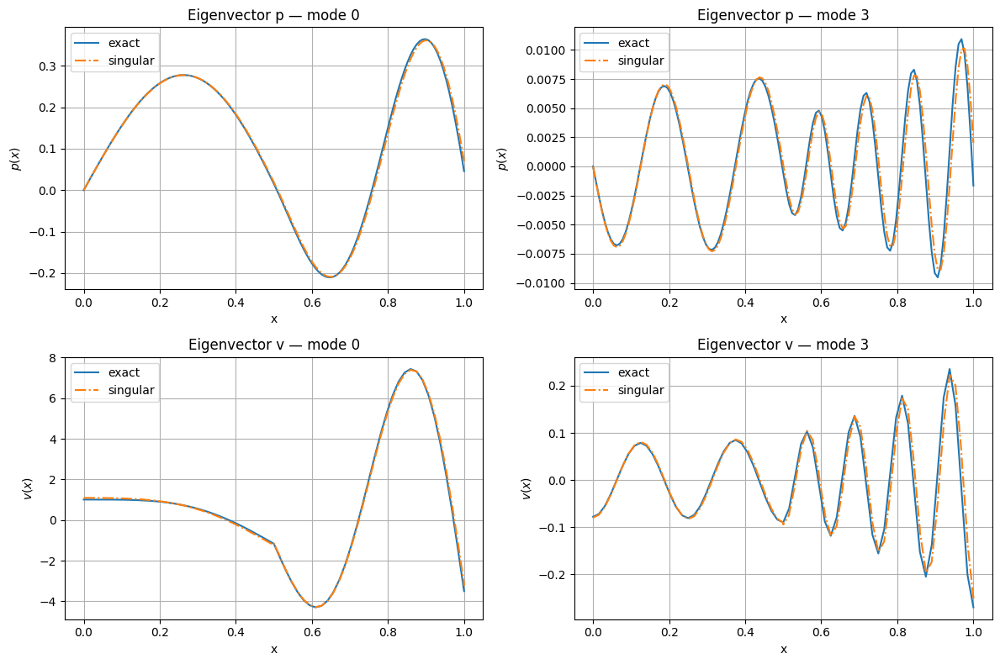

$[Closest] idx=0  \omega=(12.507010975535398-2.1773002902929206j)  \epsilon_r=(0.04551717189313736+0j)$
$[Closest] idx=29  \omega=(49.9372597313659-2.073731853019301j)  \epsilon_r=(0.22624171156901512+0j)$


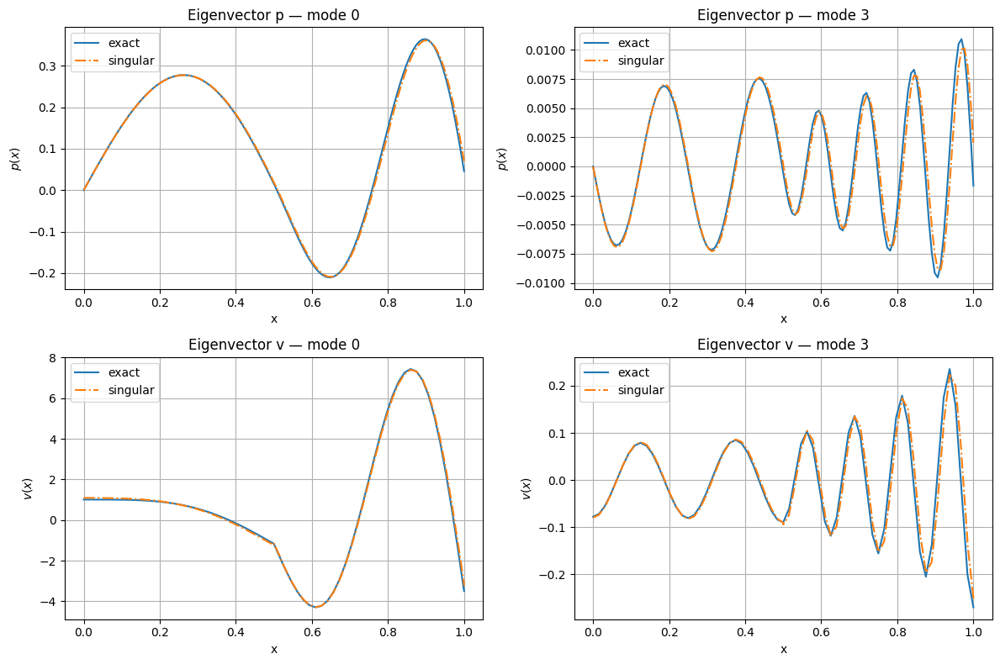

$[Closest] idx=0  \omega=(12.507171400050746-2.1772477016726164j)  \epsilon_r=(0.045435489629640016+0j)$
$[Closest] idx=29  \omega=(49.937032184281755-2.0745048557099404j)  \epsilon_r=(0.2262332891144584+0j)$


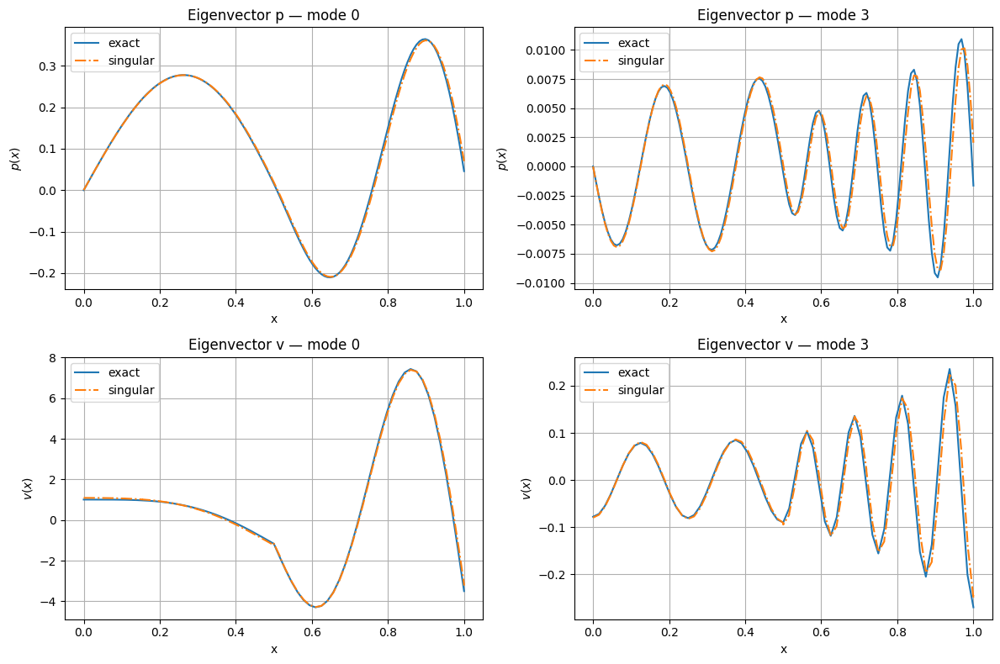


=== Executando para N = 4, h = 0.0078125 ===
$[Closest] idx=0  \omega=(12.54361787315485-2.129698919623079j)  \epsilon_r=(0.04504758655508759+0j)$
$[Closest] idx=26  \omega=(50.16216881688146-2.1108247659639514j)  \epsilon_r=(0.08598781694666086+0j)$


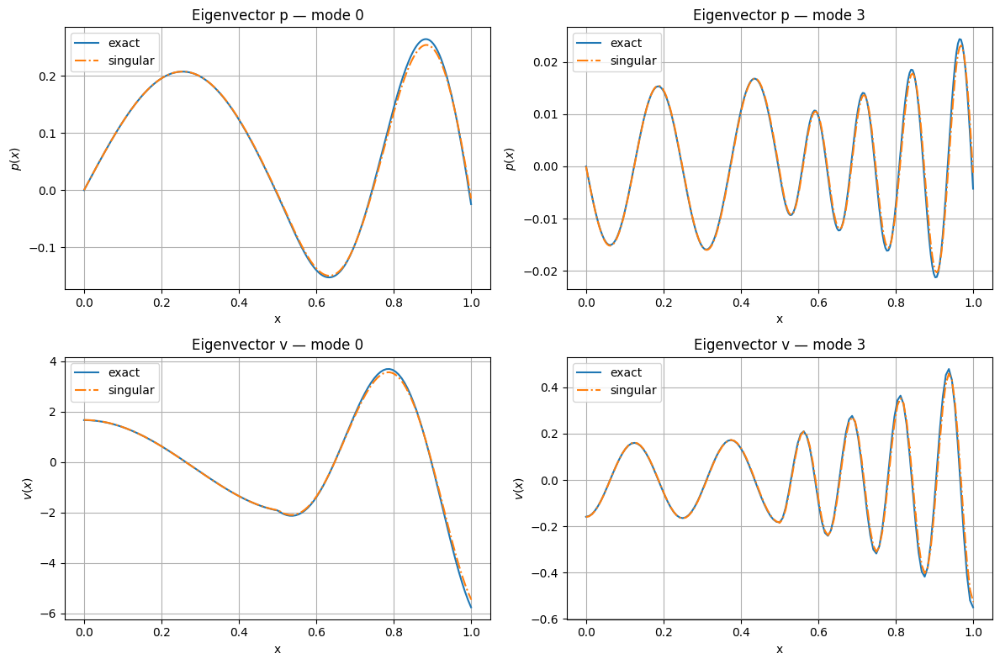

$[Closest] idx=0  \omega=(12.536216453318772-2.189724332158627j)  \epsilon_r=(0.022630710239721914+0j)$
$[Closest] idx=28  \omega=(50.13483952201318-2.1578713167339116j)  \epsilon_r=(0.08941665186603323+0j)$


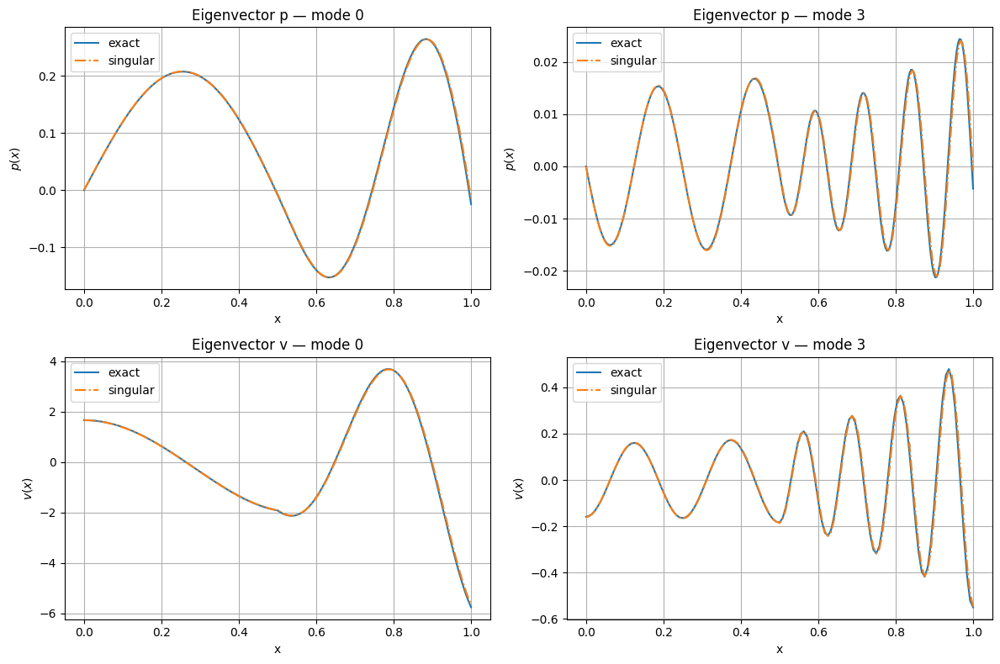

$[Closest] idx=0  \omega=(12.535575194751464-2.1894466343068943j)  \epsilon_r=(0.023034107613649366+0j)$
$[Closest] idx=28  \omega=(50.13264366598982-2.1564675871340953j)  \epsilon_r=(0.0907363073548994+0j)$


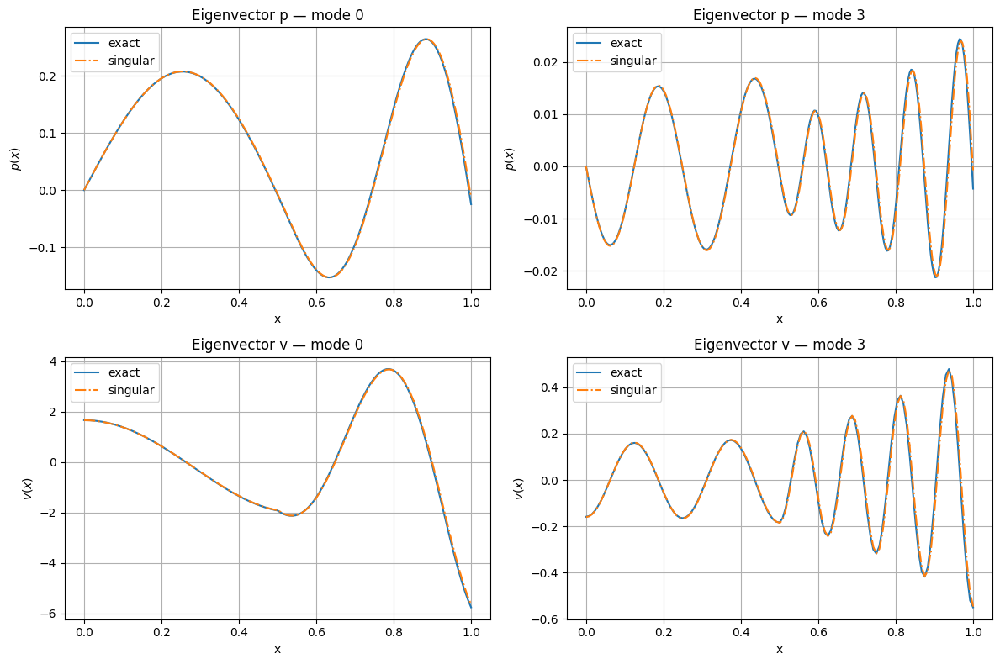

$[Closest] idx=0  \omega=(12.53553109725538-2.189477950228908j)  \epsilon_r=(0.023055306722898437+0j)$
$[Closest] idx=28  \omega=(50.13240319372813-2.156482199211611j)  \epsilon_r=(0.0908594713488422+0j)$


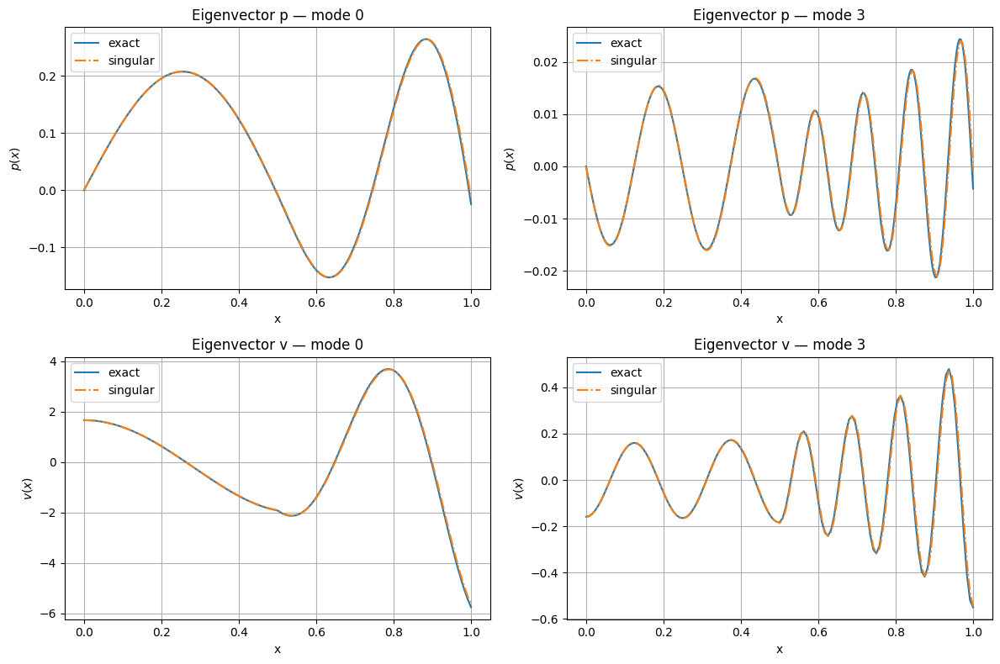

$[Closest] idx=0  \omega=(12.535543731936396-2.1894761398360933j)  \epsilon_r=(0.02304829888418556+0j)$
$[Closest] idx=28  \omega=(50.132393366320656-2.156517671306438j)  \epsilon_r=(0.09086003613760671+0j)$


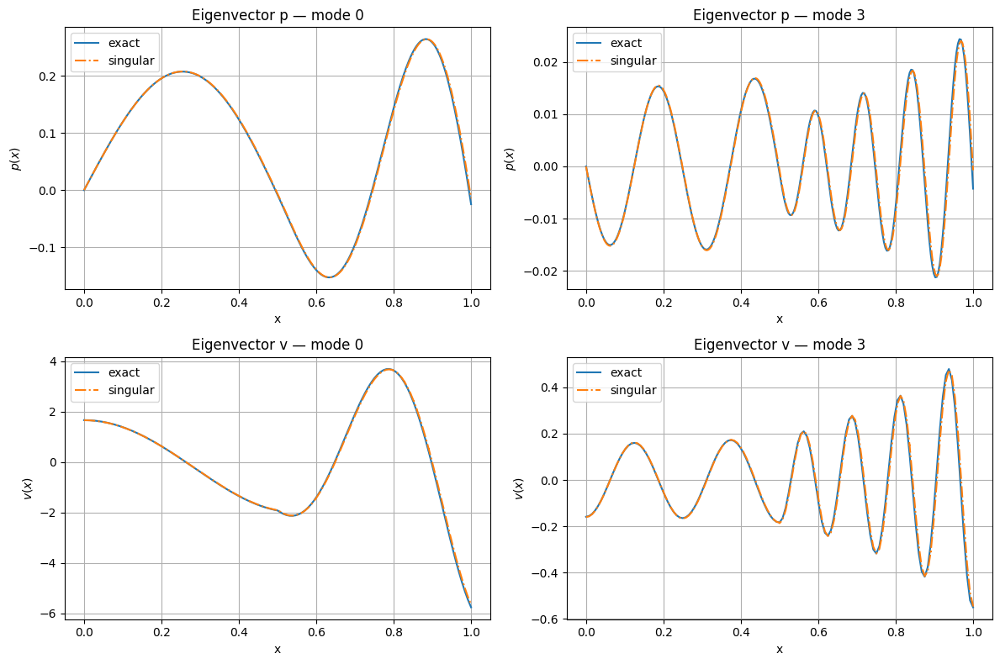

$[Closest] idx=0  \omega=(12.535550888602508-2.189463407100228j)  \epsilon_r=(0.023045852643115913+0j)$
$[Closest] idx=28  \omega=(50.132381142395246-2.156518998069987j)  \epsilon_r=(0.0908662232144581+0j)$


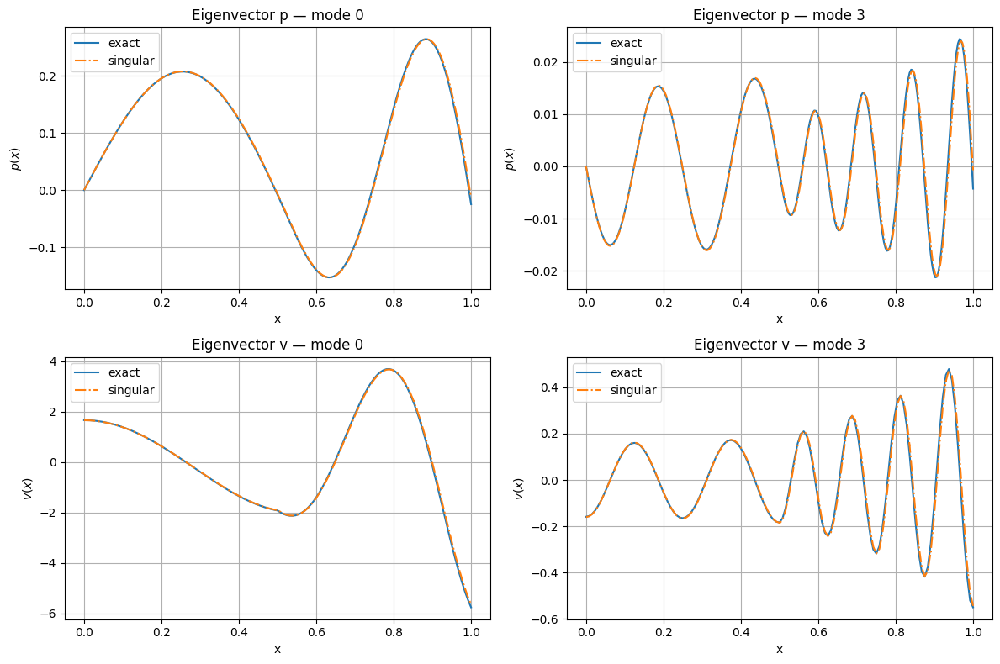

$[Closest] idx=0  \omega=(12.535553045899277-2.1894580711161495j)  \epsilon_r=(0.023045310967486708+0j)$
$[Closest] idx=28  \omega=(50.13235674287685-2.156517347372724j)  \epsilon_r=(0.09087912368483456+0j)$


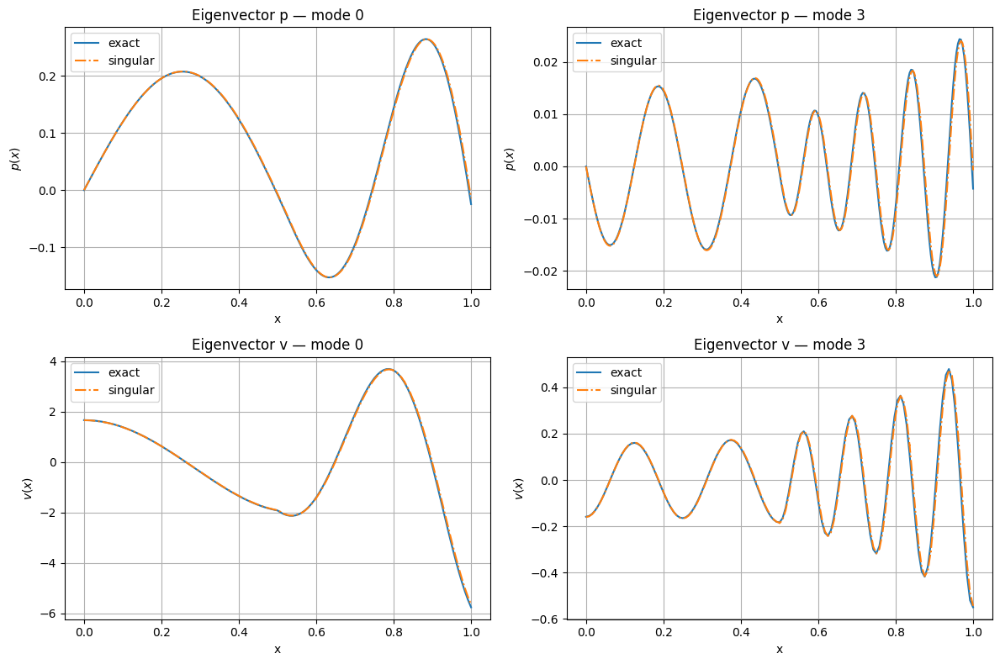

$[Closest] idx=0  \omega=(12.53555343730819-2.189456915955996j)  \epsilon_r=(0.023045237110485003+0j)$
$[Closest] idx=28  \omega=(50.13232782831768-2.1565177829028803j)  \epsilon_r=(0.0908941053008893+0j)$


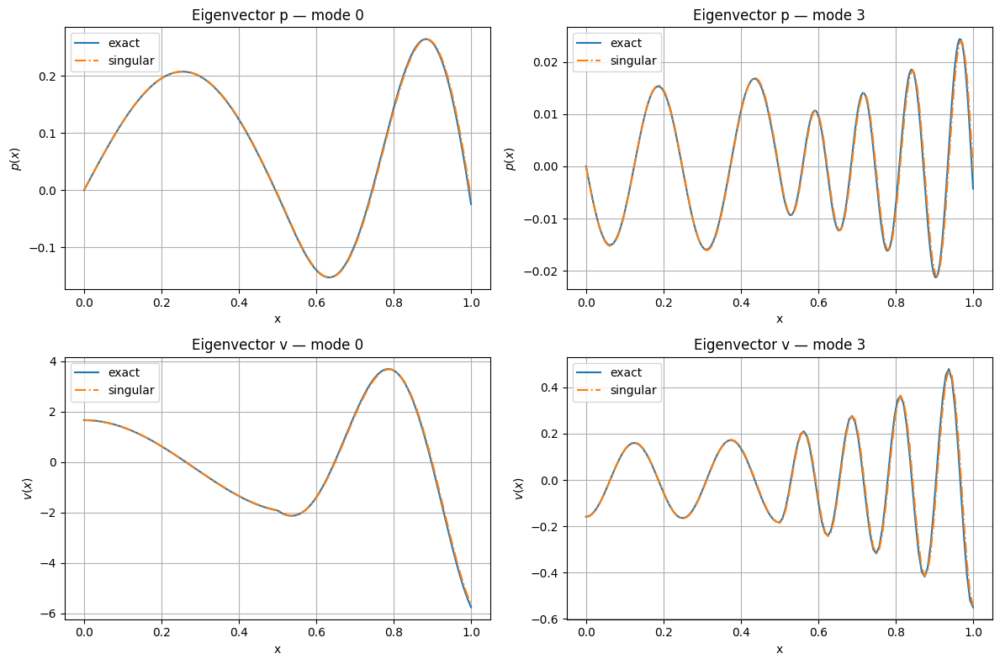

$[Closest] idx=0  \omega=(12.535553328024971-2.1894571805698972j)  \epsilon_r=(0.023045265274308877+0j)$
$[Closest] idx=28  \omega=(50.13229764973178-2.1565202321591186j)  \epsilon_r=(0.09090948681353161+0j)$


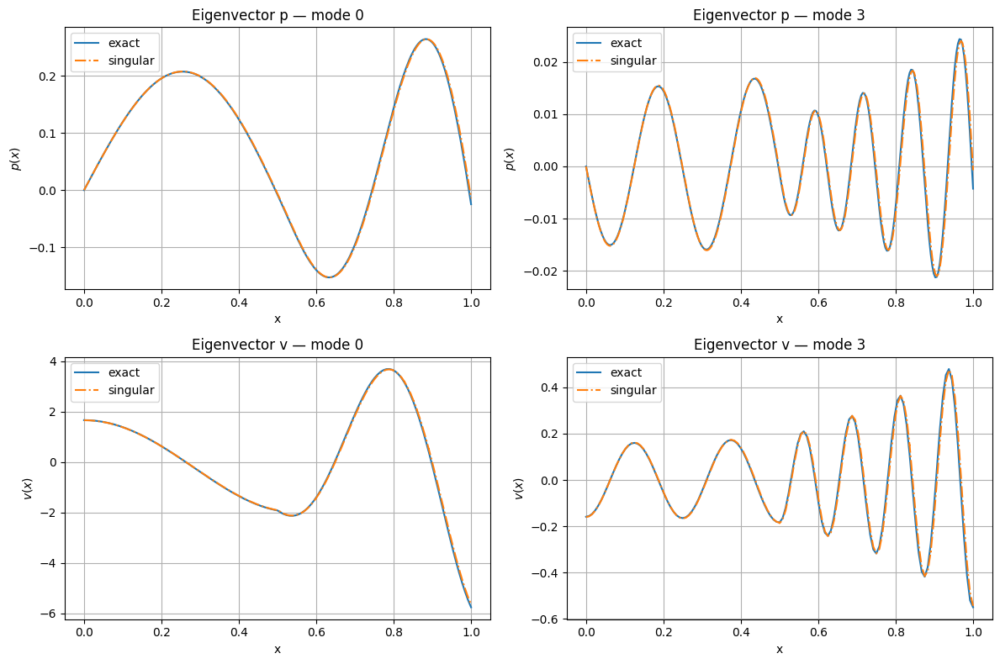

$[Closest] idx=0  \omega=(12.535553110510927-2.1894579095024533j)  \epsilon_r=(0.02304529498647641+0j)$
$[Closest] idx=28  \omega=(50.13226712953424-2.156524493476713j)  \epsilon_r=(0.09092481449252549+0j)$


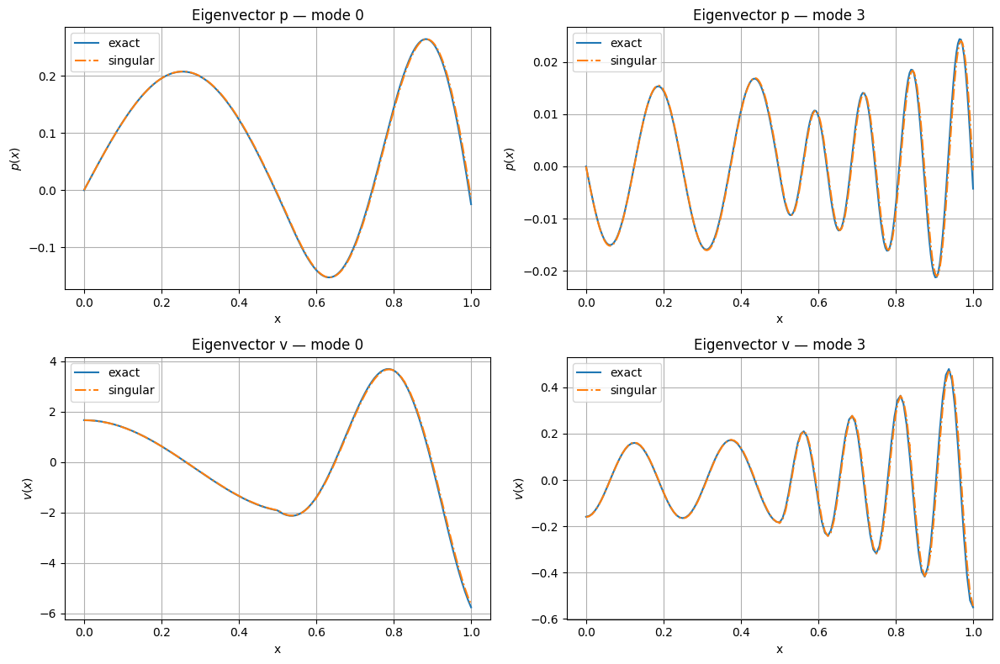

$[Closest] idx=0  \omega=(12.535552915372545-2.1894588396919707j)  \epsilon_r=(0.02304528566706566+0j)$
$[Closest] idx=28  \omega=(50.132236526674525-2.15653052288672j)  \epsilon_r=(0.09093995946725608+0j)$


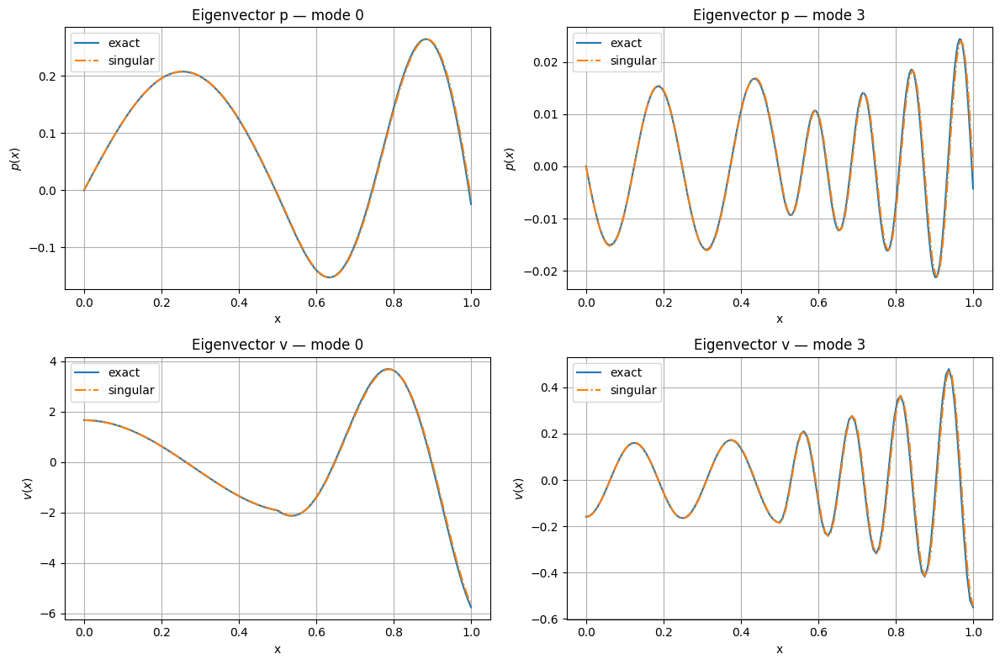

$[Closest] idx=0  \omega=(12.5355527994836-2.189459899522247j)  \epsilon_r=(0.023045214052484886+0j)$
$[Closest] idx=28  \omega=(50.132205947867945-2.156538324689597j)  \epsilon_r=(0.090954865883167+0j)$


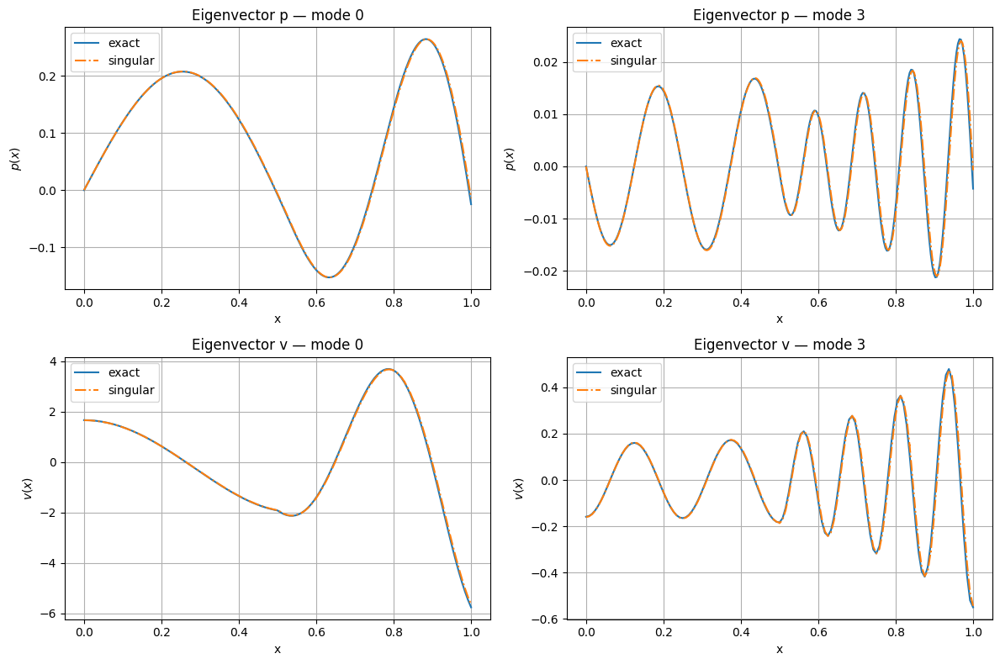

$[Closest] idx=0  \omega=(12.535552796858996-2.189461064501017j)  \epsilon_r=(0.023045063840591837+0j)$
$[Closest] idx=28  \omega=(50.132175468916806-2.1565479093520086j)  \epsilon_r=(0.09096949320048847+0j)$


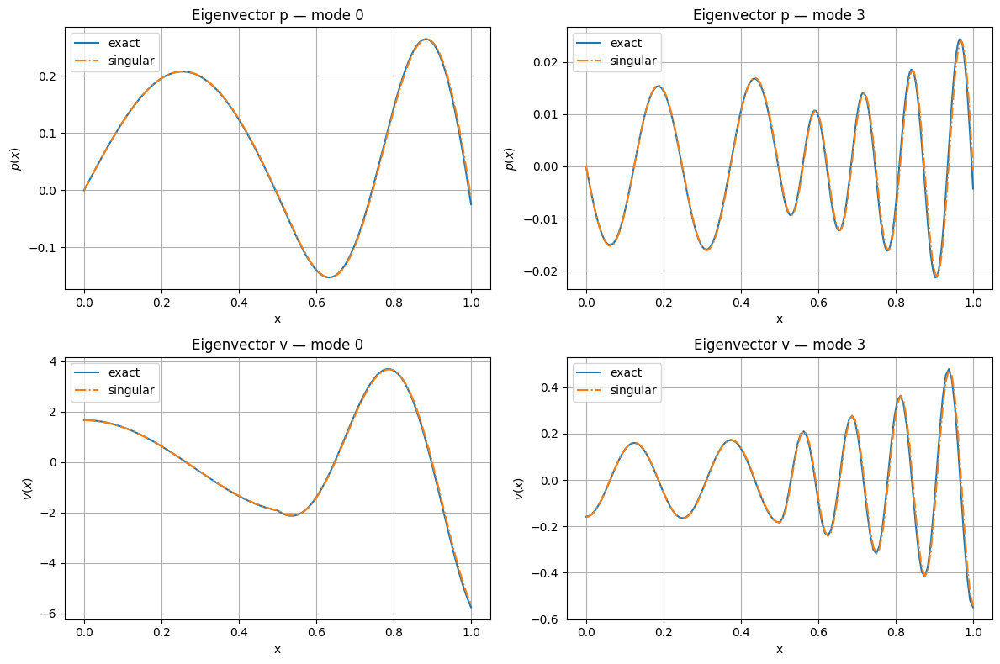

$[Closest] idx=0  \omega=(12.535552933074248-2.1894623212291413j)  \epsilon_r=(0.02304482212051933+0j)$
$[Closest] idx=28  \omega=(50.13214516011693-2.156559285486902j)  \epsilon_r=(0.09098380400726154+0j)$


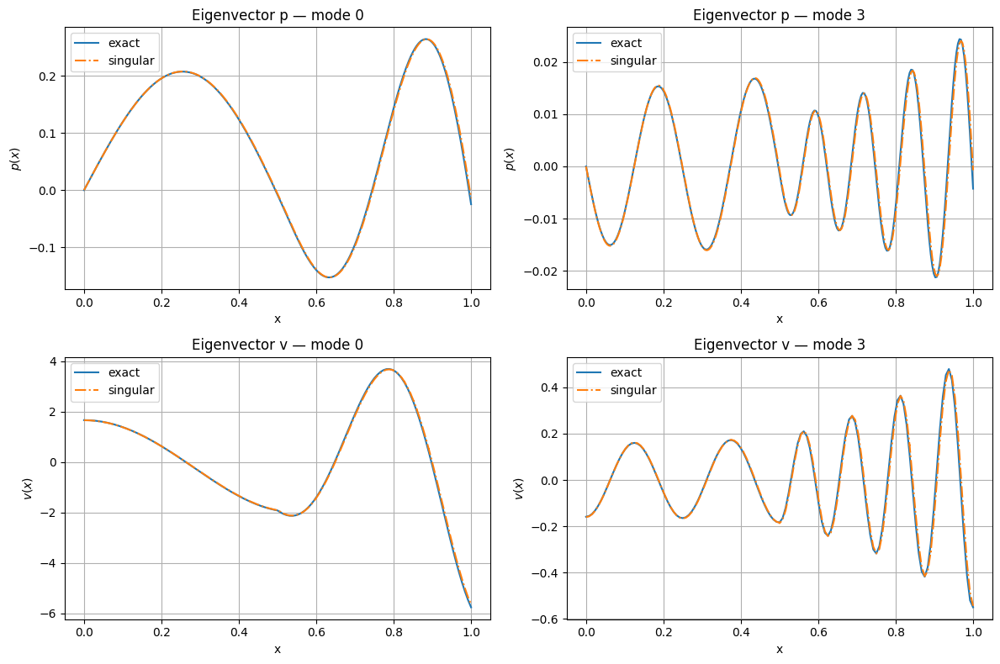

$[Closest] idx=0  \omega=(12.53555323003586-2.1894636584813263j)  \epsilon_r=(0.023044477800372595+0j)$
$[Closest] idx=28  \omega=(50.132115091181575-2.1565724594372906j)  \epsilon_r=(0.09099776151147543+0j)$


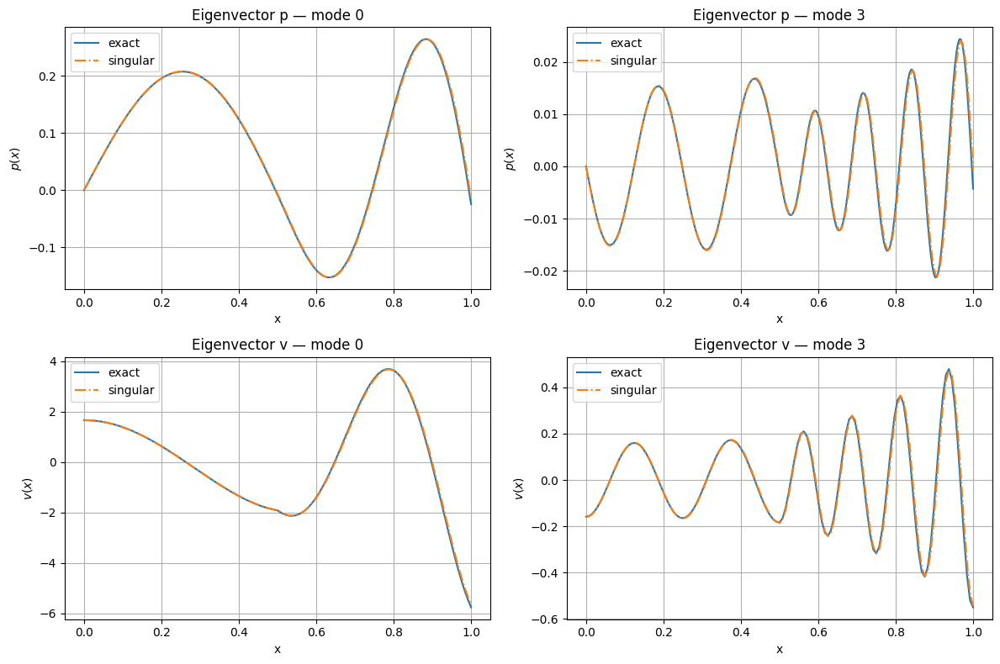

$[Closest] idx=0  \omega=(12.535553707874074-2.1894650647983998j)  \epsilon_r=(0.023044020835866357+0j)$
$[Closest] idx=28  \omega=(50.13208533209562-2.1565874356931j)  \epsilon_r=(0.09101132904219937+0j)$


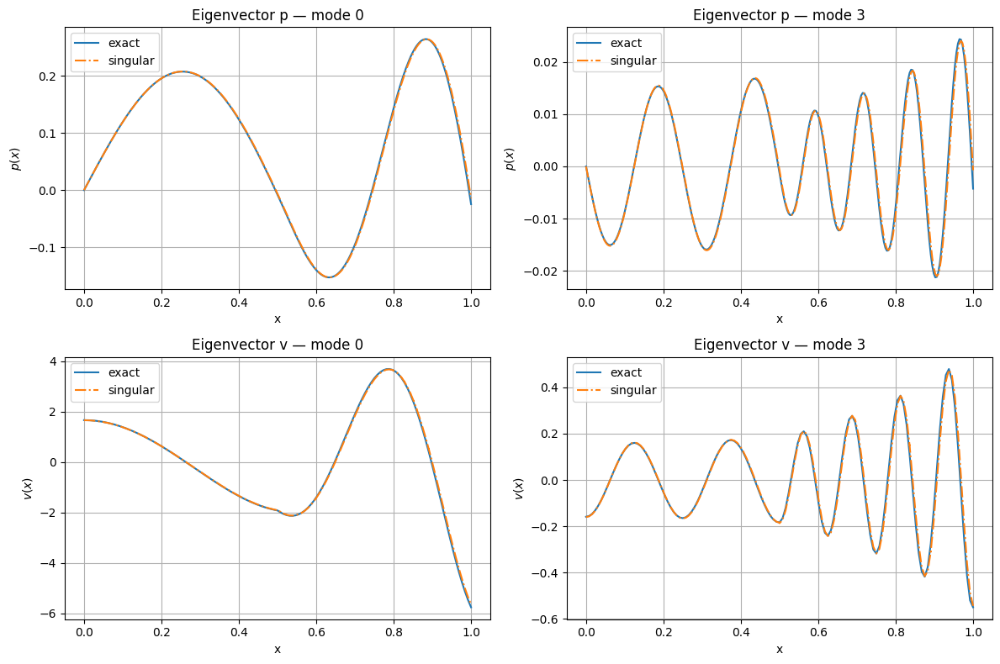

$[Closest] idx=0  \omega=(12.535554385798012-2.1894665277411725j)  \epsilon_r=(0.02304344183719073+0j)$
$[Closest] idx=28  \omega=(50.13205595320942-2.1566042171370667j)  \epsilon_r=(0.09102446996811195+0j)$


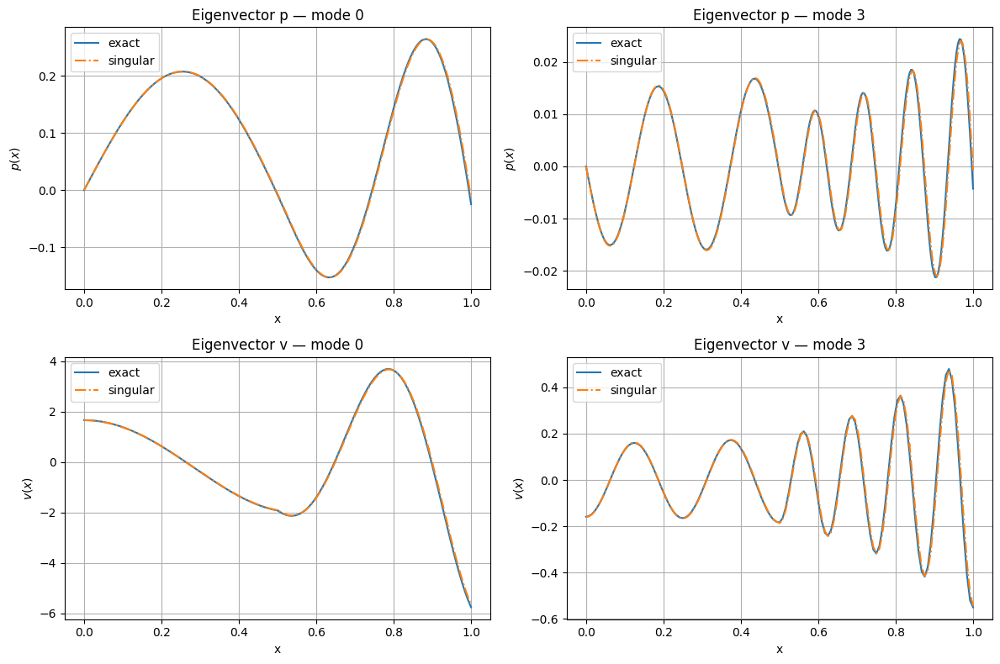

$[Closest] idx=0  \omega=(12.535555282520505-2.1894680336375485j)  \epsilon_r=(0.02304273185830666+0j)$
$[Closest] idx=28  \omega=(50.13202702522172-2.156622805141295j)  \epsilon_r=(0.0910371476940816+0j)$


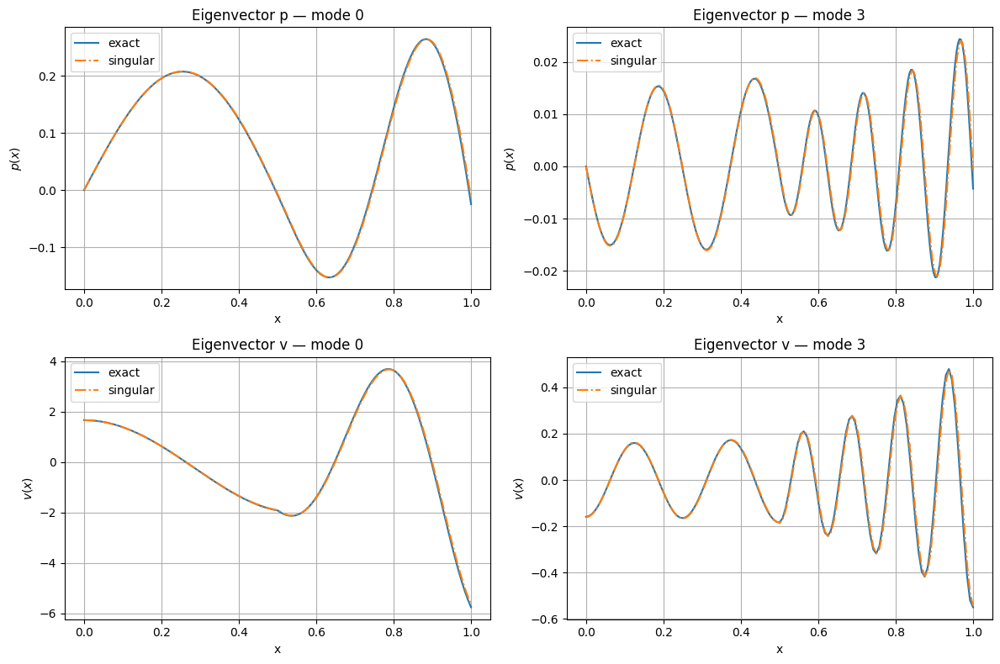

$[Closest] idx=0  \omega=(12.535556416483349-2.189469567487755j)  \epsilon_r=(0.0230418822800624+0j)$
$[Closest] idx=29  \omega=(50.13199861914142-2.1566431995895123j)  \epsilon_r=(0.09104932567552965+0j)$


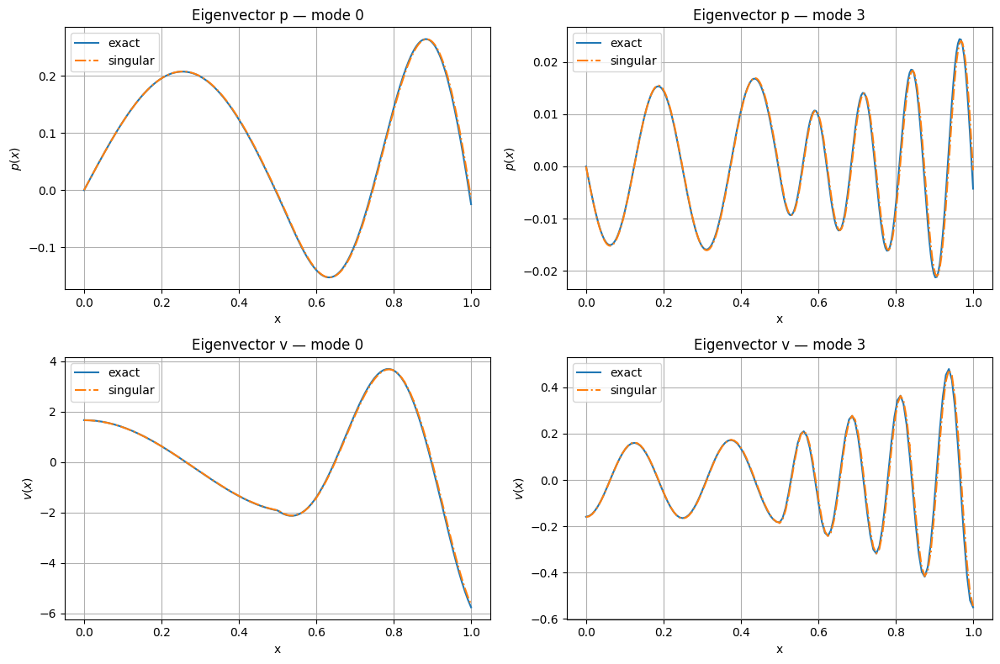

$[Closest] idx=0  \omega=(12.535557805979334-2.189471112938796j)  \epsilon_r=(0.023040884743492945+0j)$
$[Closest] idx=29  \omega=(50.13197080627608-2.156665398884597j)  \epsilon_r=(0.09106096742388195+0j)$


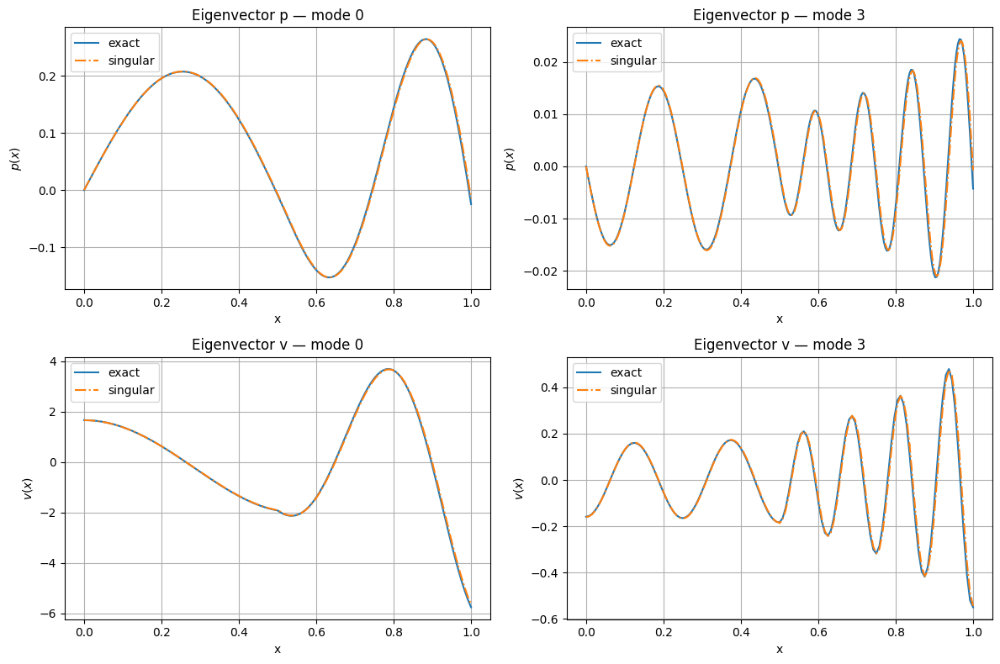

$[Closest] idx=0  \omega=(12.535559469222598-2.189472652276622j)  \epsilon_r=(0.023039731110538298+0j)$
$[Closest] idx=30  \omega=(50.13194365821119-2.1566893999461825j)  \epsilon_r=(0.09107203651513646+0j)$


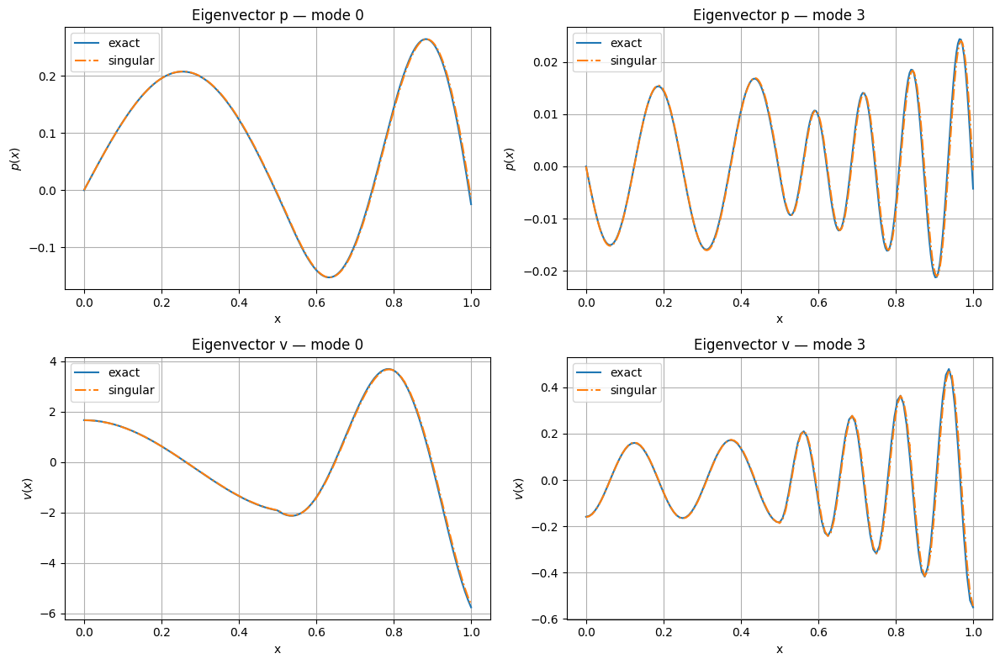

$[Closest] idx=0  \omega=(12.53556142438924-2.189474166429466j)  \epsilon_r=(0.023038413440397032+0j)$
$[Closest] idx=30  \omega=(50.13191724680316-2.156715198205416j)  \epsilon_r=(0.09108249659334686+0j)$


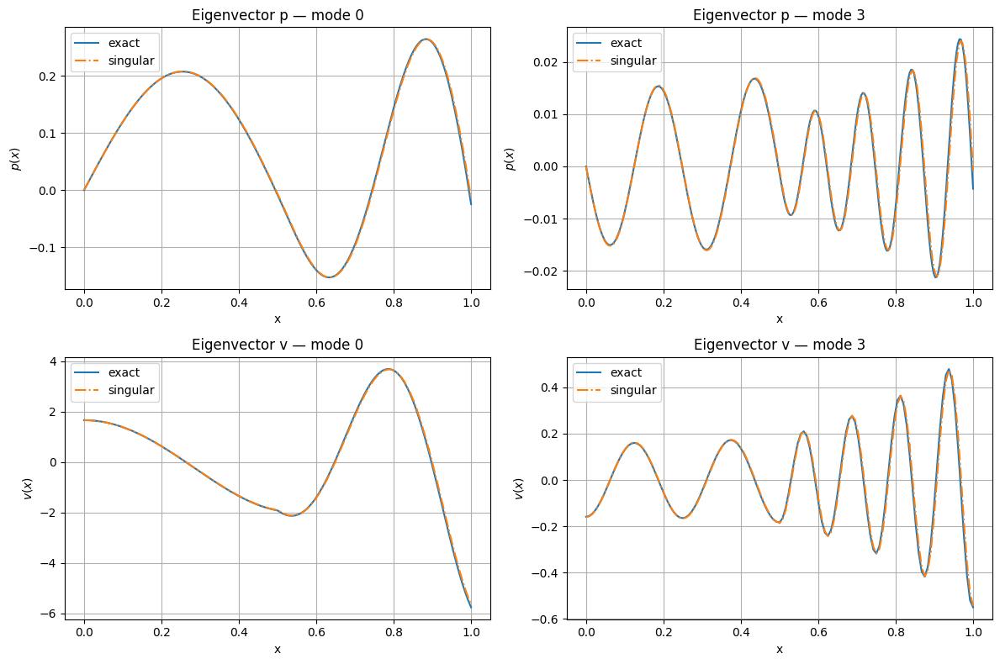

$[Closest] idx=0  \omega=(12.535563689642578-2.1894756349749573j)  \epsilon_r=(0.02303692397432123+0j)$
$[Closest] idx=30  \omega=(50.131891644170295-2.1567427876066896j)  \epsilon_r=(0.09109231137327486+0j)$


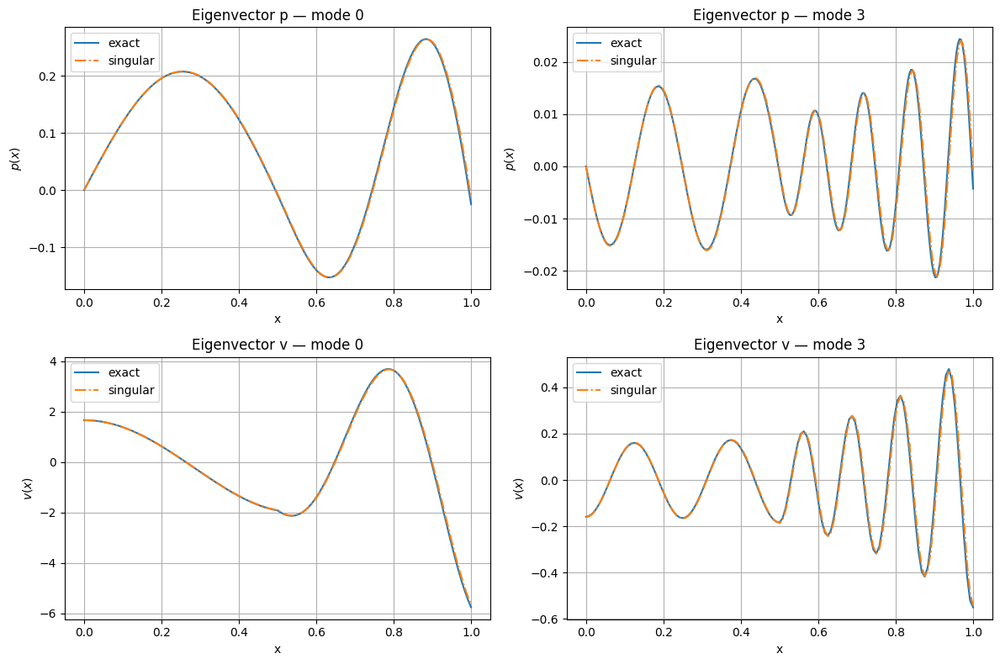

$[Closest] idx=0  \omega=(12.535566283144275-2.189477036147484j)  \epsilon_r=(0.02303525512855894+0j)$
$[Closest] idx=30  \omega=(50.131866922681965-2.156772160602536j)  \epsilon_r=(0.09110144464560717+0j)$


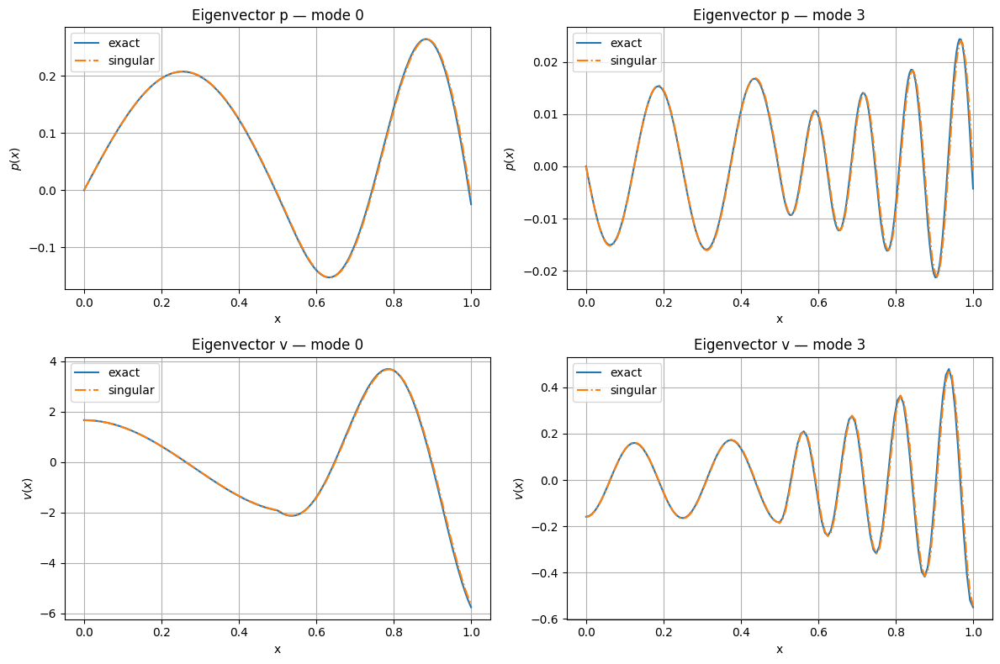

$[Closest] idx=0  \omega=(12.535569223065899-2.189478346844947j)  \epsilon_r=(0.023033399487295356+0j)$
$[Closest] idx=30  \omega=(50.13184315495129-2.1568033081549687j)  \epsilon_r=(0.09110986027811853+0j)$


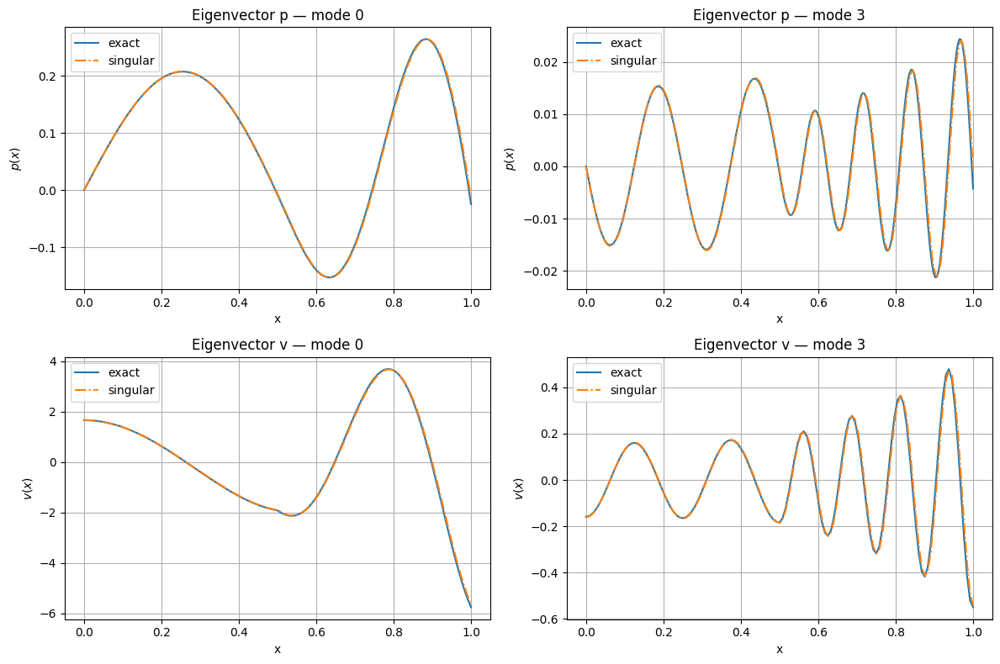

$[Closest] idx=0  \omega=(12.535572527589212-2.189479542635967j)  \epsilon_r=(0.02303134980210654+0j)$
$[Closest] idx=30  \omega=(50.131820413822545-2.1568362197340685j)  \epsilon_r=(0.09111752222127852+0j)$


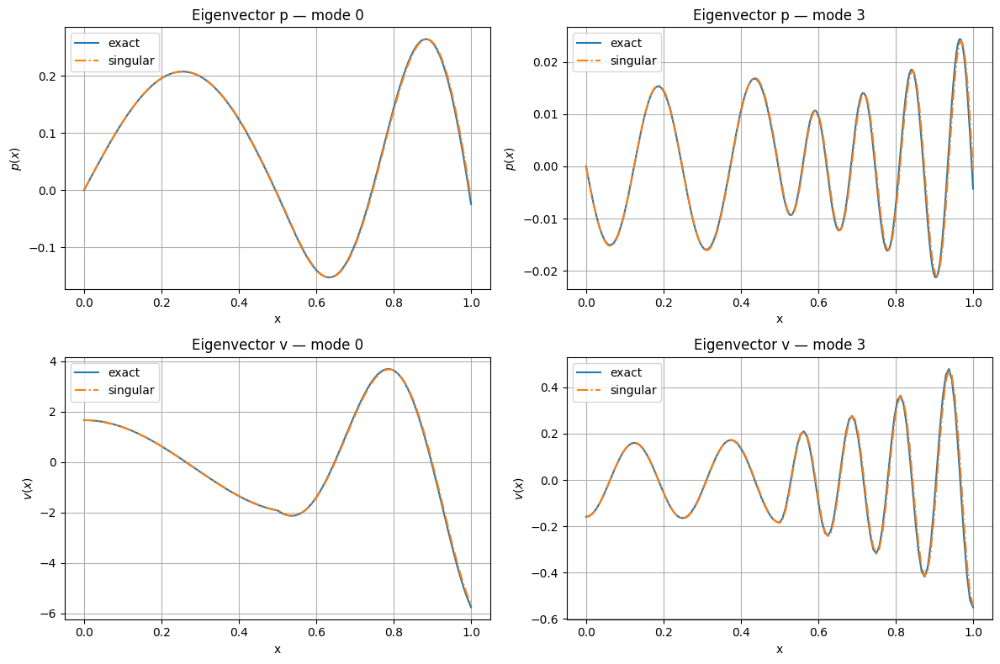

$[Closest] idx=0  \omega=(12.53557621491041-2.189480597766762j)  \epsilon_r=(0.023029098989398623+0j)$
$[Closest] idx=30  \omega=(50.131798772369216-2.156870883314807j)  \epsilon_r=(0.0911243945076935+0j)$


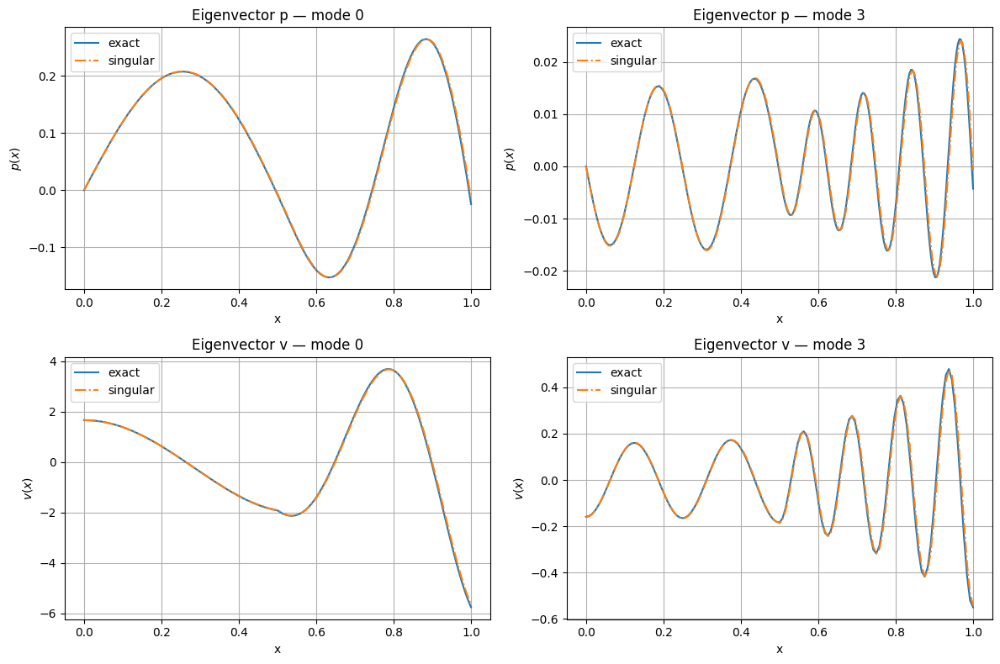

$[Closest] idx=0  \omega=(12.535580303238836-2.189481485166467j)  \epsilon_r=(0.02302664013137614+0j)$
$[Closest] idx=30  \omega=(50.131778303874995-2.1569072853796167j)  \epsilon_r=(0.09113044125948189+0j)$


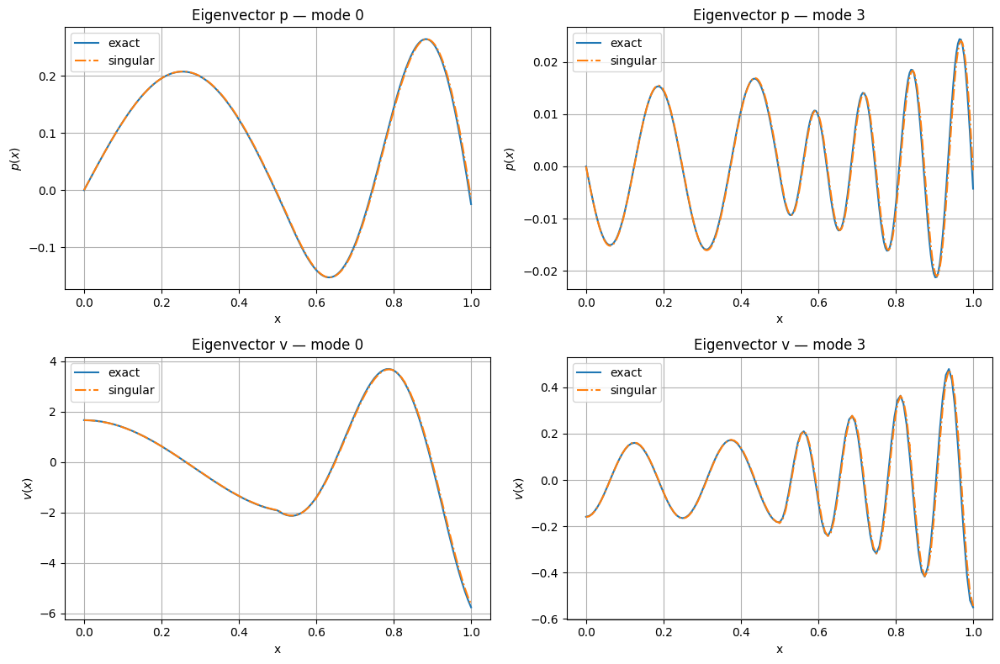

$[Closest] idx=0  \omega=(12.535584810796003-2.189482176454253j)  \epsilon_r=(0.02302396647681395+0j)$
$[Closest] idx=29  \omega=(50.13175908183244-2.156945410915408j)  \epsilon_r=(0.09113562668760304+0j)$


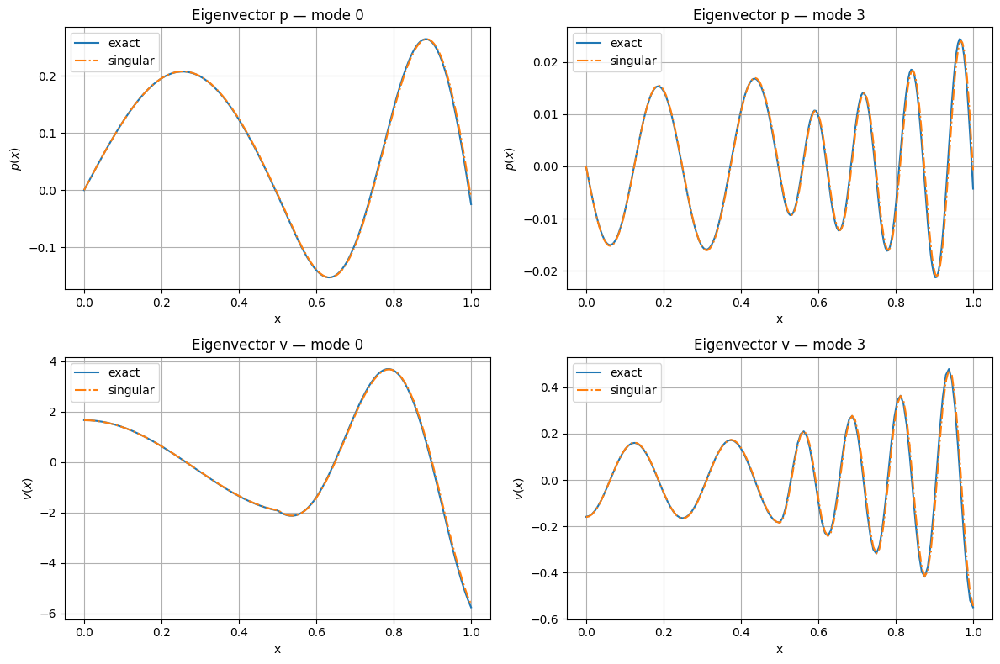

$[Closest] idx=0  \omega=(12.535589755813406-2.189482641944868j)  \epsilon_r=(0.023021071442975743+0j)$
$[Closest] idx=29  \omega=(50.131741179926486-2.1569852434132226j)  \epsilon_r=(0.09113991509834173+0j)$


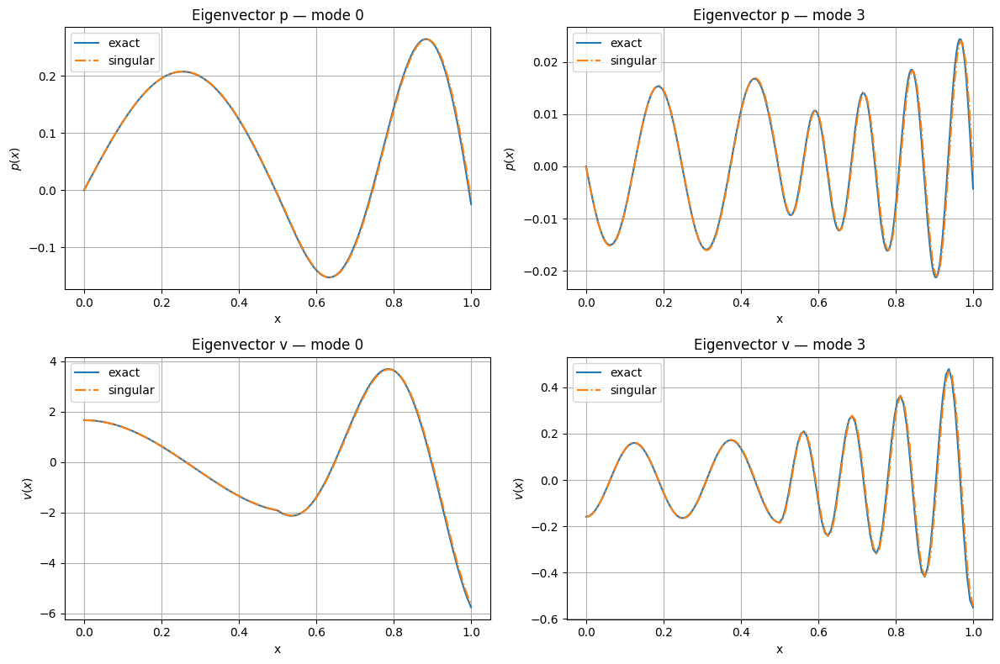

$[Closest] idx=0  \omega=(12.535595156530913-2.18948285065469j)  \epsilon_r=(0.023017948617362005+0j)$
$[Closest] idx=29  \omega=(50.13172467202893-2.1570267648684474j)  \epsilon_r=(0.09114327089397925+0j)$


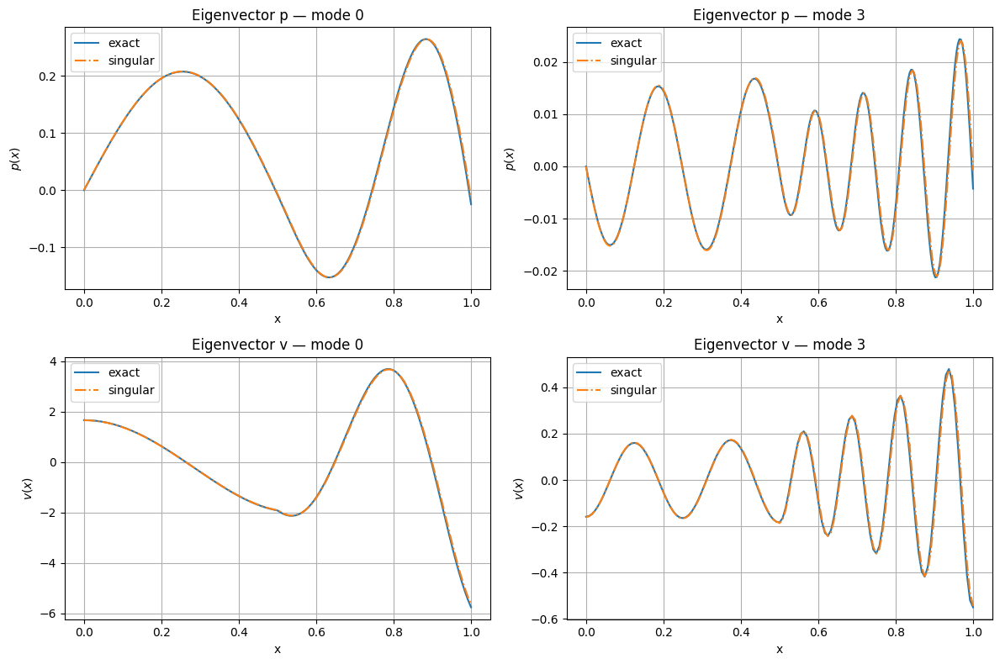

$[Closest] idx=0  \omega=(12.535601031192886-2.189482770306355j)  \epsilon_r=(0.023014591761243004+0j)$
$[Closest] idx=29  \omega=(50.13170963218801-2.157069955778436j)  \epsilon_r=(0.09114565857650497+0j)$


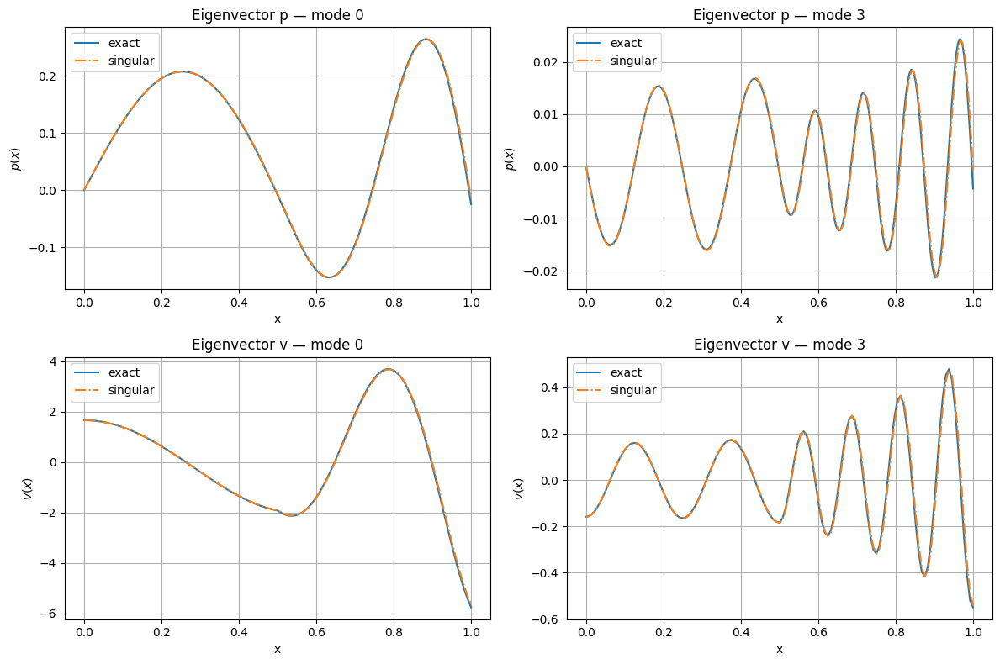

$[Closest] idx=0  \omega=(12.53560739804577-2.189482367336661j)  \epsilon_r=(0.023010994812214244+0j)$
$[Closest] idx=29  \omega=(50.13169613461711-2.1571147951447074j)  \epsilon_r=(0.09114704275107939+0j)$


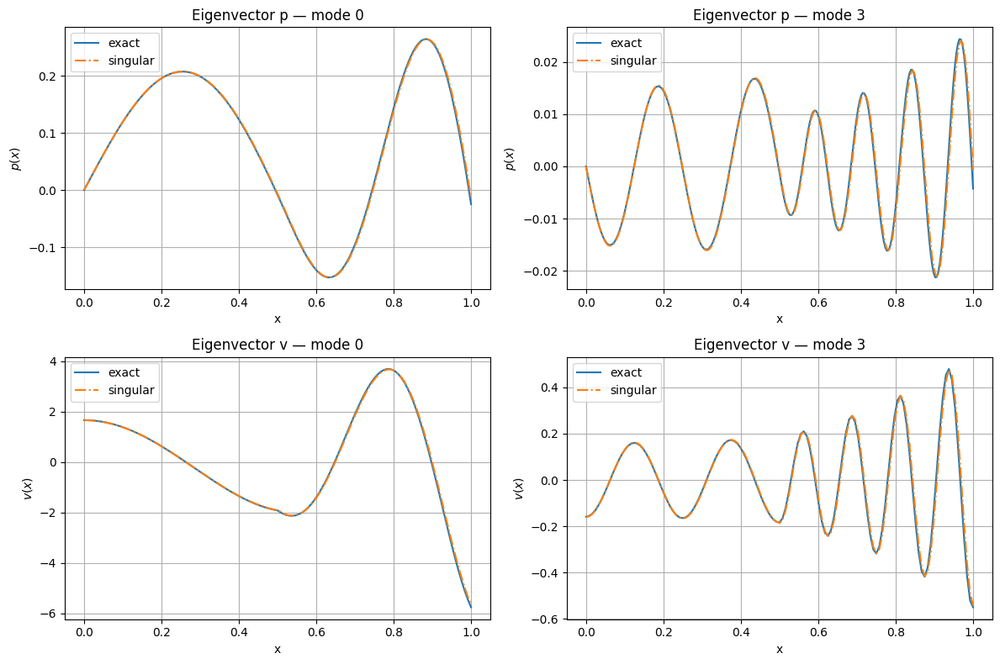

$[Closest] idx=0  \omega=(12.535614275334565-2.1894816069010323j)  \epsilon_r=(0.023007151888150147+0j)$
$[Closest] idx=29  \omega=(50.1316842536822-2.1571612604687274j)  \epsilon_r=(0.09114738813011225+0j)$


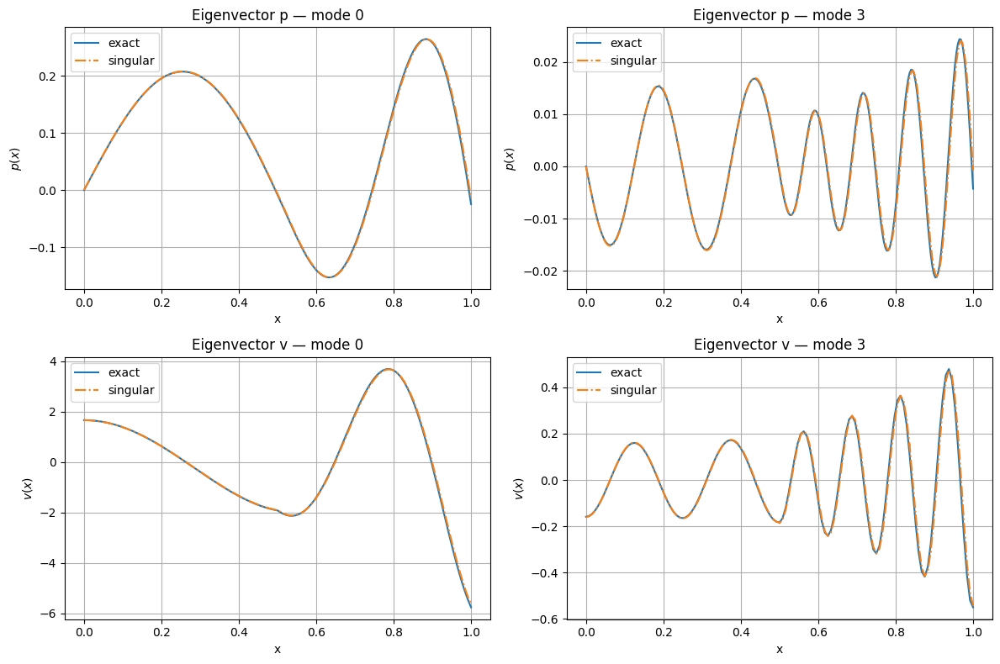

$[Closest] idx=0  \omega=(12.535621681299427-2.189480452880209j)  \epsilon_r=(0.023003057291180552+0j)$
$[Closest] idx=29  \omega=(50.13167406389544-2.157209327755515j)  \epsilon_r=(0.09114665953461197+0j)$


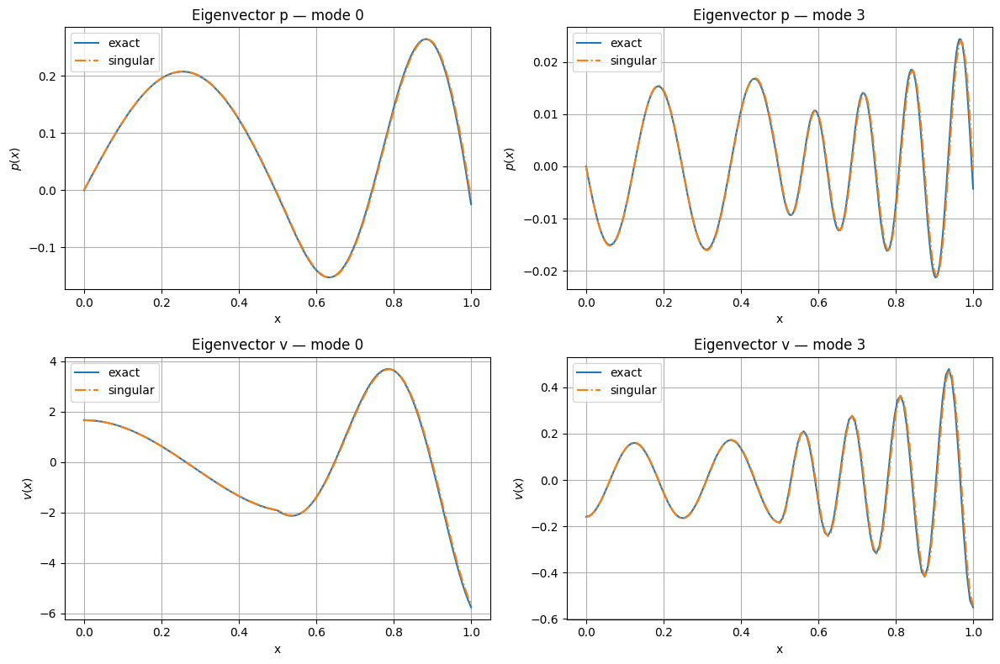

$[Closest] idx=0  \omega=(12.535629634171885-2.1894788678869017j)  \epsilon_r=(0.022998705512230162+0j)$
$[Closest] idx=29  \omega=(50.131665639902145-2.157258971510846j)  \epsilon_r=(0.09114482189872439+0j)$


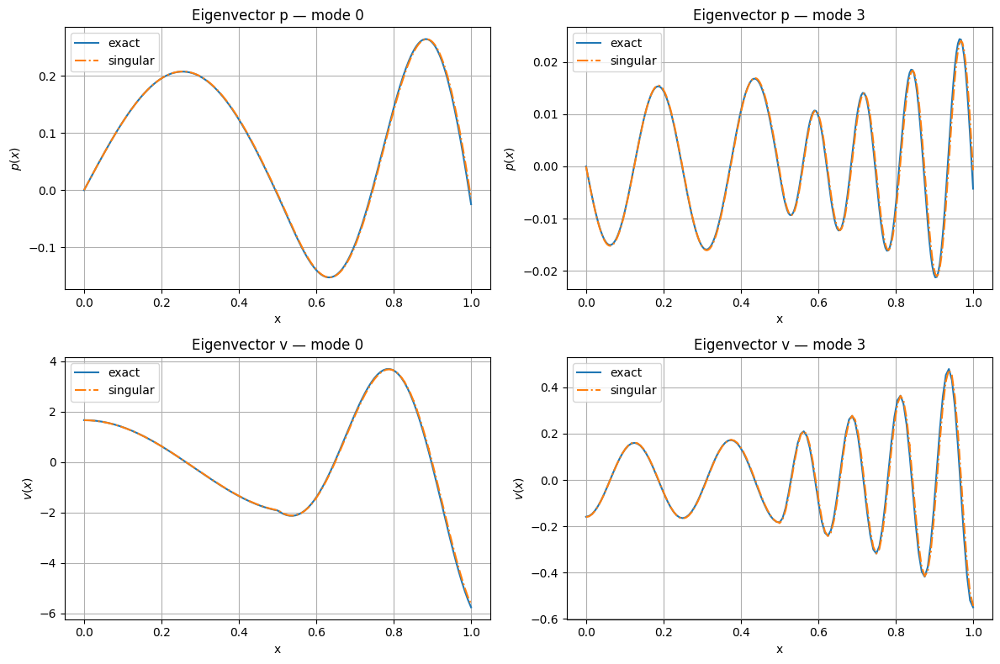

$[Closest] idx=0  \omega=(12.535638152171103-2.1894768132713938j)  \epsilon_r=(0.022994091236100238+0j)$
$[Closest] idx=29  \omega=(50.13165905647071-2.1573101647405344j)  \epsilon_r=(0.09114184027278005+0j)$


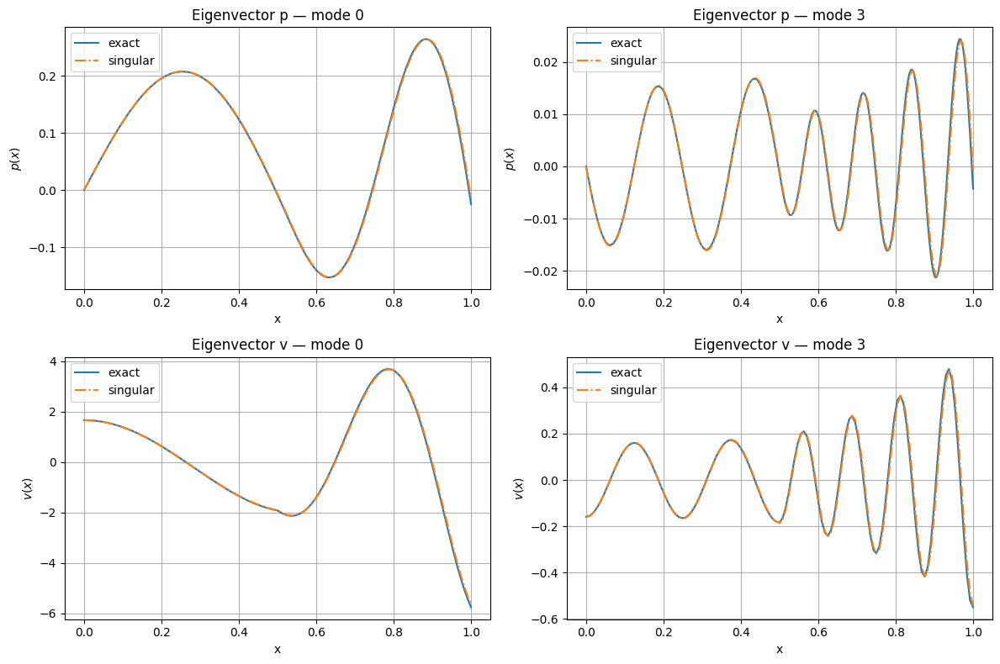

$[Closest] idx=0  \omega=(12.535647253500459-2.189474249128939j)  \epsilon_r=(0.022989209346554774+0j)$
$[Closest] idx=29  \omega=(50.131654388479234-2.157362878952671j)  \epsilon_r=(0.09113767982704729+0j)$


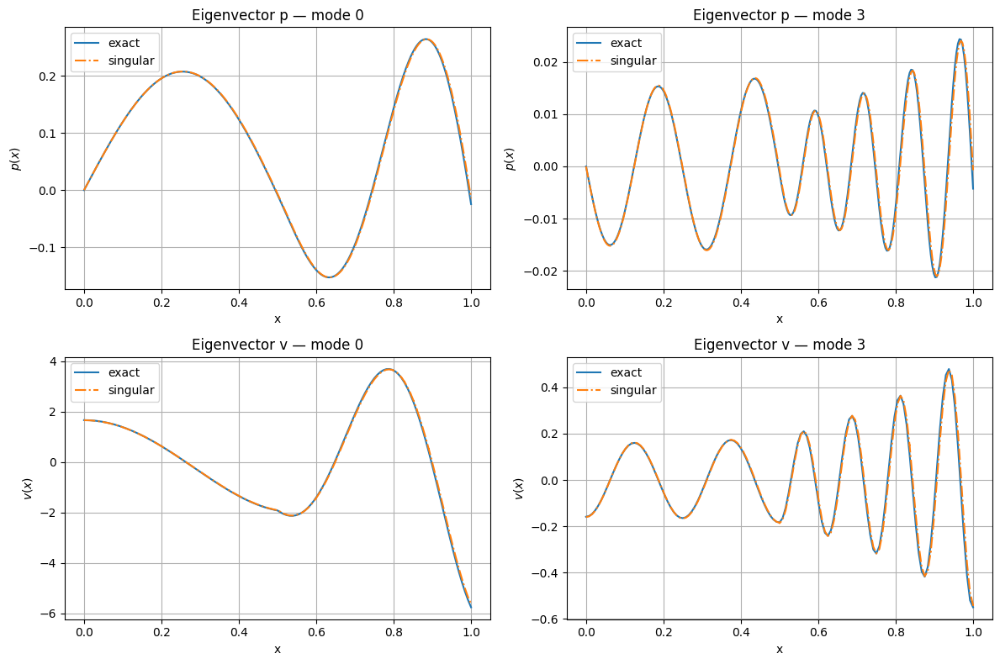

$[Closest] idx=0  \omega=(12.535656956342976-2.1894711343061717j)  \epsilon_r=(0.02298405493266371+0j)$
$[Closest] idx=29  \omega=(50.13165171090793-2.157417084154708j)  \epsilon_r=(0.09113230585455098+0j)$


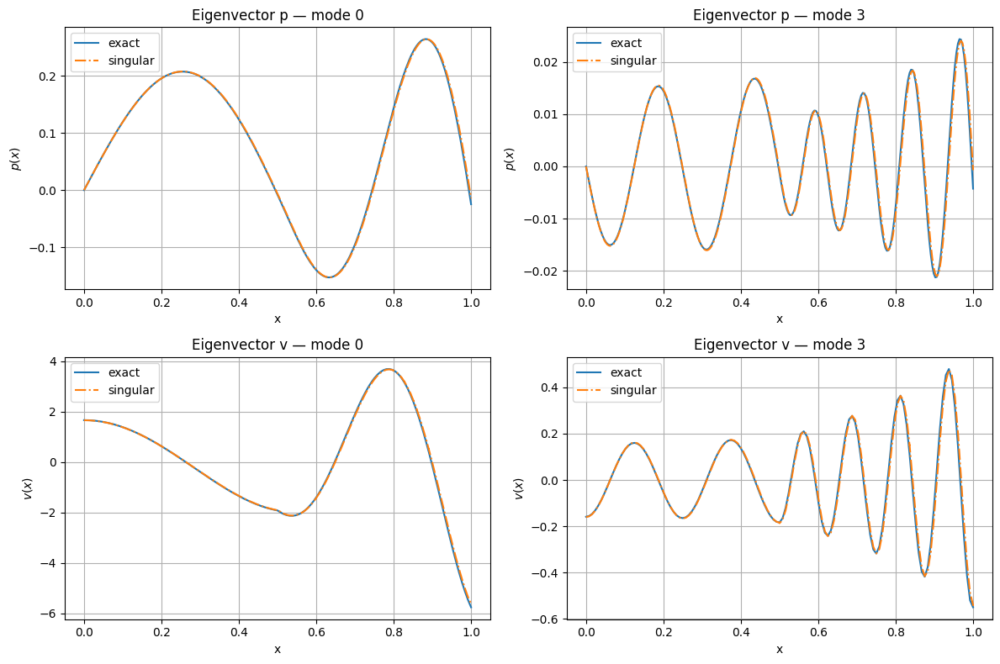

$[Closest] idx=0  \omega=(12.535667278857979-2.189467426408798j)  \epsilon_r=(0.022978623294741672+0j)$
$[Closest] idx=29  \omega=(50.13165109882526-2.1574727488551337j)  \epsilon_r=(0.09112568377483446+0j)$


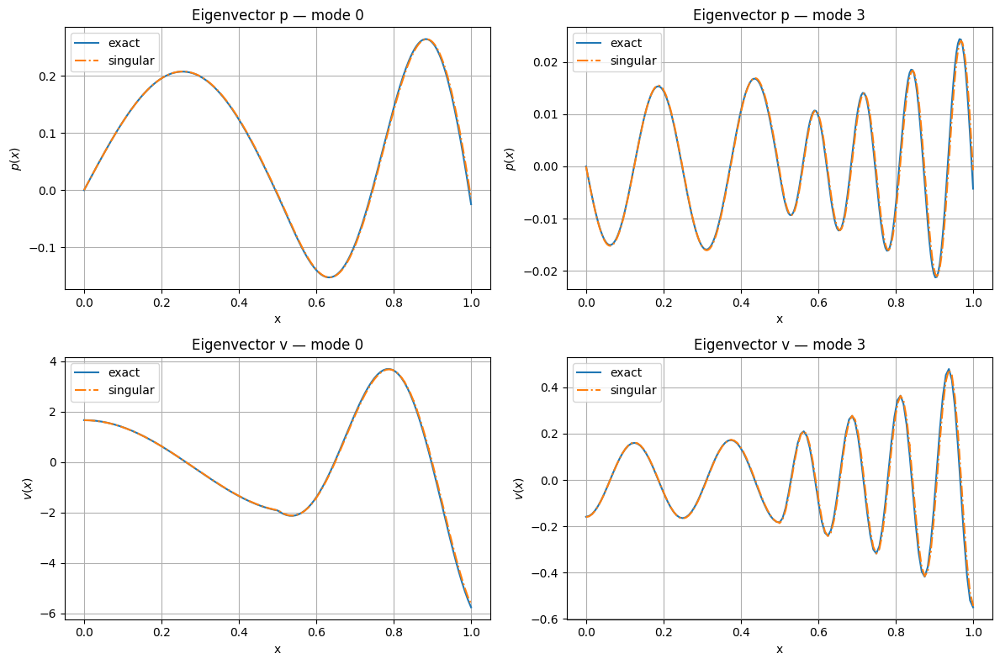

In [ ]:
# Diccionarios onde gardar os erros para cada refinamento N
rel_err_sigma_sweep = {0: {}, 3: {}}   # erros para modo 0 e 3
approx_omega  = {0: {}, 3: {}}
approx_p      = {0: {}, 3: {}}
approx_v      = {0: {}, 3: {}}

# Iterar sobre N = 0,1,2 → corresponde a h_i[0], h_i[1], h_i[2]
for N, h in enumerate(h_i):

    print(f"\n=== Executando para N = {N+2}, h = {h} ===")

    # Inicializar listas baleiras para este N
    rel_err_sigma_sweep[0][N] = []
    rel_err_sigma_sweep[3][N] = []

    approx_omega[0][N] = []
    approx_omega[3][N] = []

    approx_p[0][N] = []
    approx_p[3][N] = []

    approx_v[0][N] = []
    approx_v[3][N] = []

    # Crear nova malla para este refinamento
    mesh = create_interval(
        MPI.COMM_WORLD,
        int((Lx + pml_thickness) / h),
        [0, Lx + pml_thickness]
    )

    # Percorrer sigma_sweep_quadratic
    for i, sigma_i in enumerate(sigma_sweep_quadratic):

        sigma_quadratic_ufl =lambda x: conditional(x[0] > Lx, sigma_i*(x[0]-Lx)**2/(pml_thickness**2), 0.0)
        solver_quadratic, mesh, Q_, V_, dof_ = get_configured_problem(mesh, degree, sigma_quadratic_ufl)
        (eig0, p0, v0, err0, eig3, p3, v3, err3) = get_closest_approx_eigenpair(solver_quadratic, Q_, V_, dof_, sigma_i, mesh,verbose=True, plot=True)

        # Gardar resultados
        approx_omega[0][N].append(eig0)
        approx_omega[3][N].append(eig3)

        approx_p[0][N].append(p0)
        approx_p[3][N].append(p3)

        approx_v[0][N].append(v0)
        approx_v[3][N].append(v3)

        rel_err_sigma_sweep[0][N].append(err0)
        rel_err_sigma_sweep[3][N].append(err3)


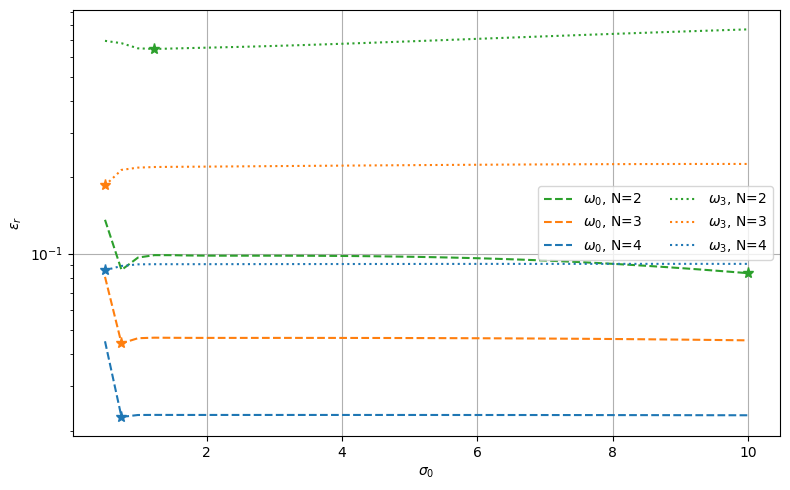

In [ ]:
import matplotlib.pyplot as plt

colors = ['tab:green', 'tab:orange', 'tab:blue']  
linestyles = {0: '--', 3: ':'}
labels = {0: r'$\omega_0$', 3: r'$\omega_3$'}

plt.figure(figsize=(8,5))

# ITERAR SOBRE OS INDICES REAIS: 0,1,2
for j in [0,3]:  # modos físicos
    for N_index in range(len(h_i)):   # N_index = 0,1,2
        plot_N = N_index + 2          # para etiquetas: 2,3,4
        col = colors[N_index]

        errs = rel_err_sigma_sweep[j][N_index]
        ls = linestyles[j]

        # curva
        plt.plot(
            sigma_sweep_quadratic,
            errs,
            color=col,
            linestyle=ls,
            label=f"{labels[j]}, N={plot_N}"
        )

        # mínimo
        k = np.argmin(errs)
        plt.plot(
            sigma_sweep_quadratic[k],
            errs[k],
            '*',
            color=col,
            markersize=8
        )

plt.xlabel(r'$\sigma_0$')
plt.ylabel(r'$\epsilon_r$')
plt.grid(True)
plt.yscale('log')
plt.legend(ncol=2)
plt.tight_layout()
plt.show()
